In [1]:
TrainingData_PATH = './training_data/'
TestData_PATH = './test_data/'
gesture1 = 'doubletap_'
gesture2 = 'fist_'
gesture3 = 'spread_'
gesture4 = 'static_'
gesture5 = 'wavein_'
gesture6 = 'waveout_'
txt_format = '.txt'

In [2]:
def rescaling_max_min(input_list):
    #https://www.zhihu.com/question/20467170
    max_value = max(input_list)
    min_value = min(input_list)
    rescaled_list = [(x-min_value)/(max_value-min_value) for x in input_list]
    return rescaled_list

In [3]:
def mean_normalization(input_list):
    #https://www.zhihu.com/question/20467170
    import numpy as np
    max_value = max(input_list)
    min_value = min(input_list)
    mean_value = np.mean(input_list)
    mean_normalized_list = [(x-mean_value)/(max_value-min_value) for x in input_list]
    return mean_normalized_list

In [4]:
def quantum_rescaling(input_list):
    #Quantum Mechanics Wavefunction
    import numpy as np
    squared_list = [x*x for x in input_list]
    squared_sum = np.sum(squared_list)
    quantum_rescaled_list = [x/squared_sum for x in input_list]
    return quantum_rescaled_list

In [5]:
def rescaled_2D(input_list):
    max_value = max(max(input_list))
    min_value = min(min(input_list))
    rescaled_list = [[(row_iter-min_value)/(max_value-min_value) for row_iter in column_iter] for column_iter in input_list]
    return rescaled_list

In [6]:
def MAV_cal(input_file):
    #Mean Absolute Value
    import math
    
    with open(input_file) as file_var:
        for line in file_var:
            channel_numbers =len(line.split())#actually 8 as already known
            break
    #print("Channel number:", channel_numbers)
    number_of_lines = 0
    
    with open(input_file) as file_var:
        for line in file_var:
            number_of_lines += 1
    #print("Line number:", number_of_lines)
    
    MAV_list = [0]*channel_numbers
    with open(input_file) as file_var:
        for line in file_var:
            line_iter = line.split()
            for channel_iter in range(channel_numbers):
                value_line_channel = line_iter[channel_iter]
                MAV_list[channel_iter] += math.fabs(float(value_line_channel))/number_of_lines
    
    return MAV_list

In [7]:
def RMS_cal(input_file):
    #Root Mean Square
    import math
    
    with open(input_file) as file_var:
        for line in file_var:
            channel_numbers =len(line.split())#actually 8 as already known
            break
    #print("Channel number:", channel_numbers)
    number_of_lines = 0
    
    with open(input_file) as file_var:
        for line in file_var:
            number_of_lines += 1
    #print("Line number:", number_of_lines)
    
    RMS_list = []
    square_sum = [0]*channel_numbers
    with open(input_file) as file_var:
        for line in file_var:
            line_iter = line.split()
            for channel_iter in range(channel_numbers):
                value_line_channel = line_iter[channel_iter]
                square_sum[channel_iter] += float(value_line_channel)**2
        
    for item in square_sum:
        RMS_list.append(math.sqrt(item/number_of_lines))
    
    return RMS_list

In [8]:
def ZC_cal(input_file):
    #Zero Crossings
    import math
    
    with open(input_file) as file_var:
        for line in file_var:
            channel_numbers =len(line.split())#actually 8 as already known
            break
    #print("Channel number:", channel_numbers)
    number_of_lines = 0
    
    with open(input_file) as file_var:
        for line in file_var:
            number_of_lines += 1
    #print("Line number:", number_of_lines)
    
    ZC_list = [0]*channel_numbers
    value_previous_line = [0]*channel_numbers
    
    with open(input_file) as file_var:
        
        first_line = file_var.readline().split()
        for channel_iter in range(channel_numbers):
            value_previous_line[channel_iter] = float(first_line[channel_iter])
        
        for line in file_var:
            line_iter = line.split()
            for channel_iter in range(channel_numbers):
                value_line_channel = line_iter[channel_iter]
                value_line_channel = float(value_line_channel)
                times_tmp = -value_line_channel*value_previous_line[channel_iter]
                if times_tmp>0:
                    ZC_list[channel_iter] += 1
                value_previous_line[channel_iter] = value_line_channel
                
    return ZC_list

In [9]:
def SSC_cal(input_file):
    #Slope Sign Changes
    import math
    
    with open(input_file) as file_var:
        for line in file_var:
            channel_numbers =len(line.split())#actually 8 as already known
            break
    #print("Channel number:", channel_numbers)
    number_of_lines = 0
    
    with open(input_file) as file_var:
        for line in file_var:
            number_of_lines += 1
    #print("Line number:", number_of_lines)
    
    SSC_list = [0]*channel_numbers
    value_previous_previous_line = [0]*channel_numbers
    value_previous_line = [0]*channel_numbers
    
    with open(input_file) as file_var:
        
        first_line = file_var.readline().split()
        second_line = file_var.readline().split()
        for channel_iter in range(channel_numbers):
            value_previous_previous_line[channel_iter] = float(first_line[channel_iter])
            value_previous_line[channel_iter] = float(second_line[channel_iter])
        
        for line in file_var:
            line_iter = line.split()
            for channel_iter in range(channel_numbers):
                value_line_channel = line_iter[channel_iter]
                value_line_channel = float(value_line_channel)
                slope_times_tmp = (value_previous_line[channel_iter]-value_previous_previous_line[channel_iter])*(value_previous_line[channel_iter]-value_line_channel)
                if slope_times_tmp>0:
                    SSC_list[channel_iter] += 1
                value_previous_previous_line[channel_iter] = value_previous_line[channel_iter]
                value_previous_line[channel_iter] = value_line_channel
                
    return SSC_list

In [10]:
def WL_cal(input_file):
    #Waveform Length
    import math
    
    with open(input_file) as file_var:
        for line in file_var:
            channel_numbers =len(line.split())#actually 8 as already known
            break
    #print("Channel number:", channel_numbers)
    number_of_lines = 0
    
    with open(input_file) as file_var:
        for line in file_var:
            number_of_lines += 1
    #print("Line number:", number_of_lines)
    
    WL_list = [0]*channel_numbers
    value_previous_line = [0]*channel_numbers
    
    with open(input_file) as file_var:
        
        first_line = file_var.readline().split()
        for channel_iter in range(channel_numbers):
            value_previous_line[channel_iter] =float(first_line[channel_iter])
        
        for line in file_var:
            line_iter = line.split()
            for channel_iter in range(channel_numbers):
                value_line_channel = line_iter[channel_iter]
                value_line_channel = float(value_line_channel)
                WL_list[channel_iter] += math.fabs(value_line_channel-value_previous_line[channel_iter])
                value_previous_line[channel_iter] = value_line_channel
    
    return WL_list

In [11]:
def WA_cal(epsilon_var, input_file):
    #Willison Amplitude
    #epsilon_var set as 2.5 originally
    import math
    
    with open(input_file) as file_var:
        for line in file_var:
            channel_numbers =len(line.split())#actually 8 as already known
            break
    #print("Channel number:", channel_numbers)
    number_of_lines = 0
    
    with open(input_file) as file_var:
        for line in file_var:
            number_of_lines += 1
    #print("Line number:", number_of_lines)
    
    WA_list = [0]*channel_numbers
    value_previous_line = [0]*channel_numbers
    
    with open(input_file) as file_var:
        
        first_line = file_var.readline().split()
        for channel_iter in range(channel_numbers):
            value_previous_line[channel_iter] =float(first_line[channel_iter])
        
        for line in file_var:
            line_iter = line.split()
            for channel_iter in range(channel_numbers):
                value_line_channel = line_iter[channel_iter]
                value_line_channel = float(value_line_channel)
                fabs_tmp = math.fabs(value_line_channel-value_previous_line[channel_iter])
                if fabs_tmp>epsilon_var:
                    WA_list[channel_iter] += 1
                value_previous_line[channel_iter] = value_line_channel
    
    return WA_list

In [12]:
def VAR_cal(input_file):
    #Variance
    import math
    
    with open(input_file) as file_var:
        for line in file_var:
            channel_numbers =len(line.split())#actually 8 as already known
            break
    #print("Channel number:", channel_numbers)
    number_of_lines = 0
    
    with open(input_file) as file_var:
        for line in file_var:
            number_of_lines += 1
    #print("Line number:", number_of_lines)
    
    VAR_list = []
    square_sum = [0]*channel_numbers
    with open(input_file) as file_var:
        for line in file_var:
            line_iter = line.split()
            for channel_iter in range(channel_numbers):
                value_line_channel = line_iter[channel_iter]
                square_sum[channel_iter] += float(value_line_channel)**2
        
    for item in square_sum:
        VAR_list.append(item/(number_of_lines-1))
    
    return VAR_list

In [13]:
def LogD_cal(input_file):
    #Log Detector
    resolution_size = 0.01
    import math
    
    with open(input_file) as file_var:
        for line in file_var:
            channel_numbers =len(line.split())#actually 8 as already known
            break
    #print("Channel number:", channel_numbers)
    number_of_lines = 0
    
    with open(input_file) as file_var:
        for line in file_var:
            number_of_lines += 1
    #print("Line number:", number_of_lines)
    
    LogD_list = [0]*channel_numbers
    with open(input_file) as file_var:
        for line in file_var:
            line_iter = line.split()
            for channel_iter in range(channel_numbers):
                value_line_channel = line_iter[channel_iter]
                fabs_tmp = math.fabs(float(value_line_channel))
                if fabs_tmp < resolution_size:
                    fabs_tmp = resolution_size
                LogD_list[channel_iter] += math.log(fabs_tmp)/number_of_lines
                
    LogD_list = [math.exp(x) for x in LogD_list]
    
    return LogD_list

In [14]:
def ARC_cal(input_file):
    #Auto Regression Coefficient
    #https://machinelearningmastery.com/autoregression-models-time-series-forecasting-python/
    import pandas as pd
    from pandas import Series
    from matplotlib import pyplot
    from statsmodels.tsa.ar_model import AR #conda install statsmodels
    from sklearn.metrics import mean_squared_error #pip install -U scikit-learn scipy matplotlib #conda installe scikit-learn
    import numpy as np
    
    with open(input_file) as file_var:
        for line in file_var:
            channel_numbers =len(line.split())#actually 8 as already known
            break
    #print("Channel number:", channel_numbers)
    '''
    number_of_lines = 0    
    
    with open(input_file) as file_var:
        for line in file_var:
            number_of_lines += 1
    #print("Line number:", number_of_lines)
    '''
    
    ARC_list = []
    ARC_list_LagNumber = []
    
    '''
    for column_n in range(channel_numbers):
        ARC_list.append([])
    '''
    
    input_series = pd.read_csv(input_file, header=None)
    input_tmp_file = input_series.values
    number_of_lines = len(input_tmp_file)
    input_file_array = [ [ float(ele) for ele in input_tmp_file[line_n][0].split() ] for line_n in range(number_of_lines)]
    input_file_array = np.array(input_file_array)
    for column_n in range(channel_numbers):
        model_fit = AR(input_file_array[:,column_n]).fit()
        ARC_list_LagNumber.append(model_fit.k_ar)
        ARC_list.append(model_fit.params.tolist())

    return ARC_list_LagNumber, ARC_list

In [15]:
def ARC_results_plot(Input_LagList, Input_ARC_list, gesture_name, i_label):
    
    from mpl_toolkits.mplot3d import Axes3D  
    import matplotlib.pyplot as plt
    from matplotlib import cm
    from matplotlib.ticker import LinearLocator, FormatStrFormatter
    import numpy as np
    
    X_data = np.arange(min(Input_LagList)+1)
    Y_data = np.arange(len(Input_ARC_list))
    X_data, Y_data = np.meshgrid(X_data, Y_data)
    Z_data = np.array(Input_ARC_list)
    
    fig = plt.figure()
    ax = fig.gca(projection='3d')

    # Plot the surface.
    surf = ax.plot_surface(X_data, Y_data, Z_data, cmap=cm.coolwarm,
                       linewidth=0, antialiased=False)

    # Customize the z axis.
    ax.set_zlim(-1.01, 1.01)
    ax.zaxis.set_major_locator(LinearLocator(10))
    ax.zaxis.set_major_formatter(FormatStrFormatter('%.02f'))

    # Add a color bar which maps values to colors.
    fig.colorbar(surf, shrink=0.5, aspect=5)
    
    plt.title(gesture_name+"ARC"+i_label)
    plt.show()
    return fig

In [16]:
def Ceps_cal(input_file):
    #Cepstrum coefficients
    LagList,ARC_List = ARC_cal(input_file)
    CepsList = []
    for channel_iter in range(len(ARC_List)):
        CepsList.append([-ARC_List[channel_iter][0]])
        
    for channel_iter in range(len(ARC_List)):
        item_size = LagList[channel_iter]+1
        for lag_iter in range(1, item_size):
            c_tmp = -ARC_List[channel_iter][lag_iter]
            for j_iter in range(0,lag_iter):
                c_tmp -= (lag_iter-j_iter)/(lag_iter+1)*CepsList[channel_iter][j_iter]*ARC_List[channel_iter][lag_iter-j_iter-1]
            CepsList[channel_iter].append(c_tmp)
    
    return CepsList

In [17]:
def Ceps_results_plot(Input_CepsList, gesture_name, i_label):
    
    from mpl_toolkits.mplot3d import Axes3D  
    import matplotlib.pyplot as plt
    from matplotlib import cm
    from matplotlib.ticker import LinearLocator, FormatStrFormatter
    import numpy as np
    
    X_data = np.arange(len(Input_CepsList[0]))
    Y_data = np.arange(len(Input_CepsList))
    X_data, Y_data = np.meshgrid(X_data, Y_data)
    Z_data = np.array(Input_CepsList)
    
    fig = plt.figure()
    ax = fig.gca(projection='3d')

    # Plot the surface.
    surf = ax.plot_surface(X_data, Y_data, Z_data, cmap=cm.coolwarm,
                       linewidth=0, antialiased=False)

    # Customize the z axis.
    #ax.set_zlim(-1.01, 1.01)
    ax.zaxis.set_major_locator(LinearLocator(10))
    ax.zaxis.set_major_formatter(FormatStrFormatter('%.02f'))

    # Add a color bar which maps values to colors.
    fig.colorbar(surf, shrink=0.5, aspect=5)
    
    plt.title(gesture_name+"Ceps"+i_label)
    plt.show()
    return fig

In [18]:
def fMD_cal(input_file):
    #Median frequency
    return 0

In [19]:
def fME_cal(input_file):
    #Mean frequency
    return 0

In [20]:
def emgHist(input_file):
    #sEMG Histogram
    return 0

In [21]:
def list_plot_mean_normalized(input_list, label_name, fig, ax):
    #https://matplotlib.org/3.1.0/gallery/lines_bars_and_markers/simple_plot.html#sphx-glr-gallery-lines-bars-and-markers-simple-plot-py
    import matplotlib
    import matplotlib.pyplot as plt
    import numpy as np
    x_channel = np.arange(len(input_list))
    y_signal_feature = mean_normalization(input_list)
    ax.plot(x_channel, y_signal_feature, label=label_name)
    ax.legend()
    
    return fig

In [22]:
def list_plot_rescaled_max_min(input_list, label_name, fig, ax):
    #https://matplotlib.org/3.1.0/gallery/lines_bars_and_markers/simple_plot.html#sphx-glr-gallery-lines-bars-and-markers-simple-plot-py
    import matplotlib
    import matplotlib.pyplot as plt
    import numpy as np
    x_channel = np.arange(len(input_list))
    y_signal_feature = rescaling_max_min(input_list)
    ax.plot(x_channel, y_signal_feature, label=label_name)
    ax.legend()
    
    return fig

doubletap_1 Row: 8, Column: 8


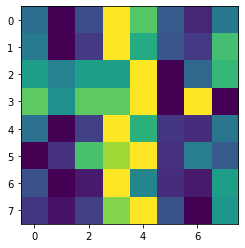

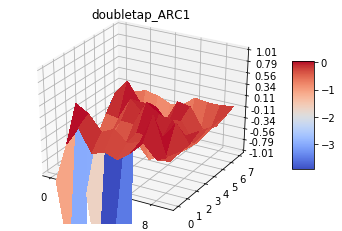

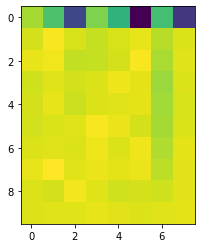

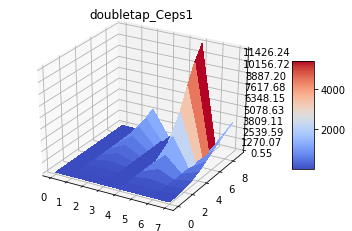

doubletap_2 Row: 8, Column: 8


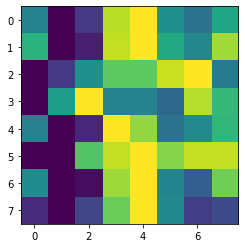

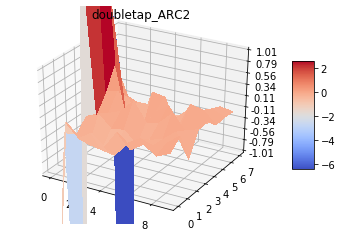

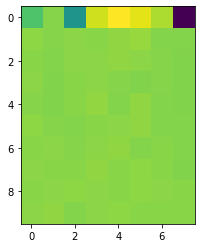

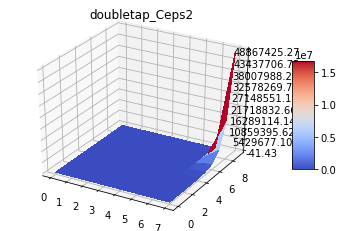

doubletap_3 Row: 8, Column: 8


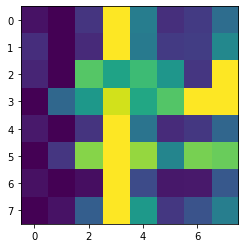

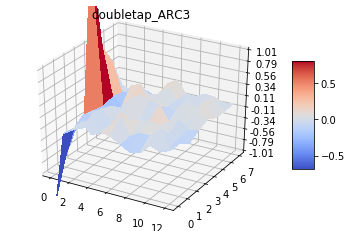

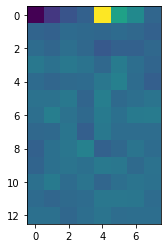

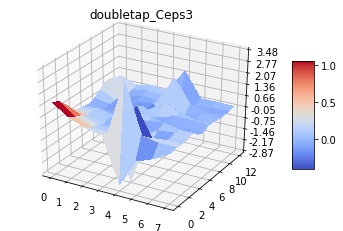

doubletap_4 Row: 8, Column: 8


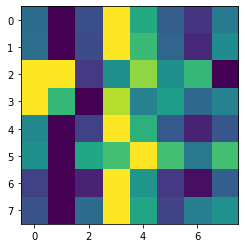

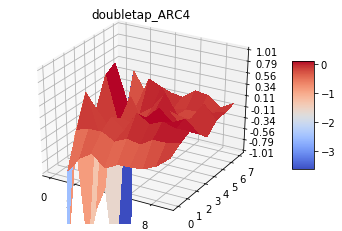

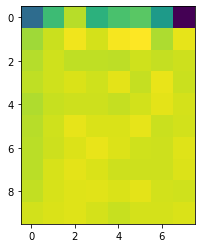

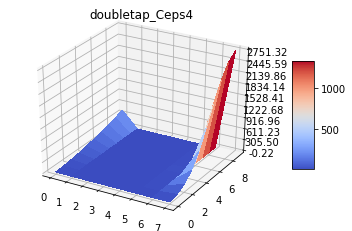

doubletap_5 Row: 8, Column: 8


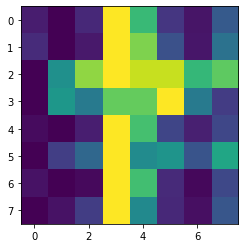

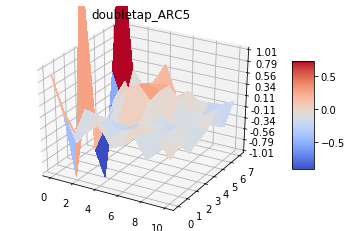

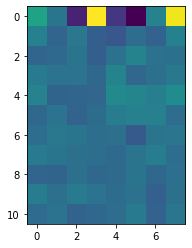

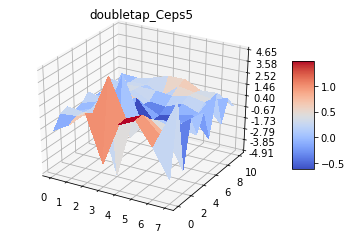

doubletap_6 Row: 8, Column: 8


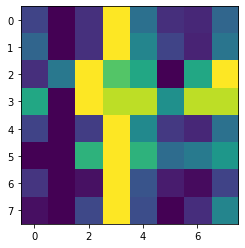

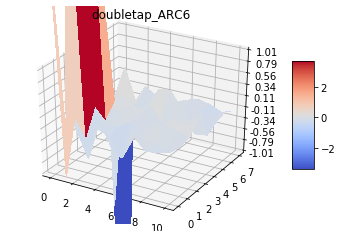

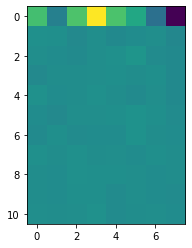

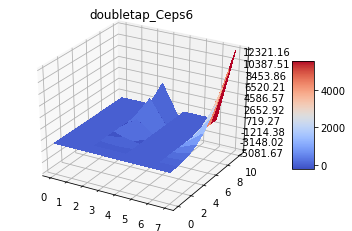

doubletap_7 Row: 8, Column: 8


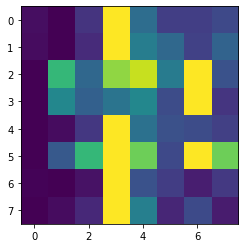

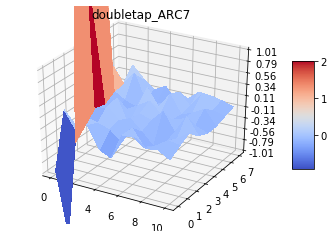

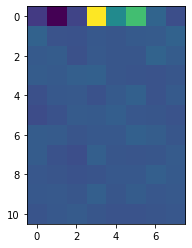

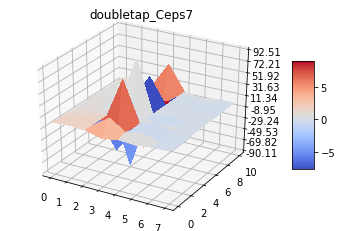

doubletap_8 Row: 8, Column: 8


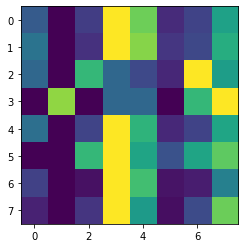

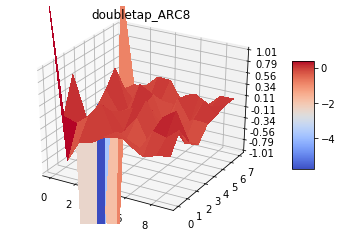

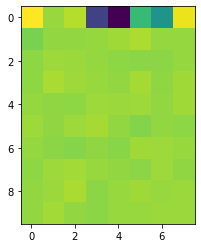

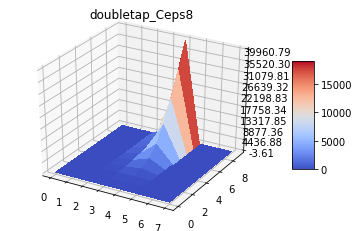

doubletap_9 Row: 8, Column: 8


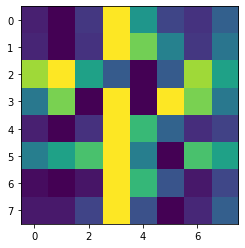

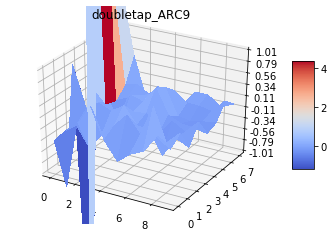

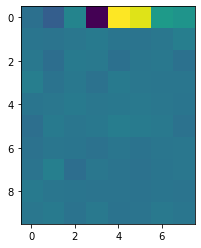

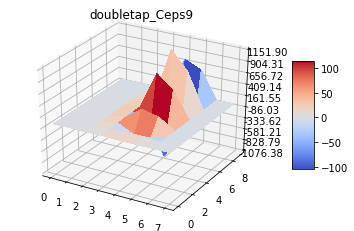

doubletap_10 Row: 8, Column: 8


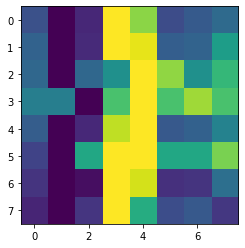

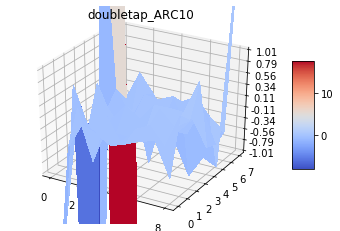

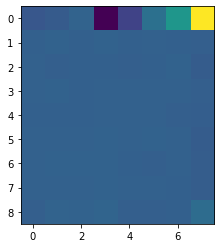

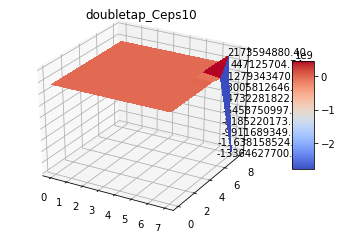

doubletap_11 Row: 8, Column: 8


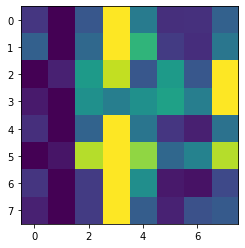

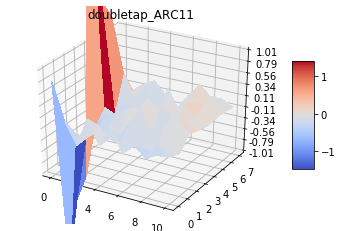

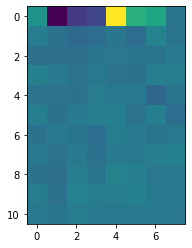

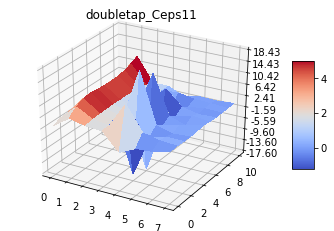

doubletap_12 Row: 8, Column: 8


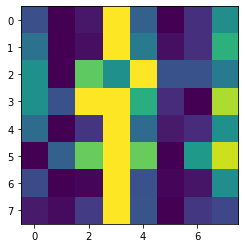

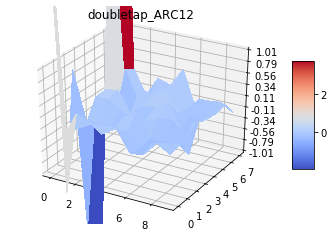

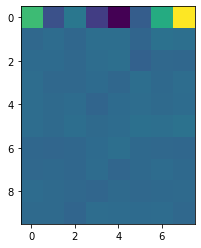

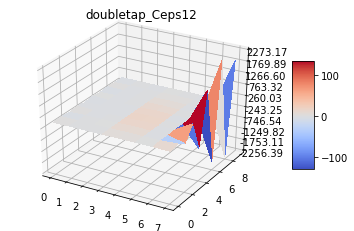

doubletap_13 Row: 8, Column: 8


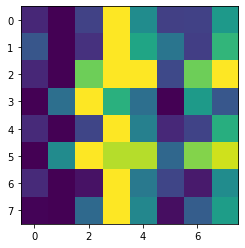

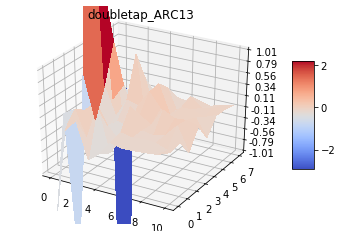

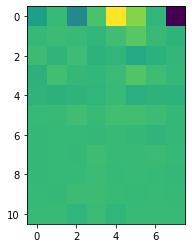

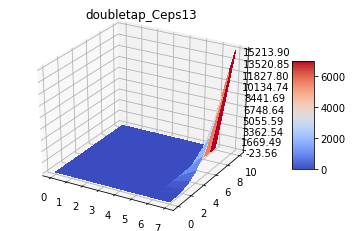

doubletap_14 Row: 8, Column: 8


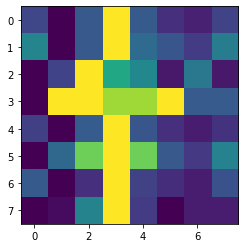

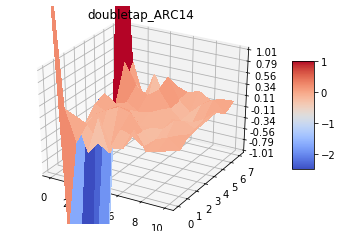

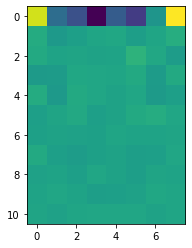

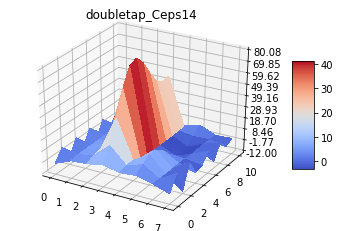

doubletap_15 Row: 8, Column: 8


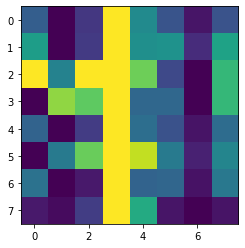

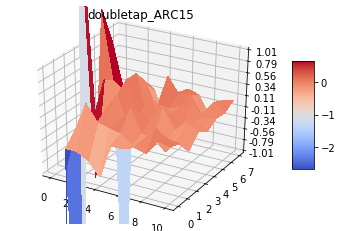

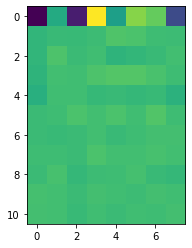

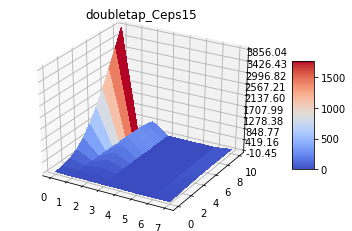

doubletap_16 Row: 8, Column: 8


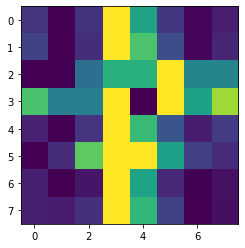

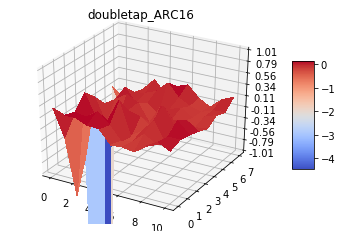

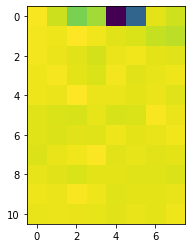

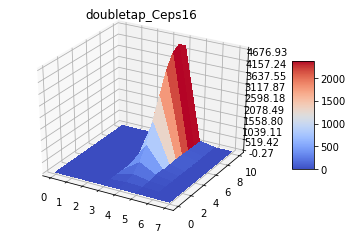

doubletap_17 Row: 8, Column: 8


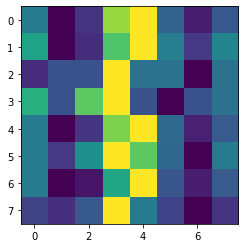

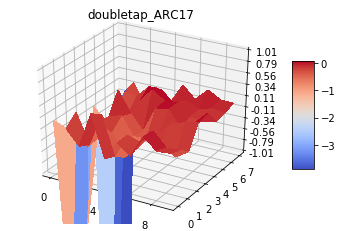

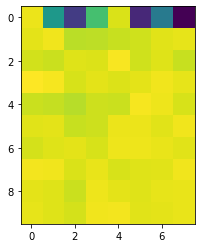

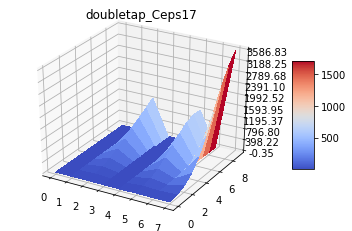

doubletap_18 Row: 8, Column: 8


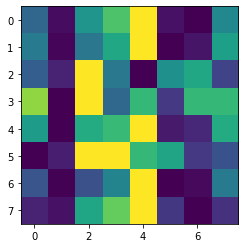

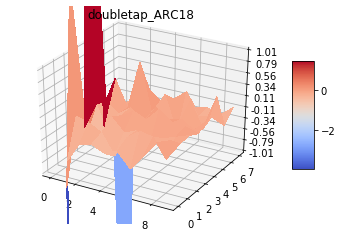

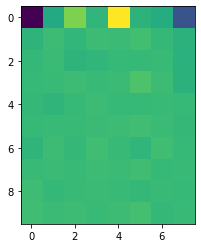

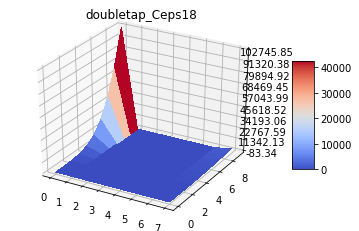

doubletap_19 Row: 8, Column: 8


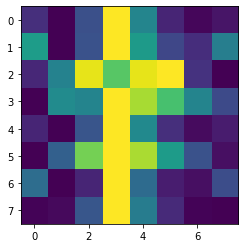

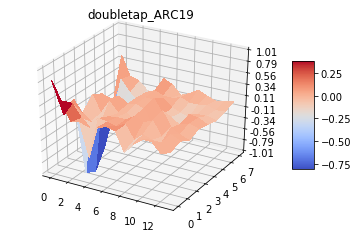

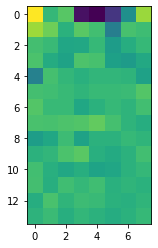

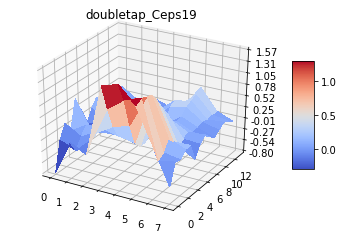

doubletap_20 Row: 8, Column: 8


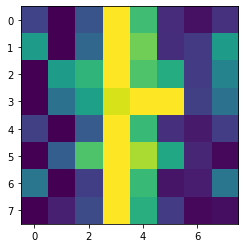

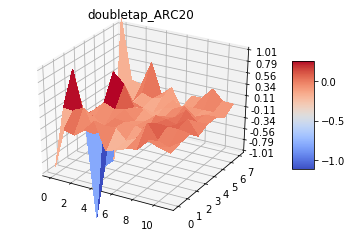

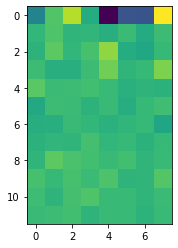

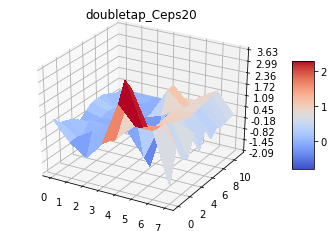

doubletap_21 Row: 8, Column: 8


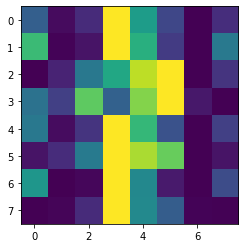

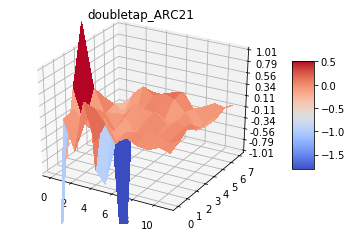

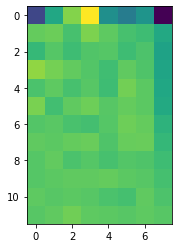

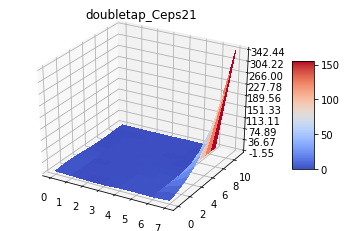

doubletap_22 Row: 8, Column: 8


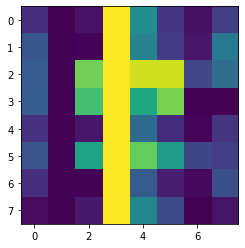

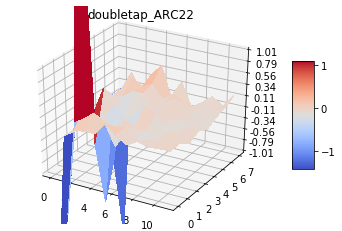

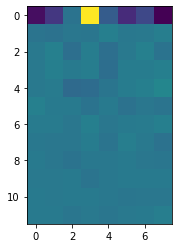

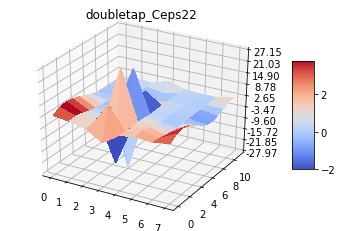

doubletap_23 Row: 8, Column: 8


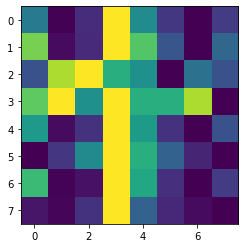

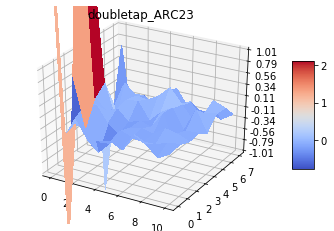

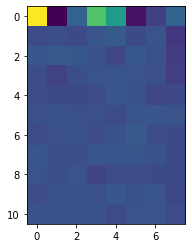

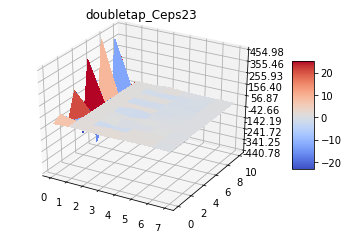

doubletap_24 Row: 8, Column: 8


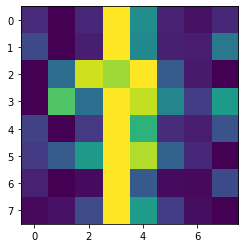

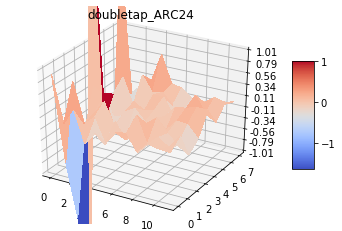

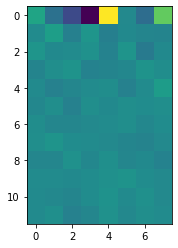

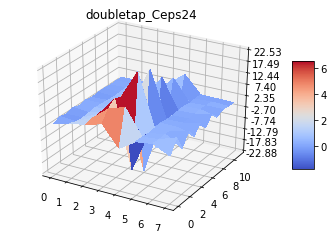

doubletap_25 Row: 8, Column: 8


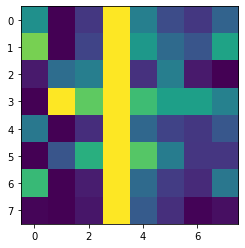

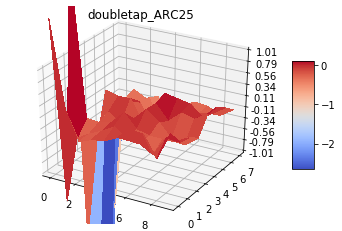

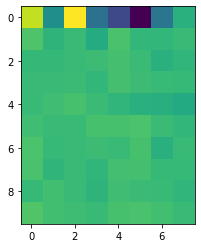

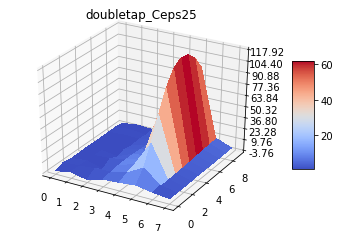

doubletap_26 Row: 8, Column: 8


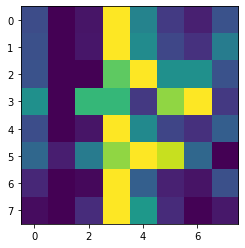

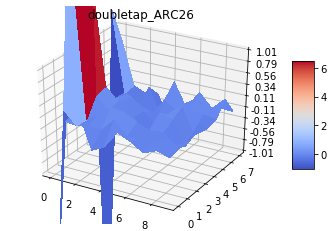

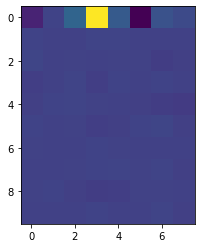

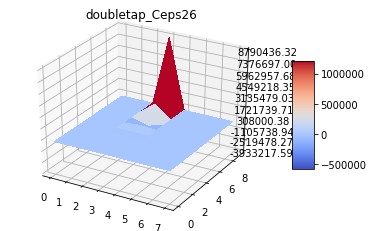

doubletap_27 Row: 8, Column: 8


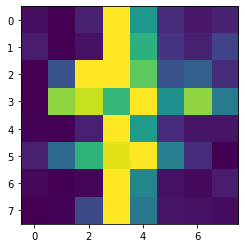

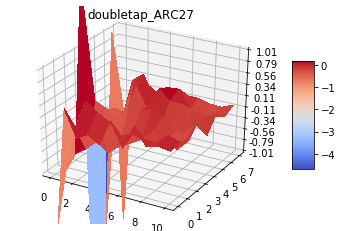

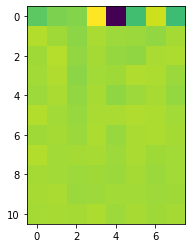

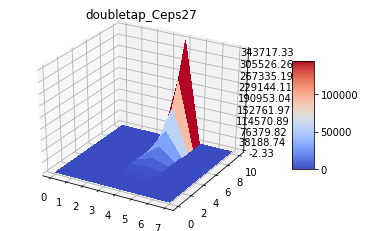

doubletap_28 Row: 8, Column: 8


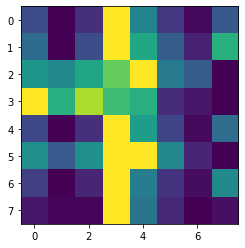

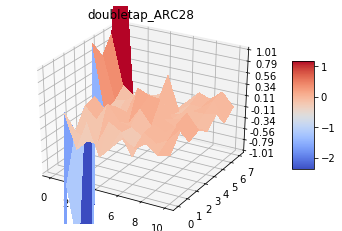

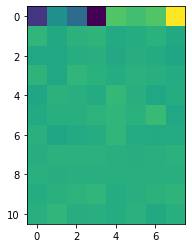

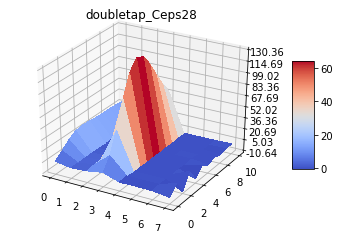

doubletap_29 Row: 8, Column: 8


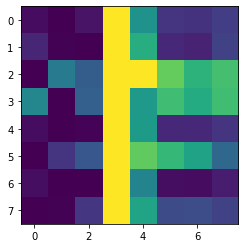

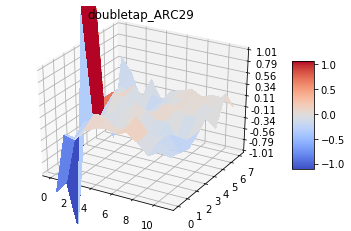

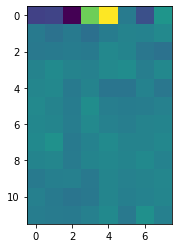

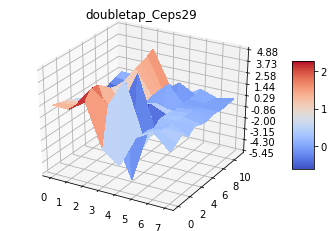

doubletap_30 Row: 8, Column: 8


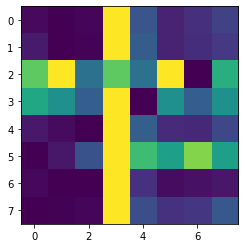

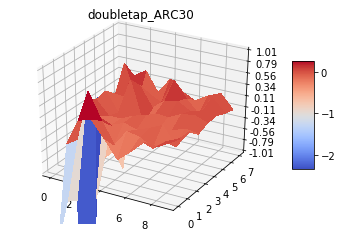

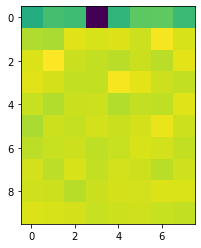

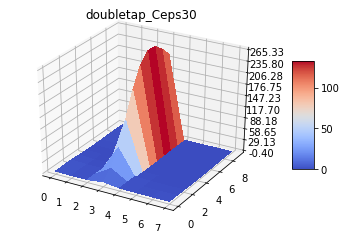

doubletap_31 Row: 8, Column: 8


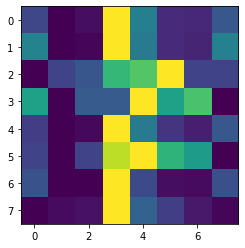

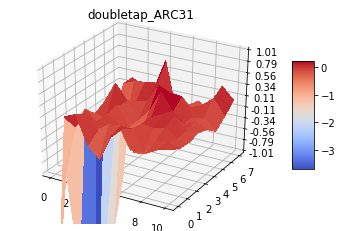

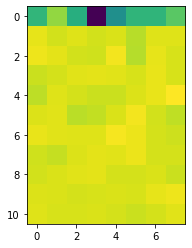

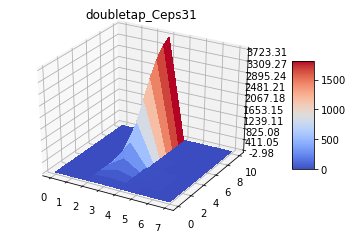

doubletap_32 Row: 8, Column: 8


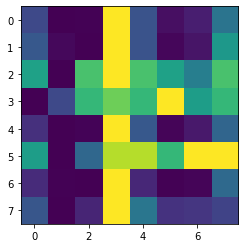

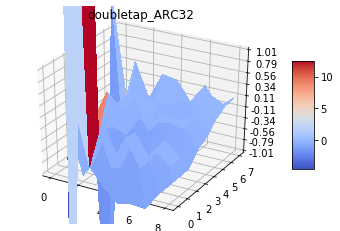

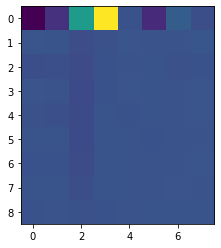

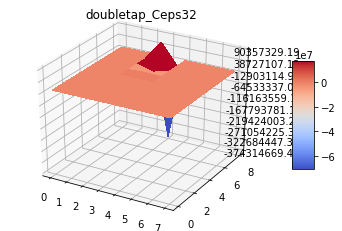

doubletap_33 Row: 8, Column: 8


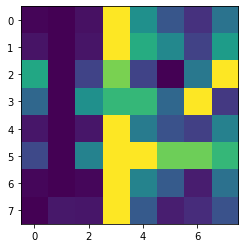

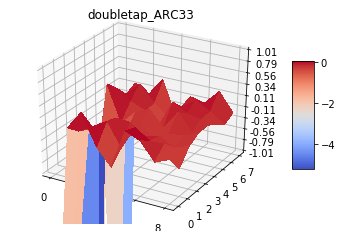

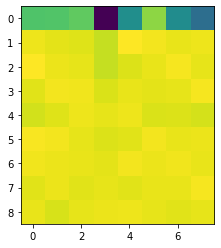

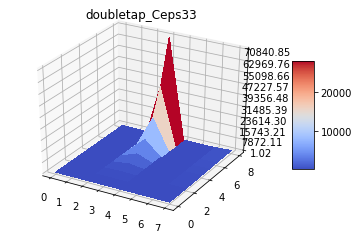

doubletap_34 Row: 8, Column: 8


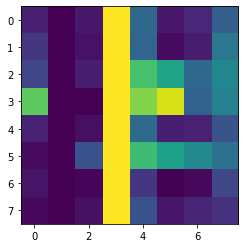

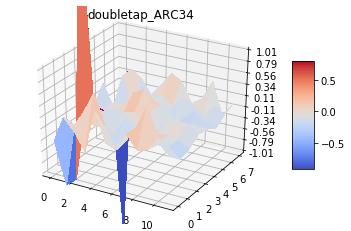

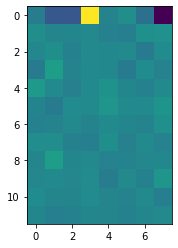

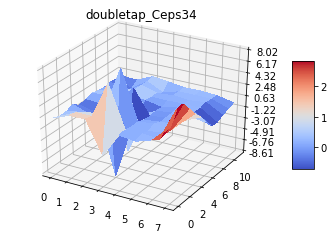

doubletap_35 Row: 8, Column: 8


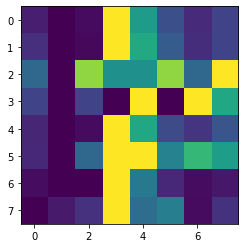

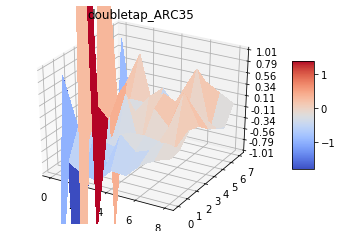

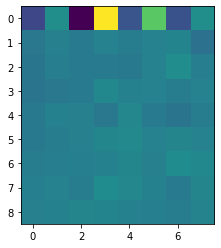

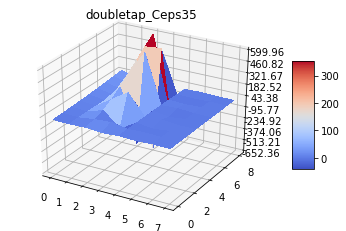

doubletap_36 Row: 8, Column: 8


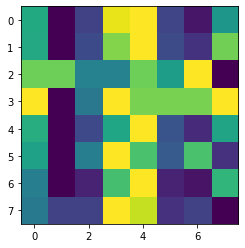

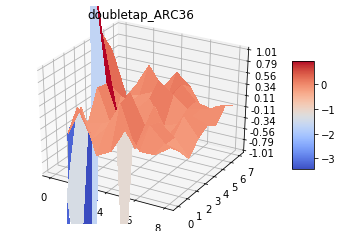

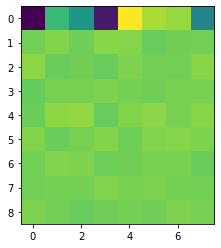

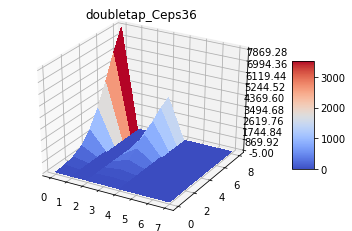

doubletap_37 Row: 8, Column: 8


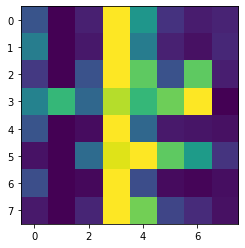

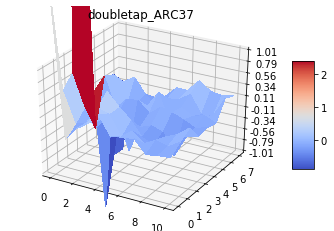

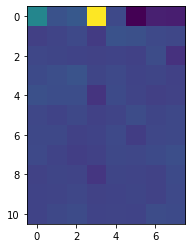

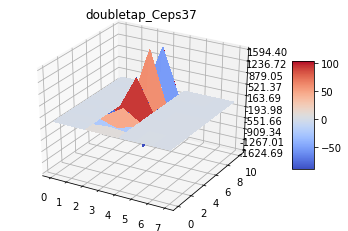

doubletap_38 Row: 8, Column: 8


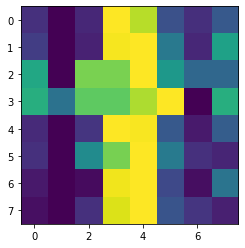

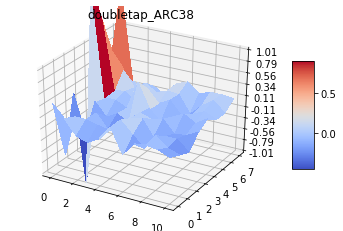

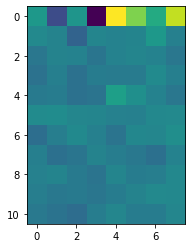

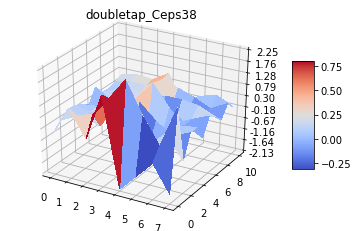

doubletap_39 Row: 8, Column: 8


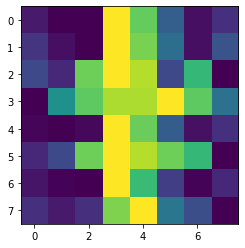

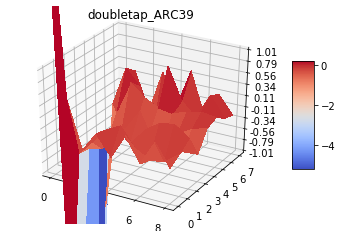

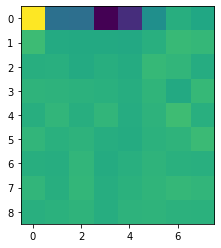

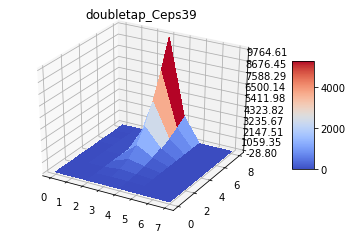

doubletap_40 Row: 8, Column: 8


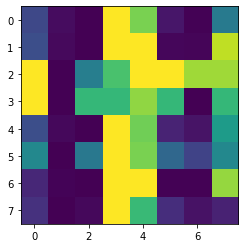

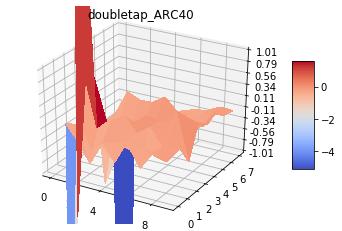

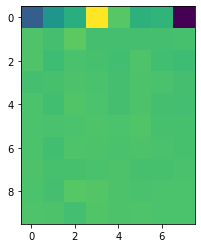

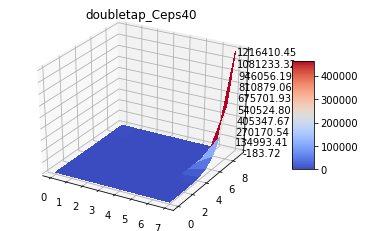

doubletap_41 Row: 8, Column: 8


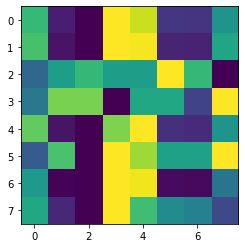

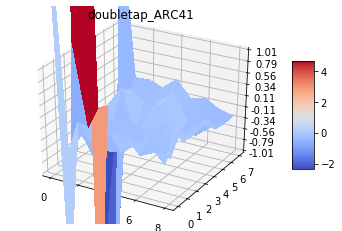

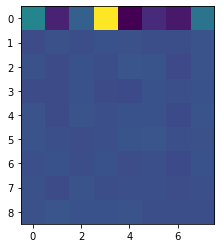

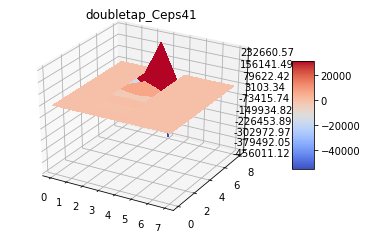

doubletap_42 Row: 8, Column: 8


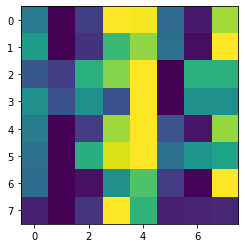

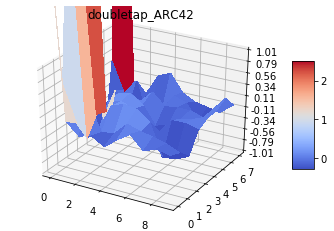

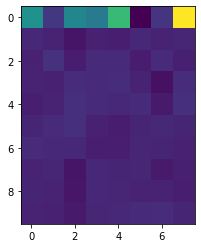

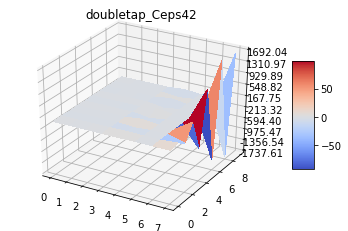

fist_1 Row: 8, Column: 8


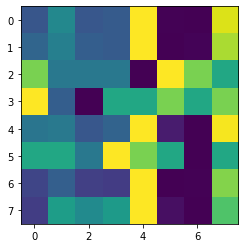

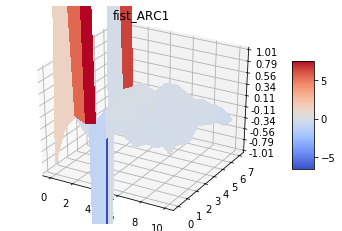

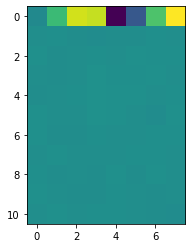

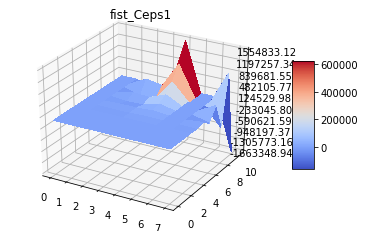

fist_2 Row: 8, Column: 8


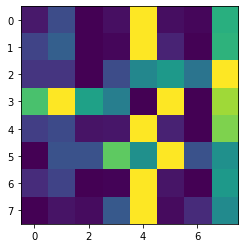

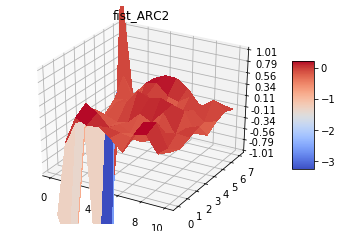

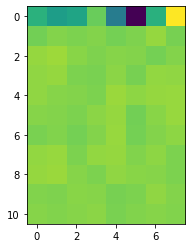

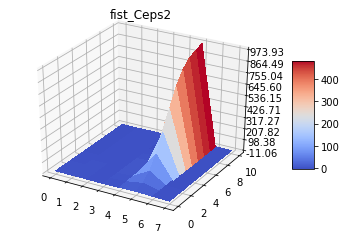

fist_3 Row: 8, Column: 8


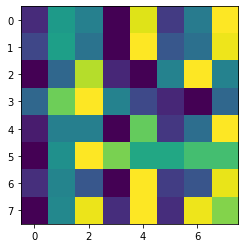

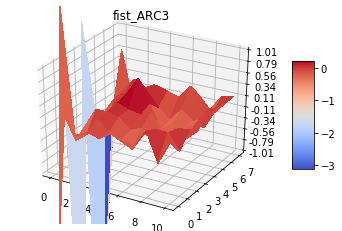

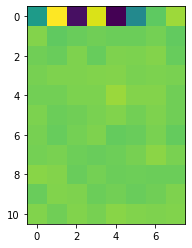

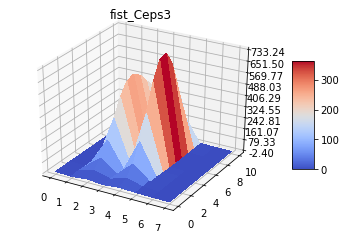

fist_4 Row: 8, Column: 8


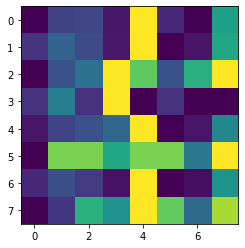

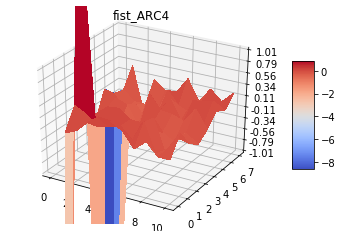

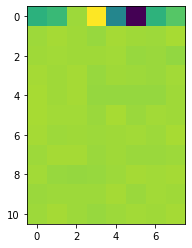

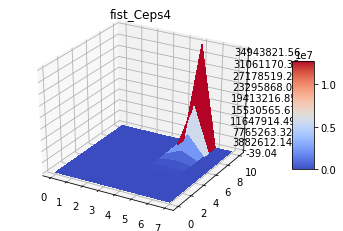

fist_5 Row: 8, Column: 8


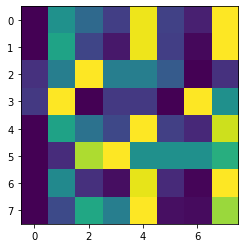

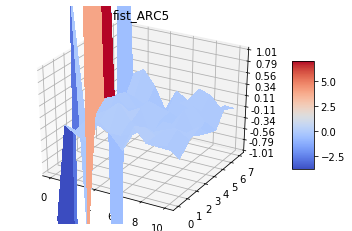

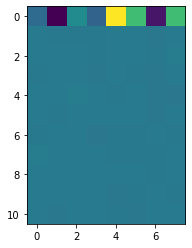

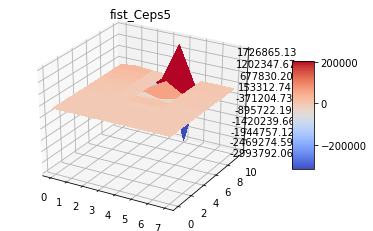

fist_6 Row: 8, Column: 8


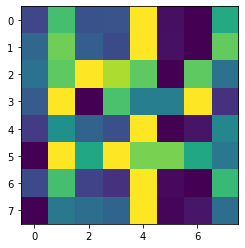

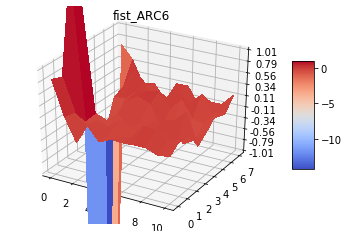

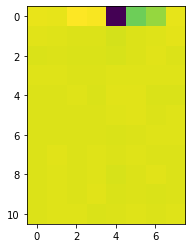

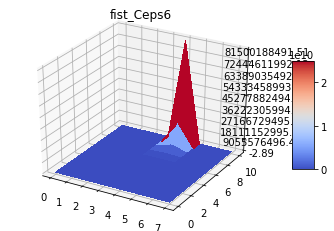

fist_7 Row: 8, Column: 8


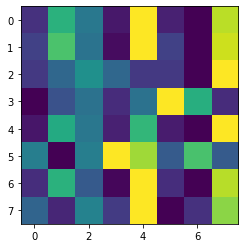

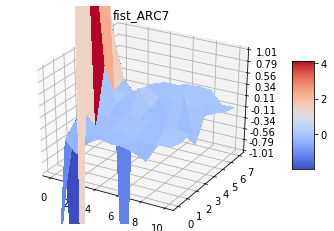

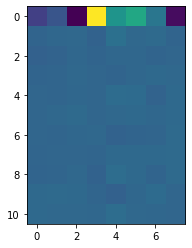

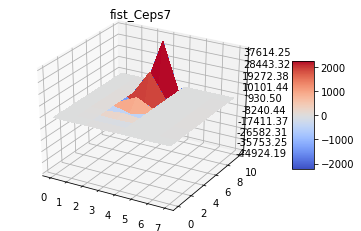

fist_8 Row: 8, Column: 8


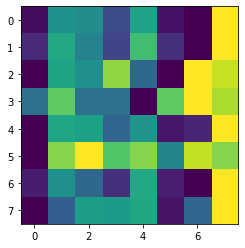

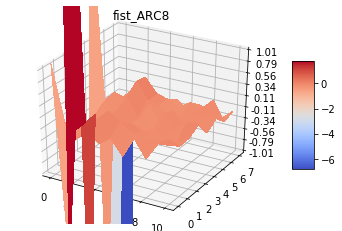

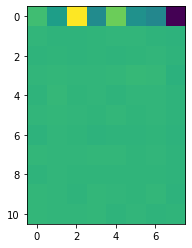

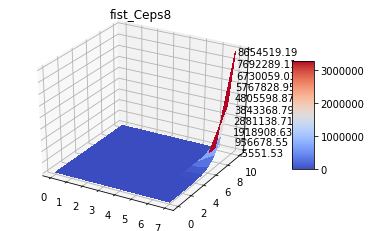

fist_9 Row: 8, Column: 8


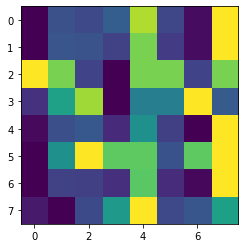

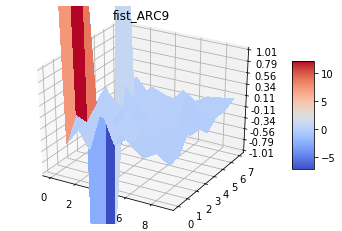

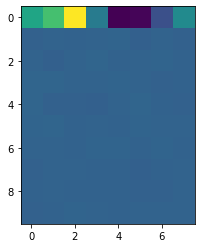

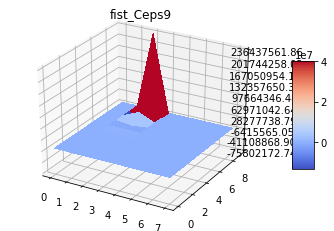

fist_10 Row: 8, Column: 8


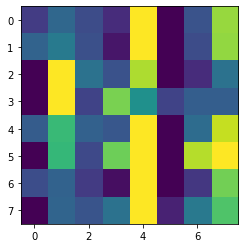

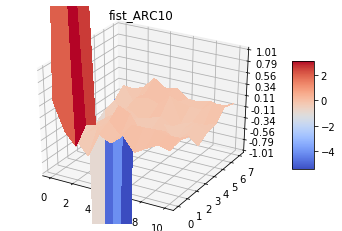

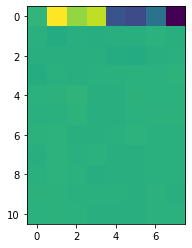

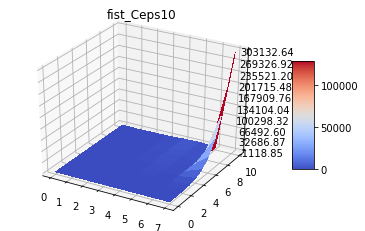

fist_11 Row: 8, Column: 8


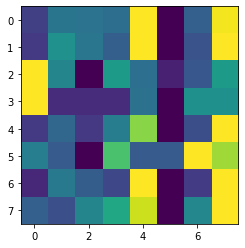

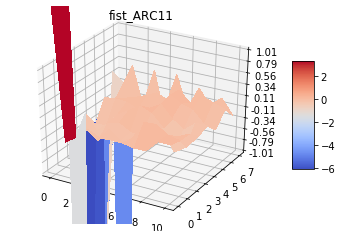

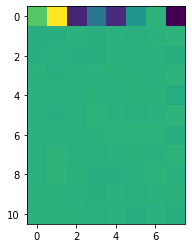

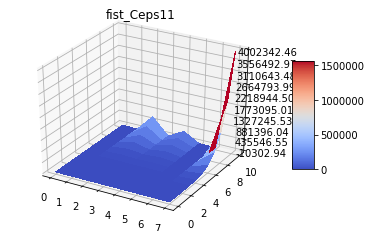

fist_12 Row: 8, Column: 8


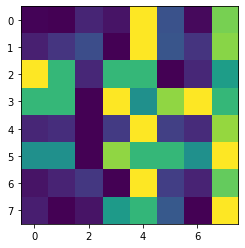

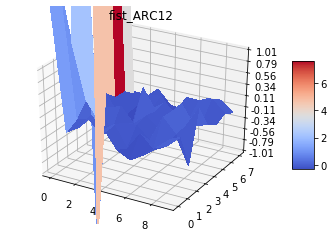

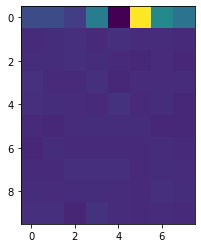

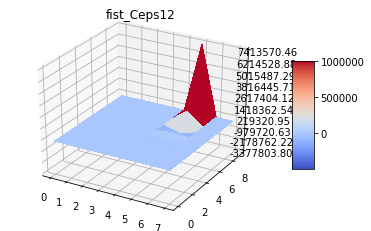

fist_13 Row: 8, Column: 8


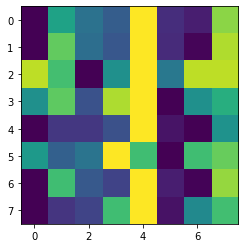

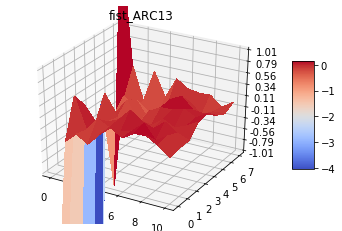

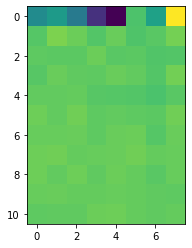

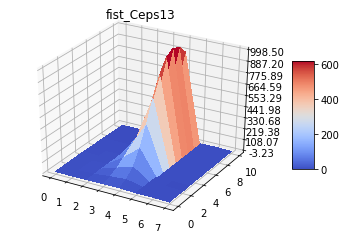

fist_14 Row: 8, Column: 8


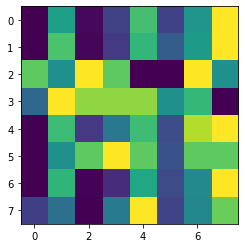

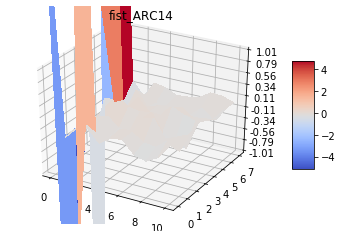

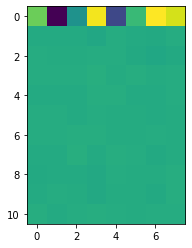

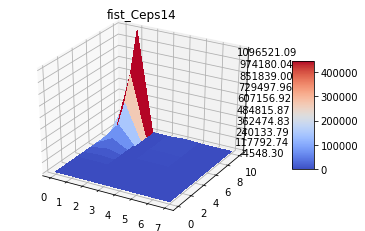

fist_15 Row: 8, Column: 8


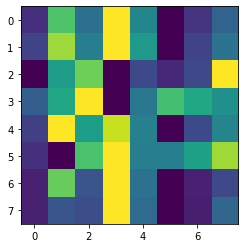

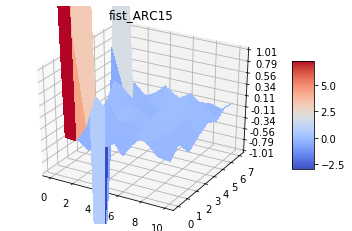

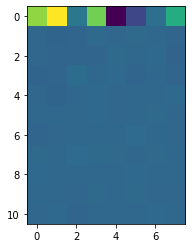

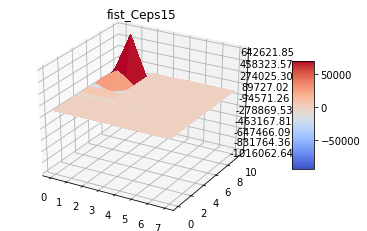

fist_16 Row: 8, Column: 8


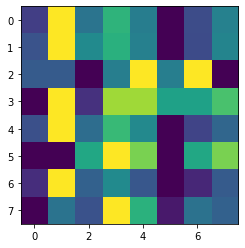

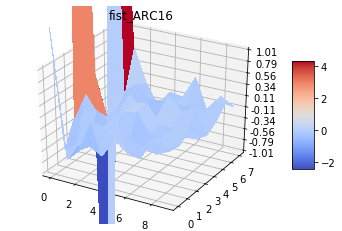

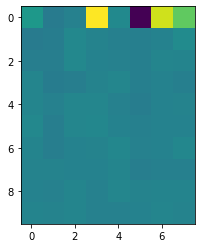

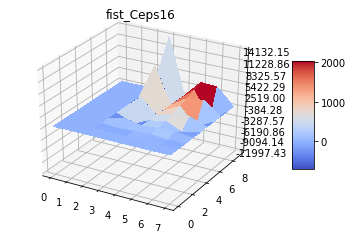

fist_17 Row: 8, Column: 8


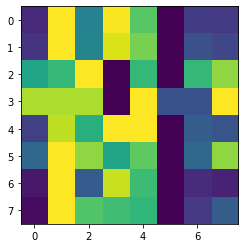

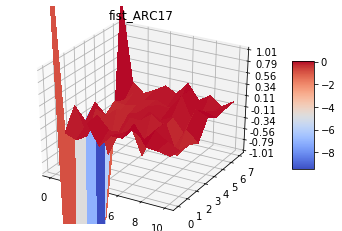

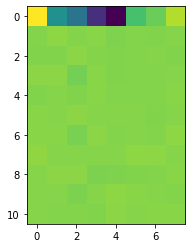

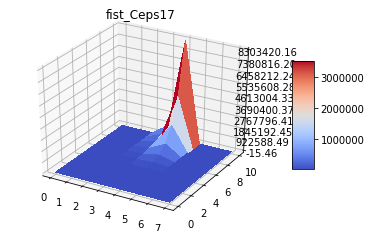

fist_18 Row: 8, Column: 8


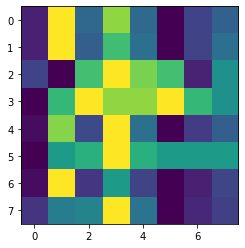

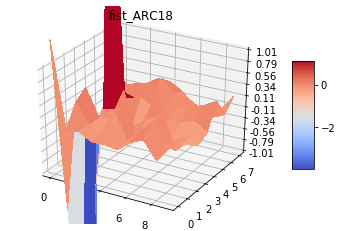

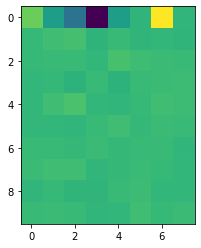

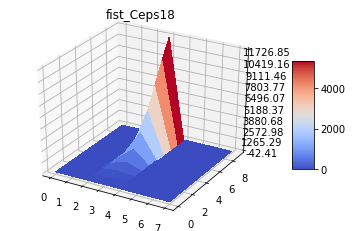

fist_19 Row: 8, Column: 8


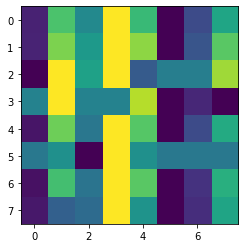

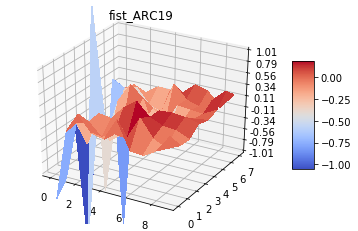

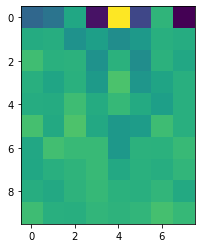

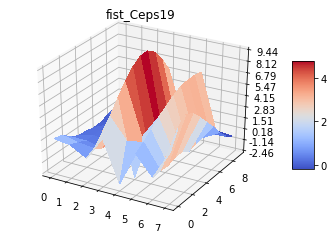

fist_20 Row: 8, Column: 8


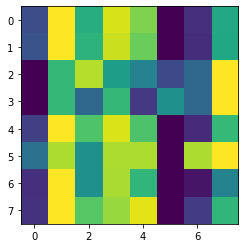

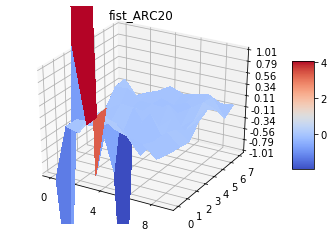

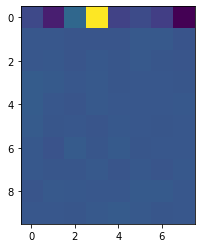

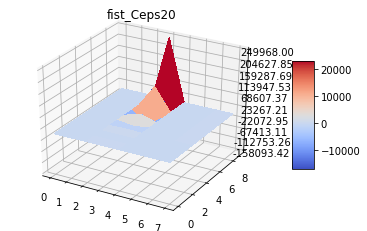

fist_21 Row: 8, Column: 8


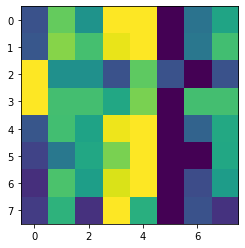

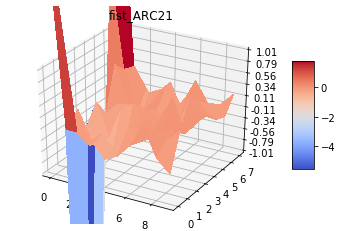

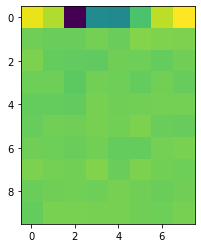

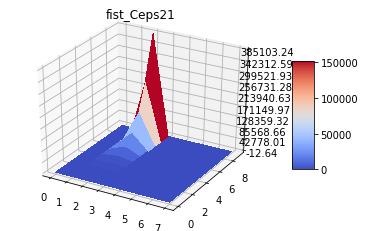

fist_22 Row: 8, Column: 8


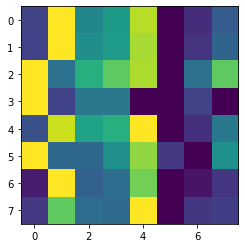

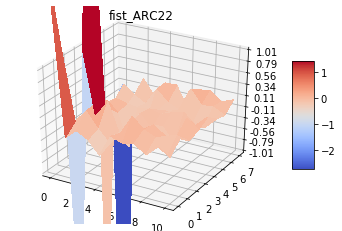

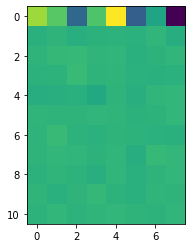

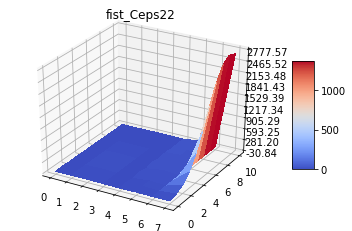

fist_23 Row: 8, Column: 8


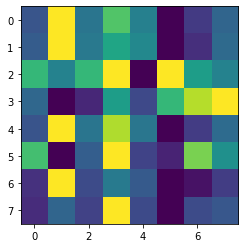

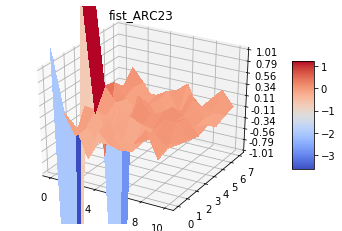

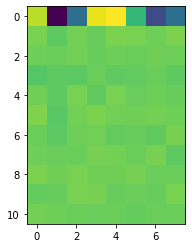

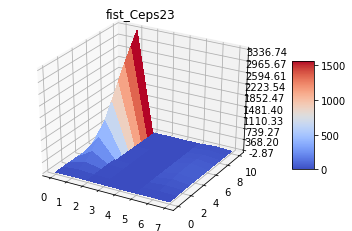

fist_24 Row: 8, Column: 8


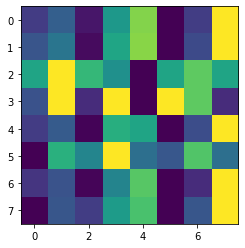

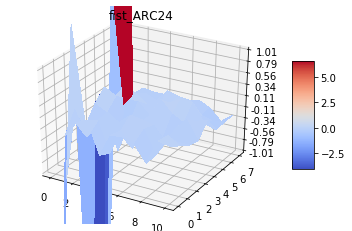

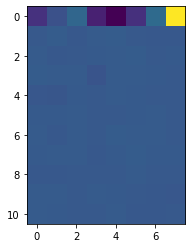

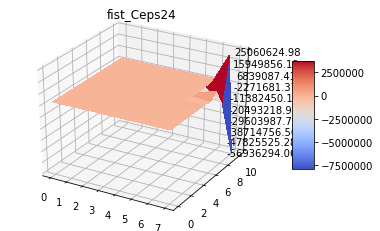

fist_25 Row: 8, Column: 8


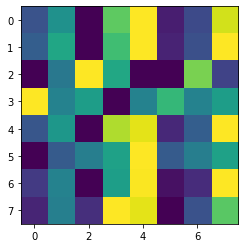

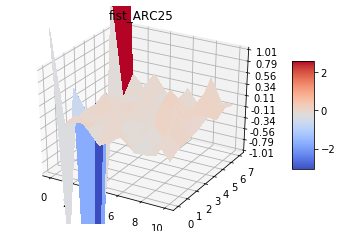

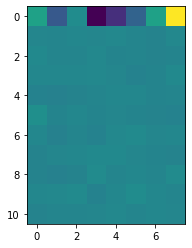

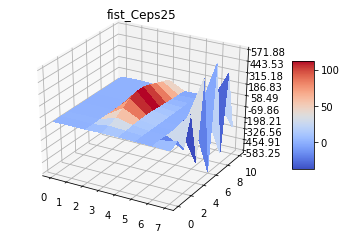

fist_26 Row: 8, Column: 8


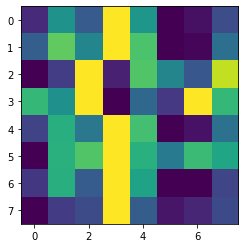

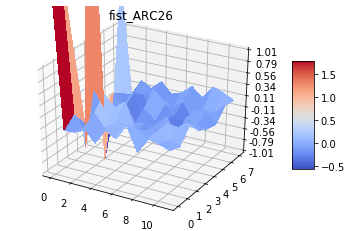

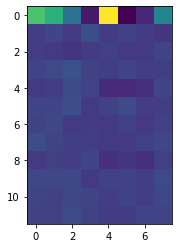

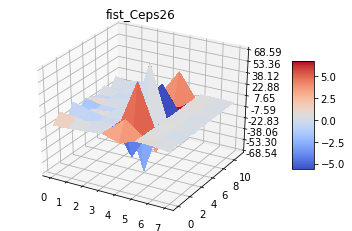

fist_27 Row: 8, Column: 8


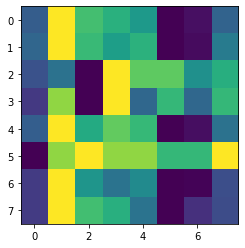

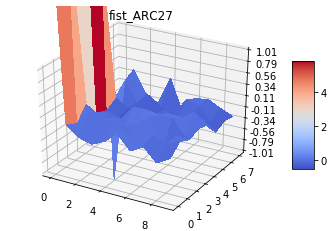

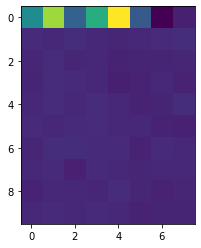

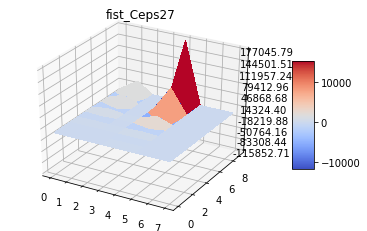

fist_28 Row: 8, Column: 8


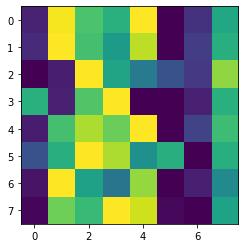

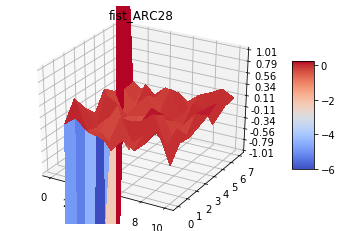

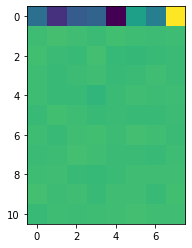

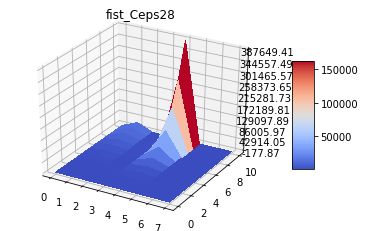

fist_29 Row: 8, Column: 8


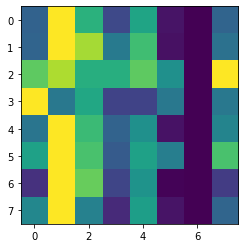

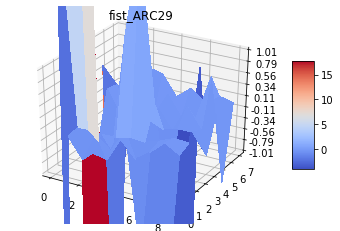

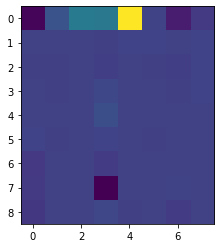

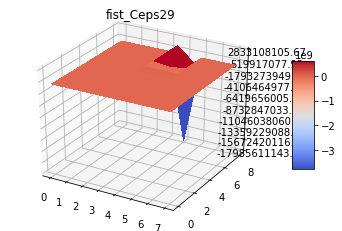

fist_30 Row: 8, Column: 8


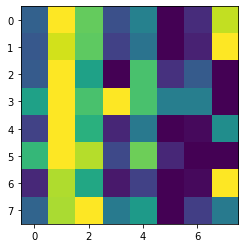

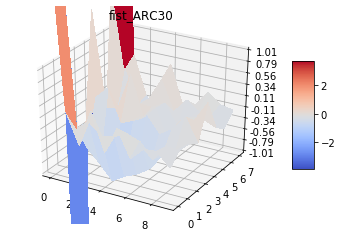

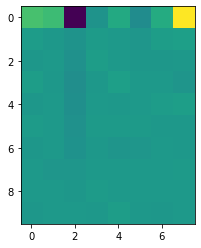

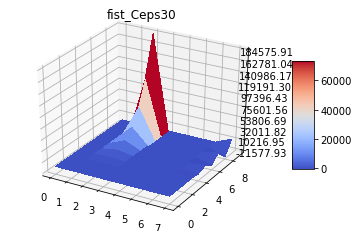

fist_31 Row: 8, Column: 8


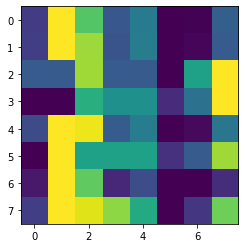

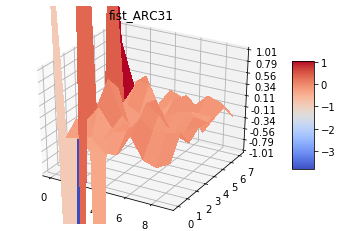

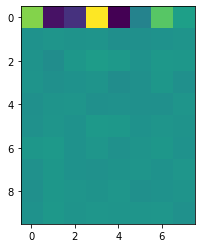

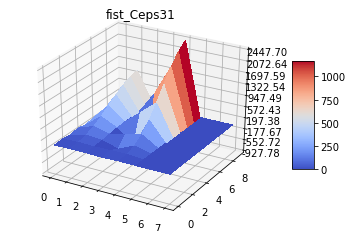

fist_32 Row: 8, Column: 8


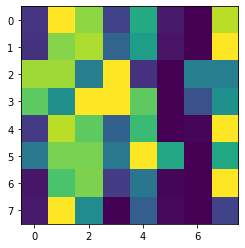

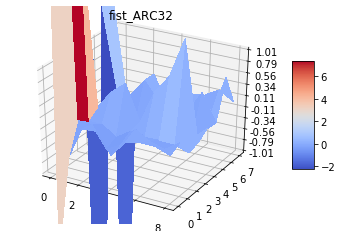

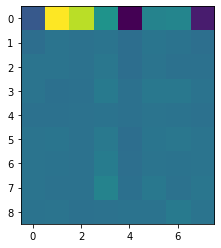

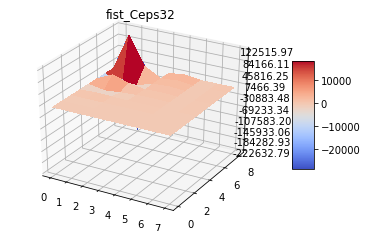

fist_33 Row: 8, Column: 8


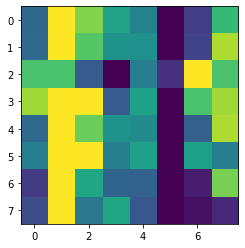

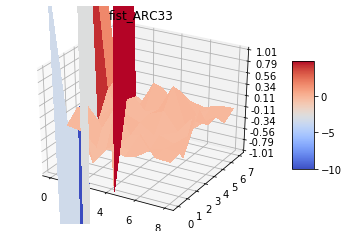

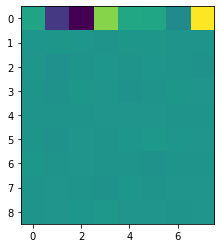

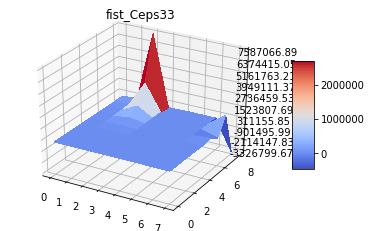

fist_34 Row: 8, Column: 8


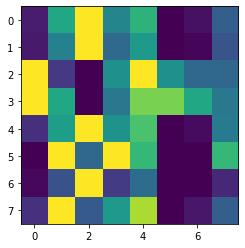

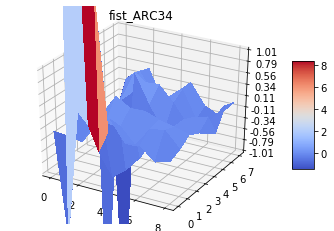

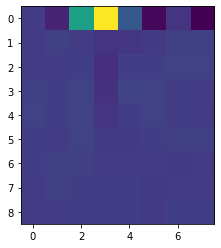

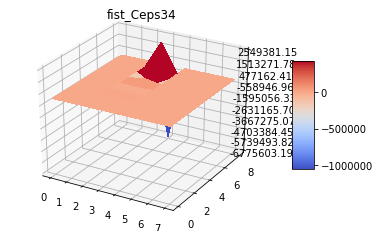

fist_35 Row: 8, Column: 8


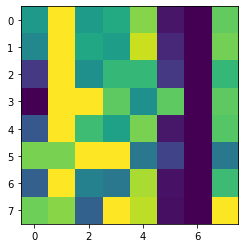

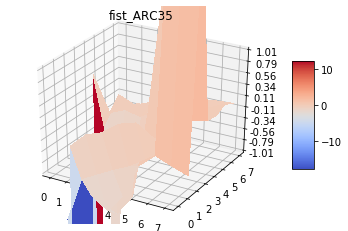

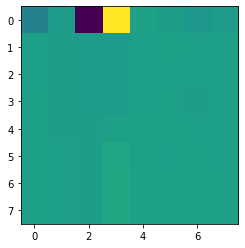

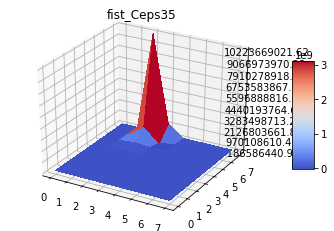

fist_36 Row: 8, Column: 8


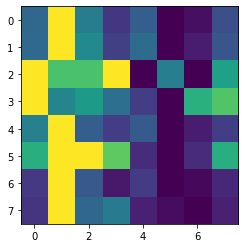

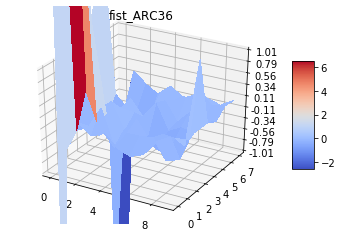

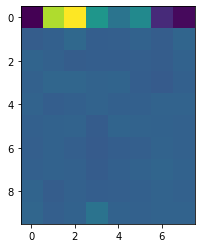

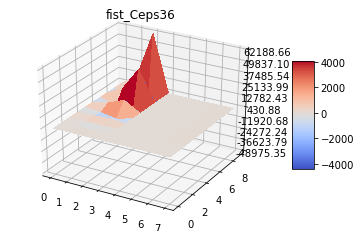

fist_37 Row: 8, Column: 8


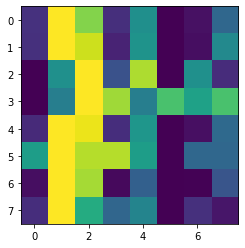

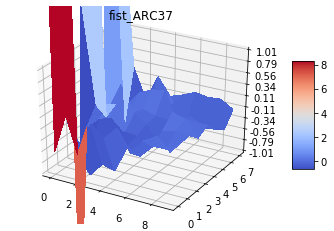

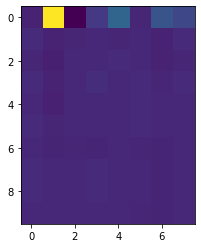

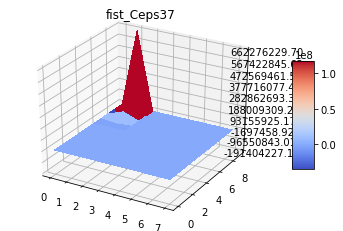

fist_38 Row: 8, Column: 8


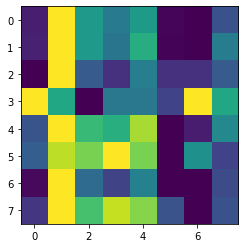

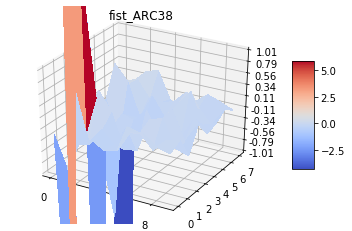

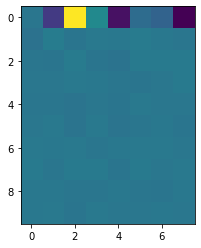

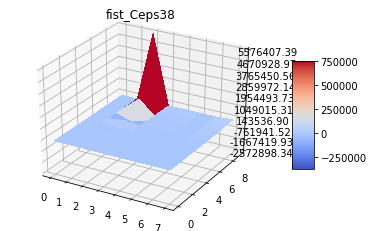

fist_39 Row: 8, Column: 8


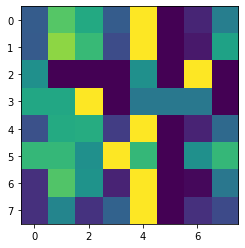

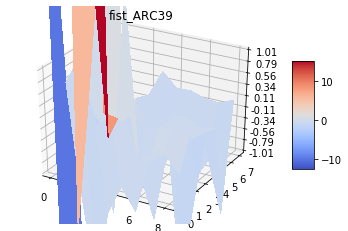

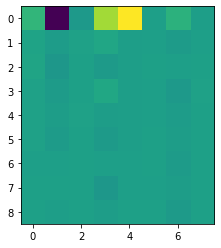

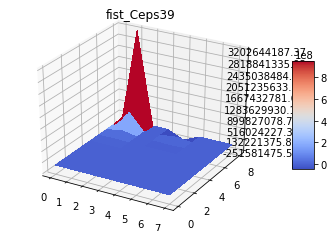

fist_40 Row: 8, Column: 8


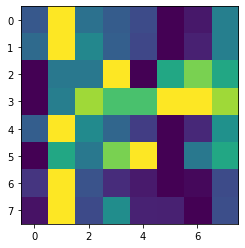

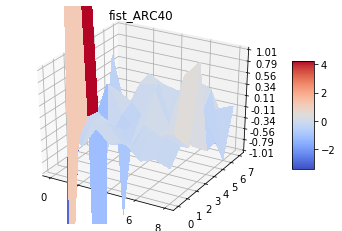

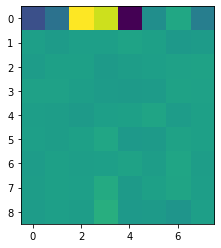

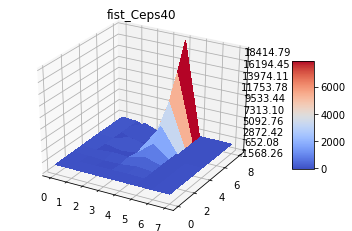

fist_41 Row: 8, Column: 8


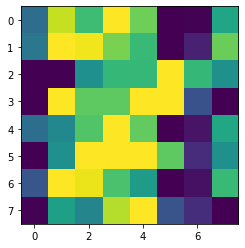

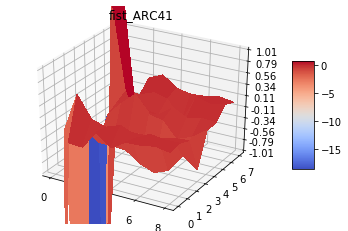

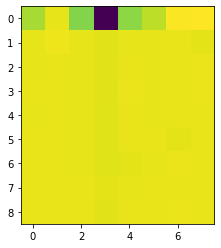

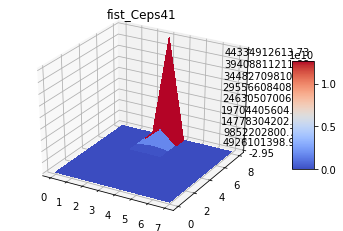

fist_42 Row: 8, Column: 8


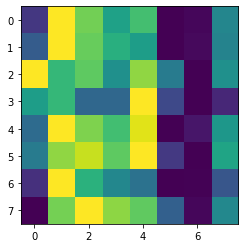

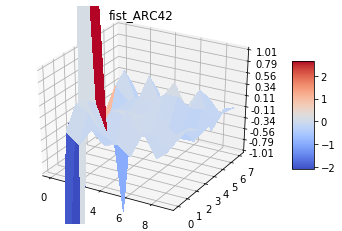

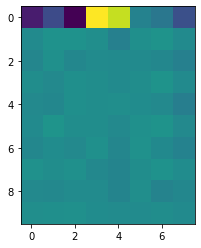

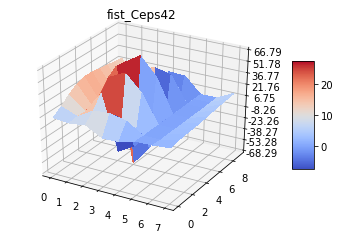

spread_1 Row: 8, Column: 8


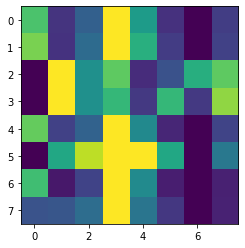

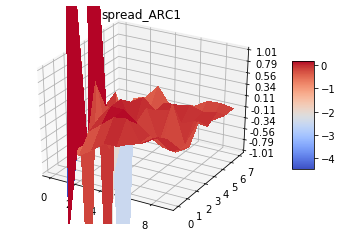

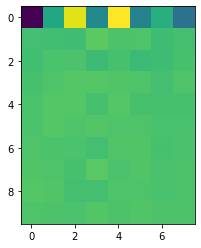

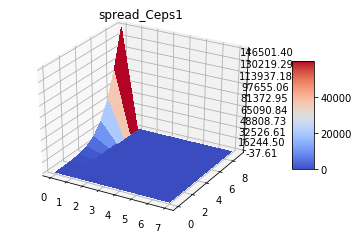

spread_2 Row: 8, Column: 8


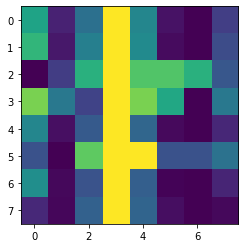

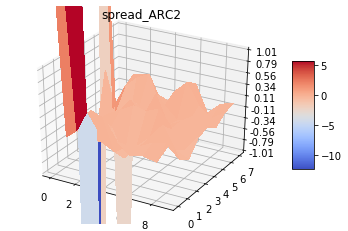

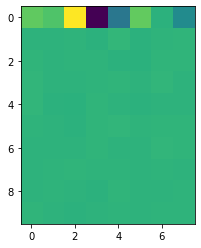

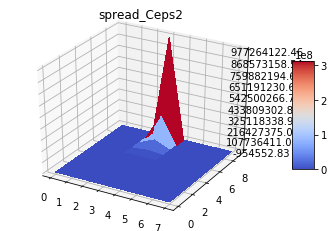

spread_3 Row: 8, Column: 8


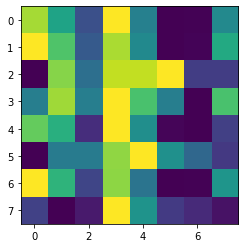

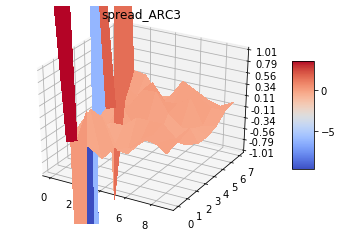

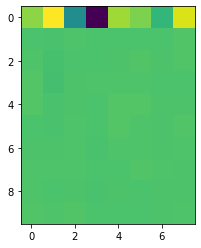

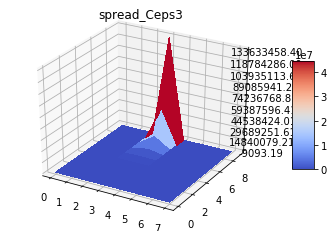

spread_4 Row: 8, Column: 8


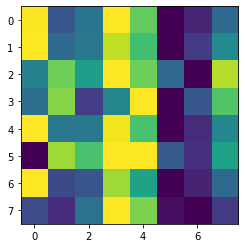

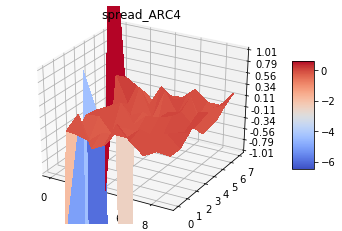

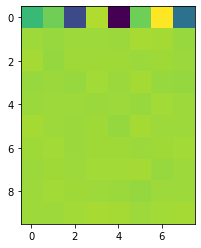

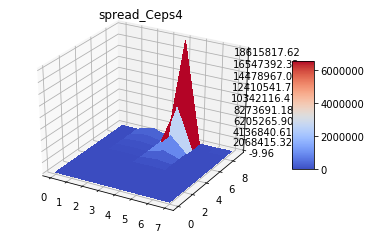

spread_5 Row: 8, Column: 8


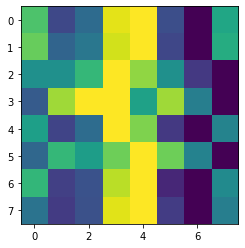

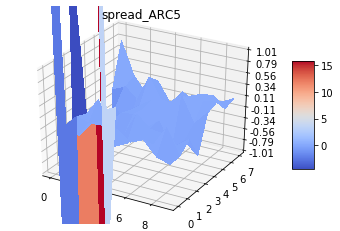

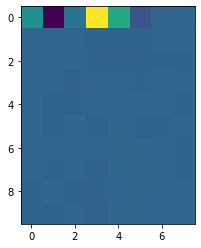

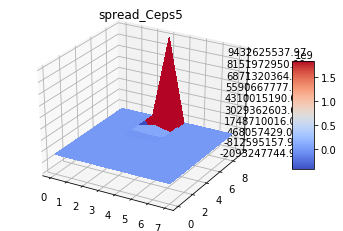

spread_6 Row: 8, Column: 8


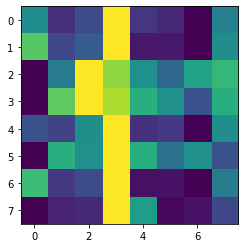

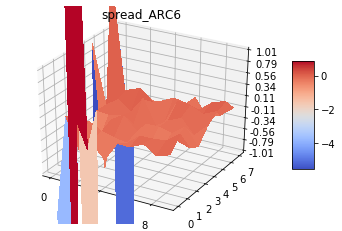

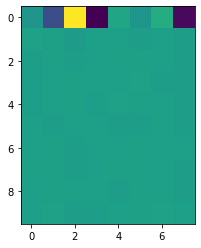

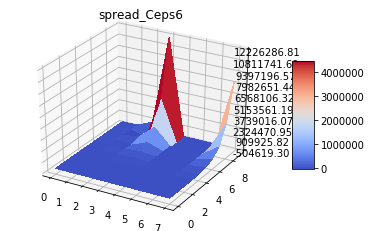

spread_7 Row: 8, Column: 8


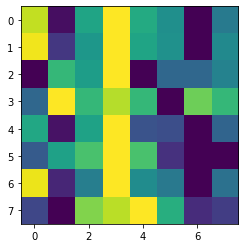

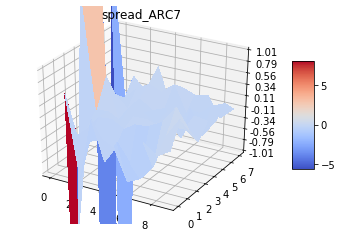

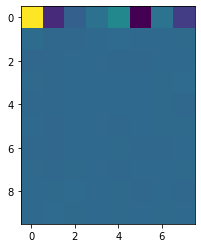

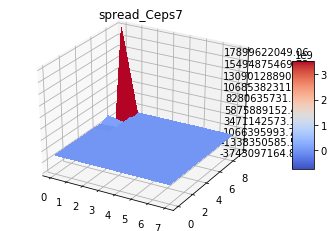

spread_8 Row: 8, Column: 8


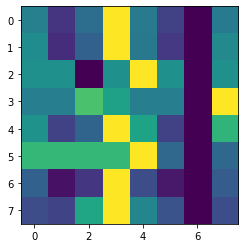

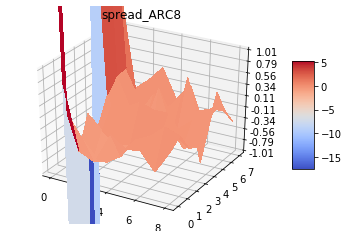

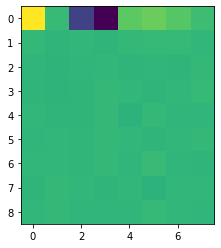

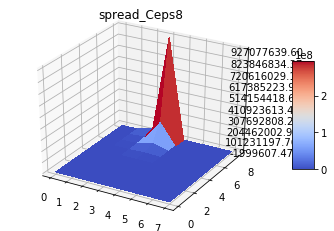

spread_9 Row: 8, Column: 8


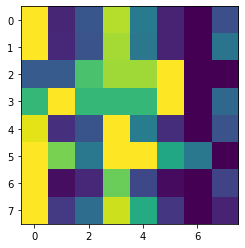

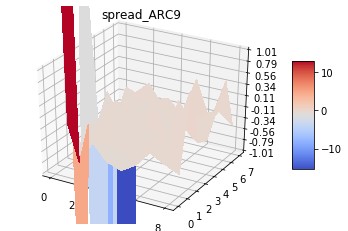

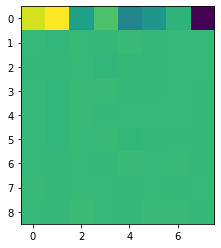

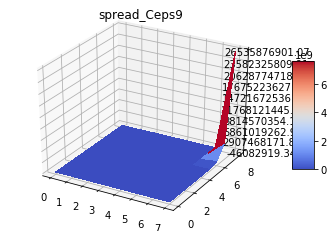

spread_10 Row: 8, Column: 8


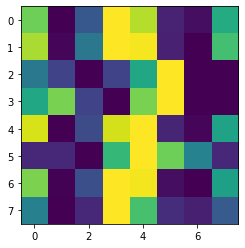

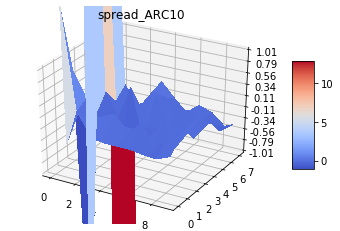

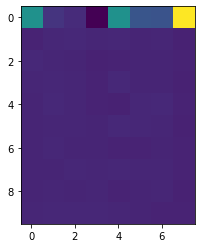

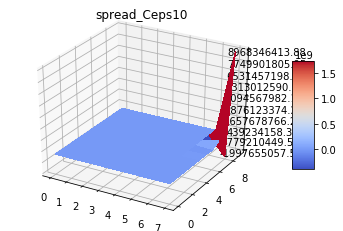

spread_11 Row: 8, Column: 8


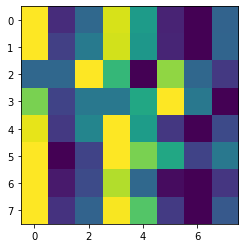

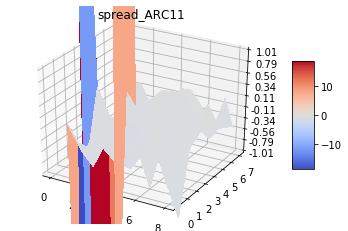

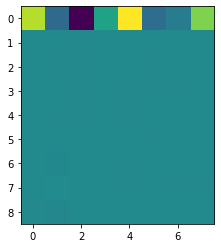

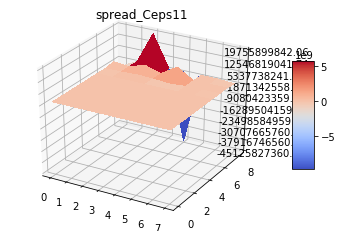

spread_12 Row: 8, Column: 8


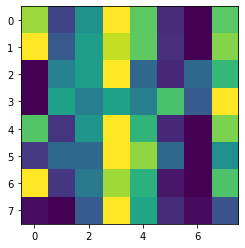

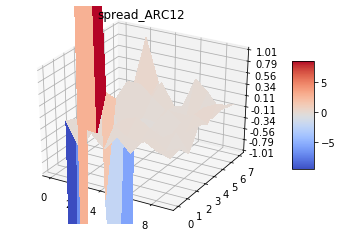

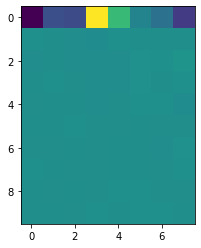

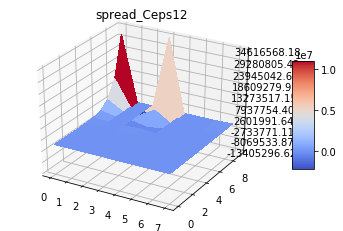

spread_13 Row: 8, Column: 8


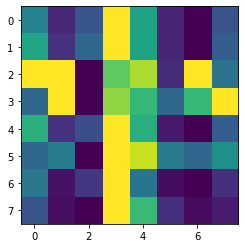

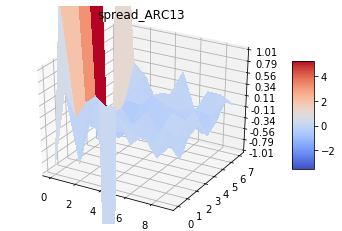

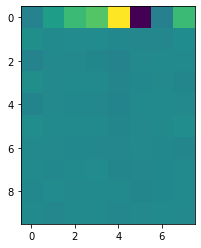

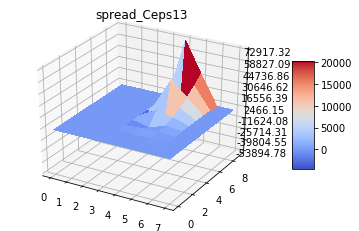

spread_14 Row: 8, Column: 8


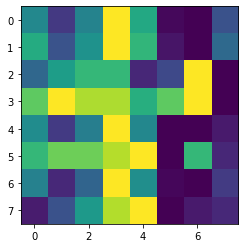

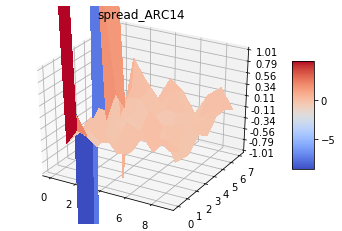

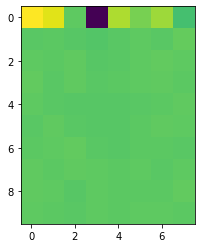

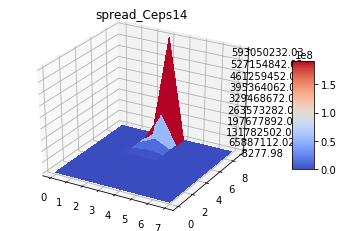

spread_15 Row: 8, Column: 8


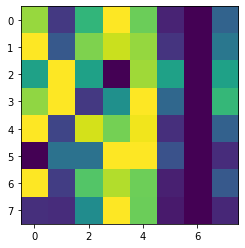

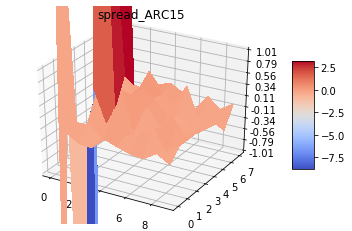

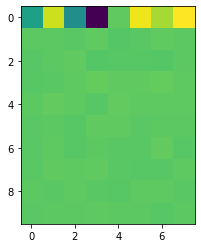

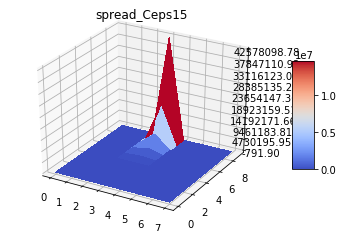

spread_16 Row: 8, Column: 8


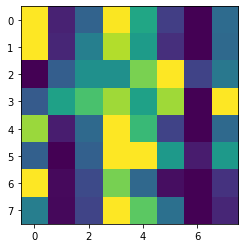

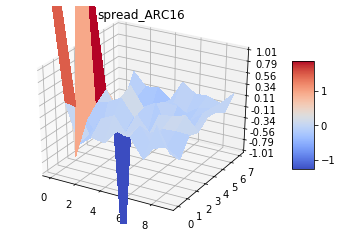

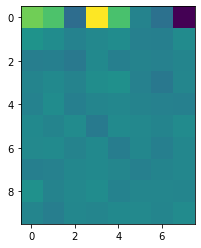

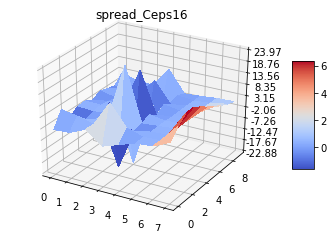

spread_17 Row: 8, Column: 8


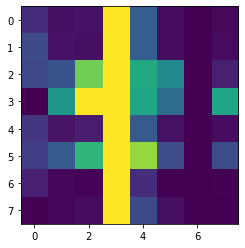

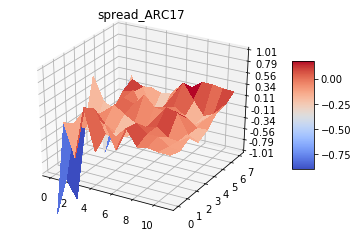

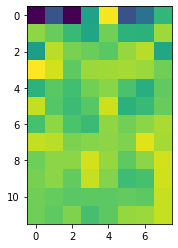

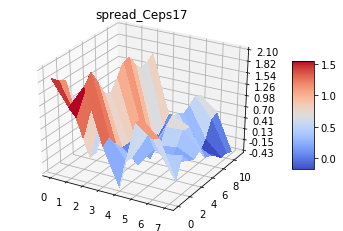

spread_18 Row: 8, Column: 8


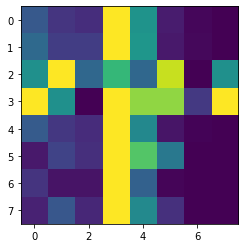

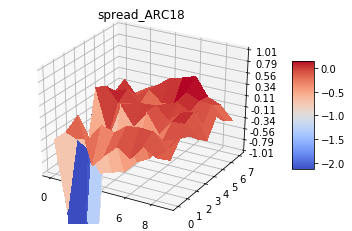

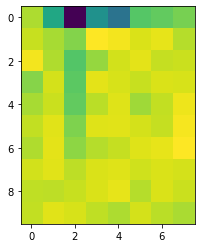

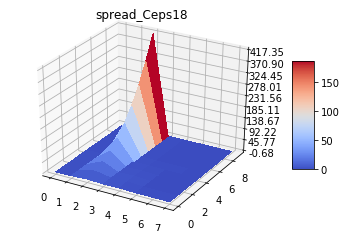

spread_19 Row: 8, Column: 8


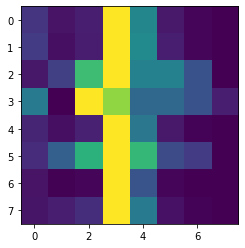

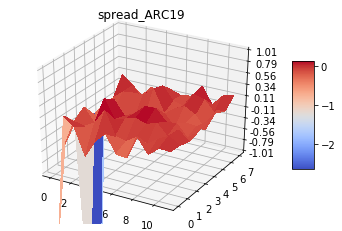

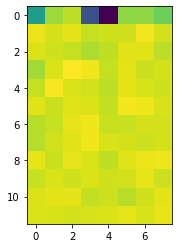

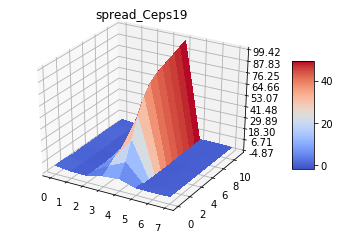

spread_20 Row: 8, Column: 8


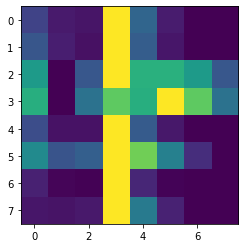

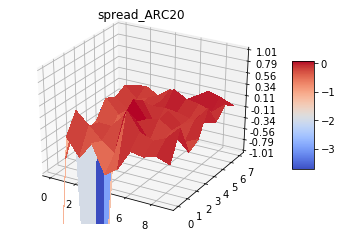

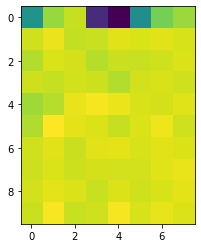

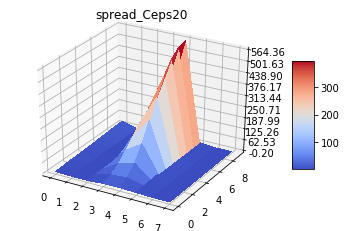

spread_21 Row: 8, Column: 8


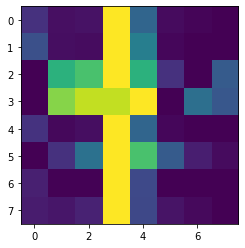

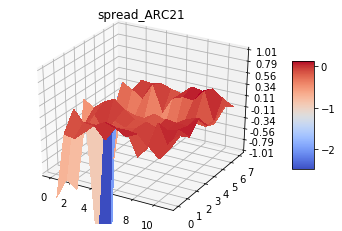

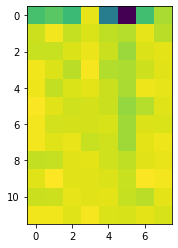

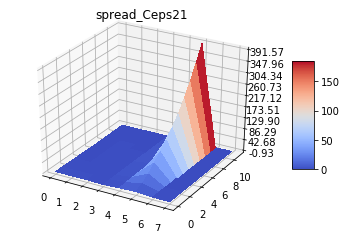

spread_22 Row: 8, Column: 8


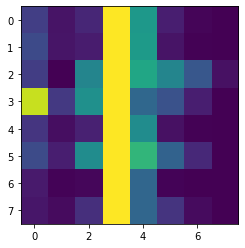

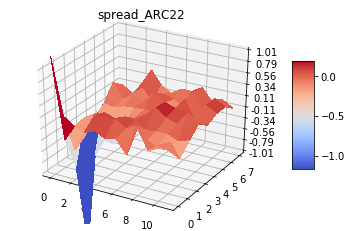

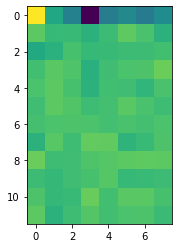

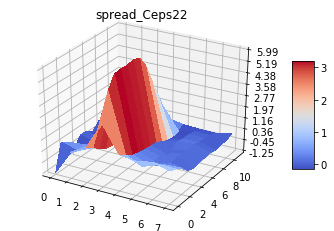

spread_23 Row: 8, Column: 8


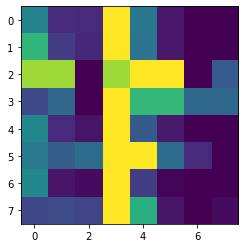

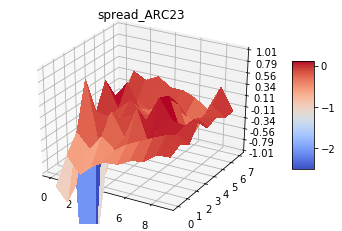

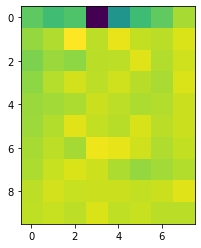

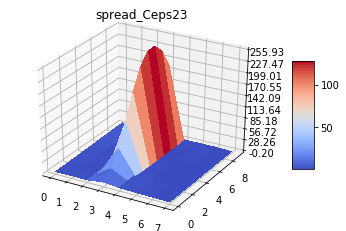

spread_24 Row: 8, Column: 8


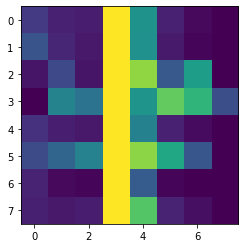

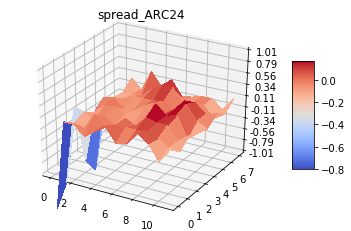

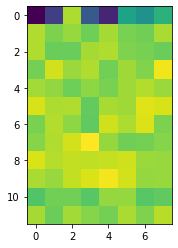

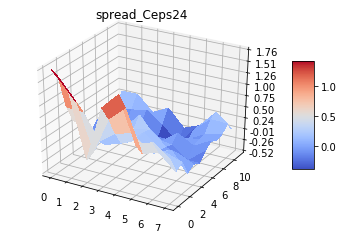

spread_25 Row: 8, Column: 8


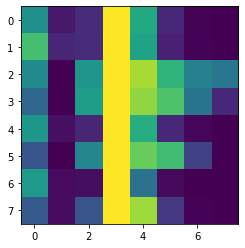

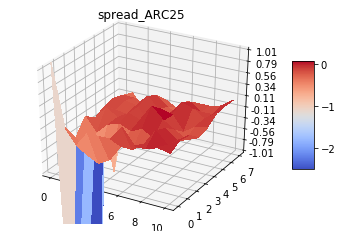

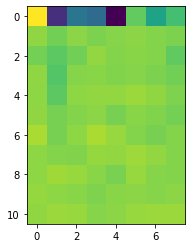

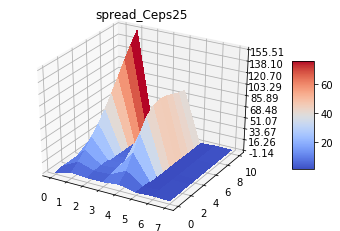

spread_26 Row: 8, Column: 8


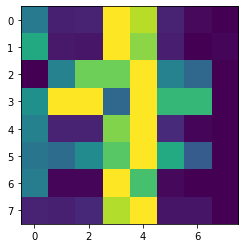

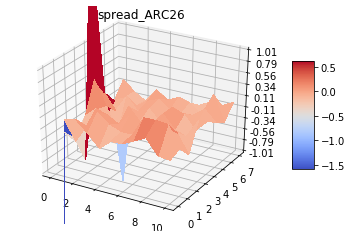

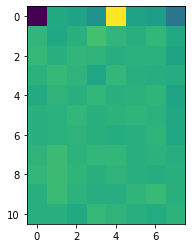

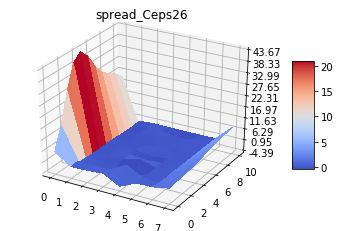

spread_27 Row: 8, Column: 8


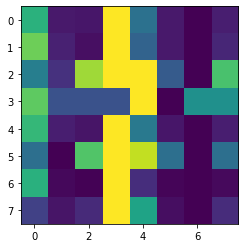

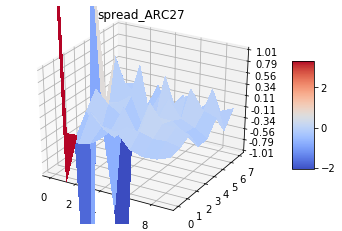

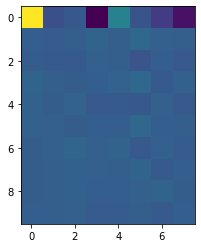

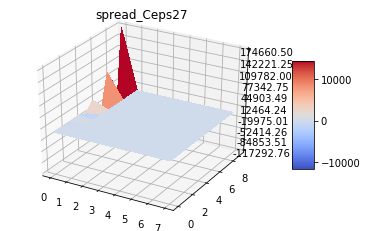

spread_28 Row: 8, Column: 8


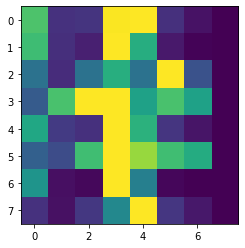

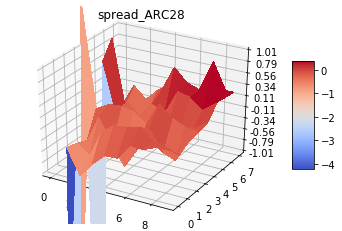

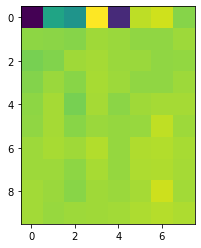

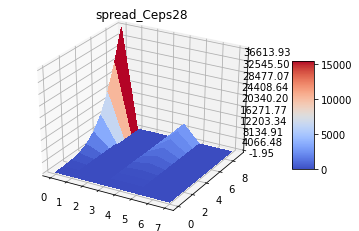

spread_29 Row: 8, Column: 8


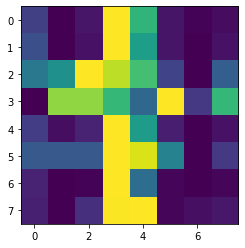

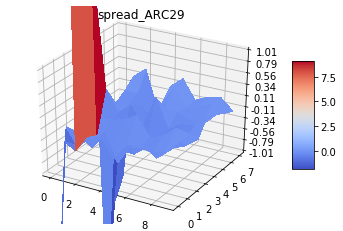

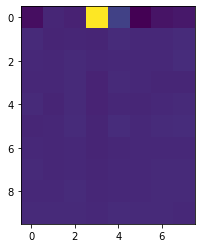

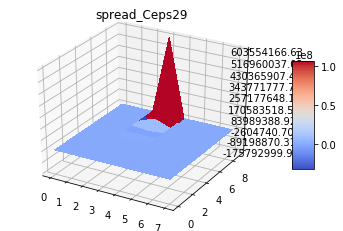

spread_30 Row: 8, Column: 8


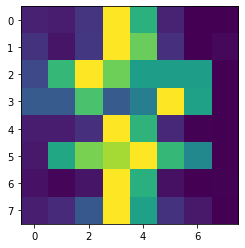

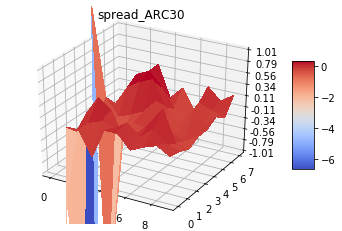

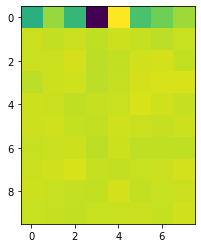

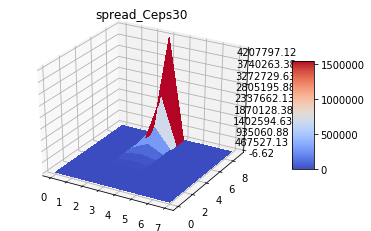

spread_31 Row: 8, Column: 8


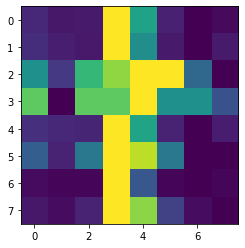

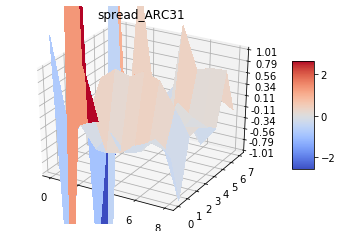

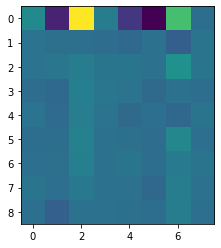

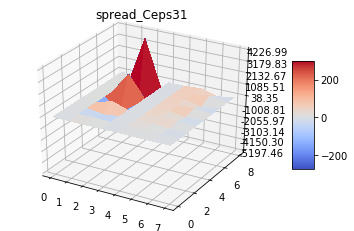

spread_32 Row: 8, Column: 8


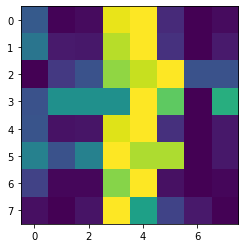

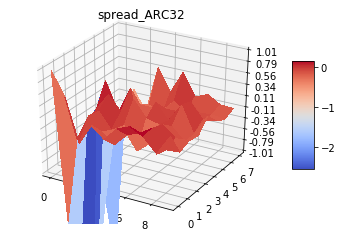

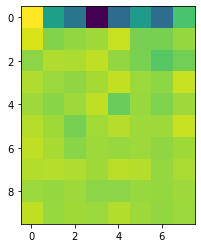

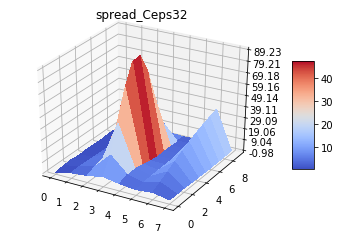

spread_33 Row: 8, Column: 8


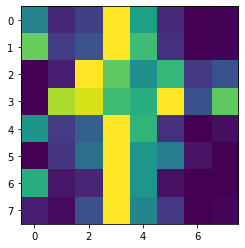

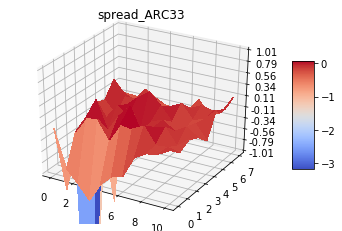

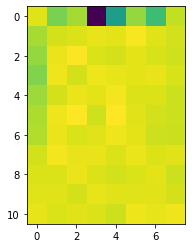

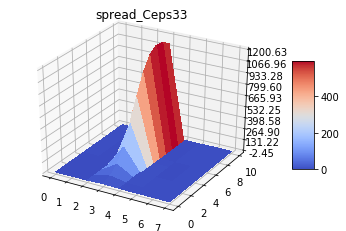

spread_34 Row: 8, Column: 8


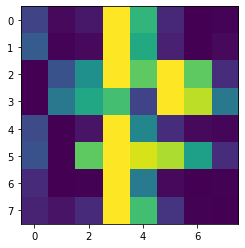

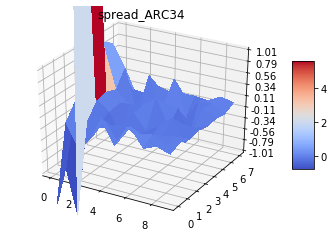

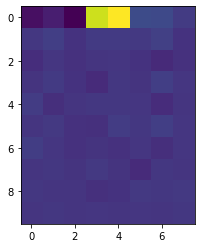

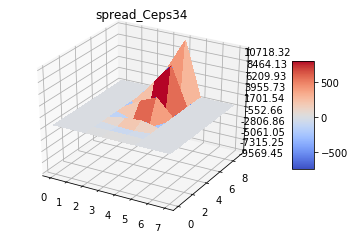

spread_35 Row: 8, Column: 8


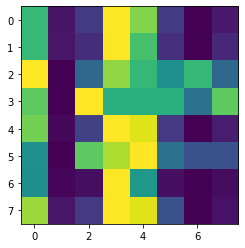

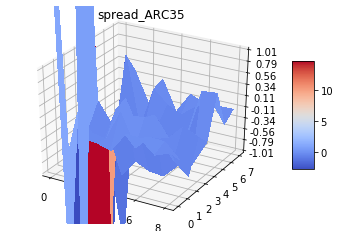

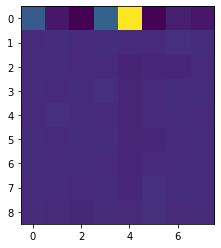

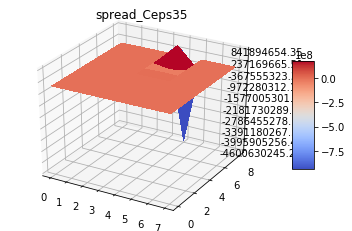

spread_36 Row: 8, Column: 8


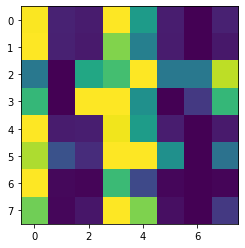

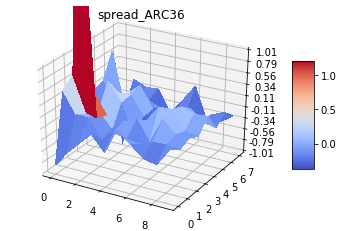

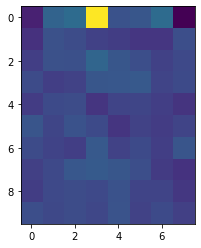

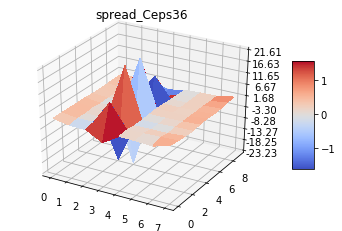

spread_37 Row: 8, Column: 8


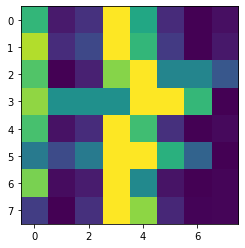

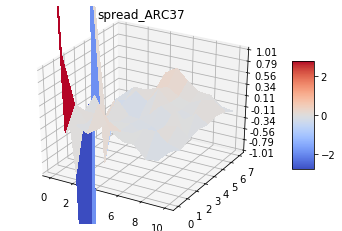

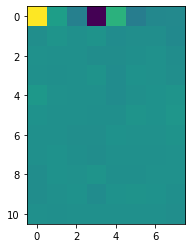

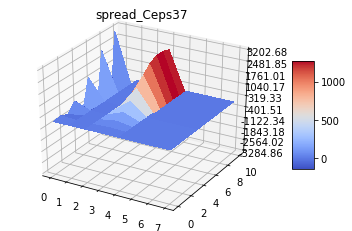

spread_38 Row: 8, Column: 8


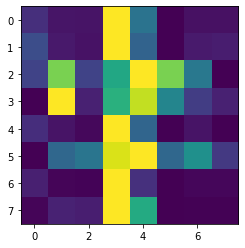

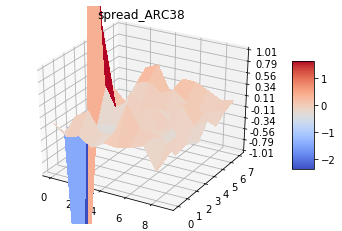

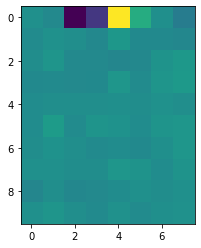

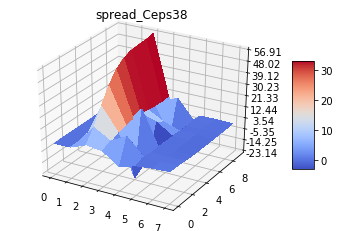

spread_39 Row: 8, Column: 8


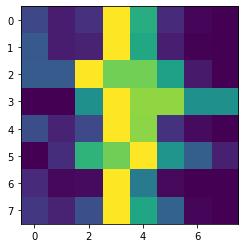

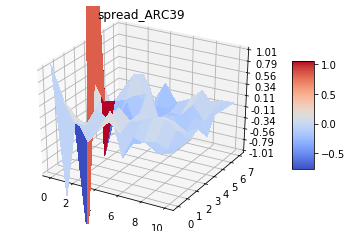

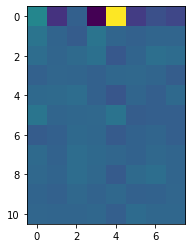

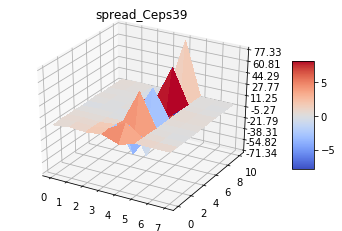

spread_40 Row: 8, Column: 8


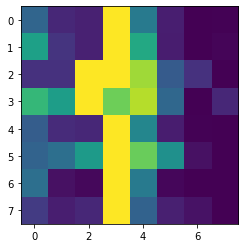

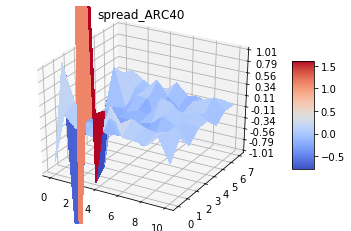

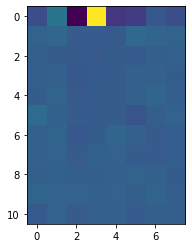

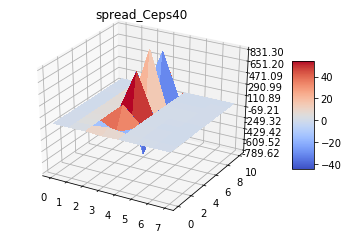

spread_41 Row: 8, Column: 8


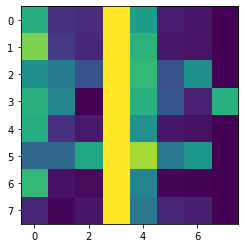

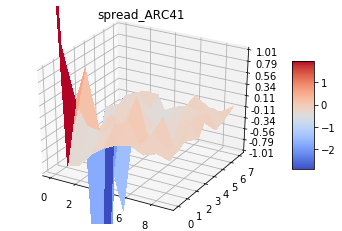

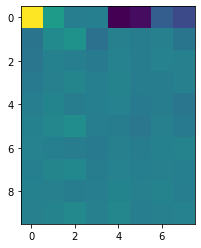

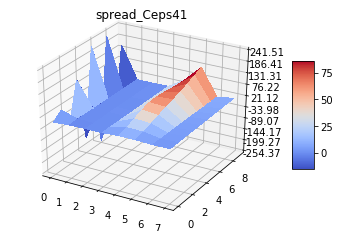

spread_42 Row: 8, Column: 8


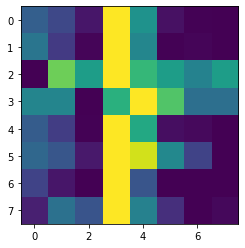

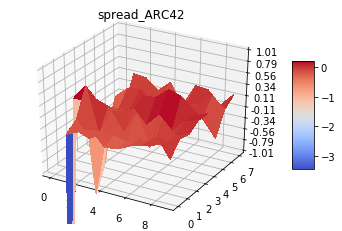

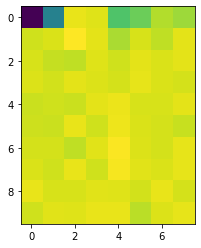

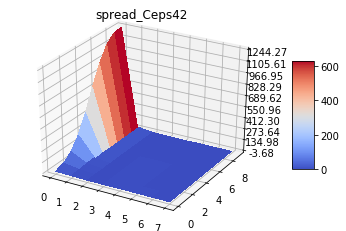

static_1 Row: 8, Column: 8


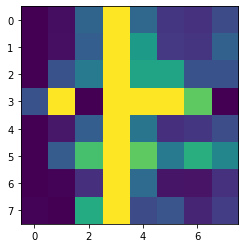

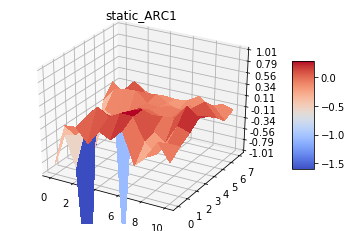

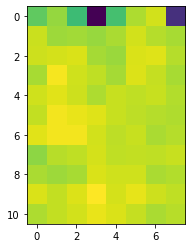

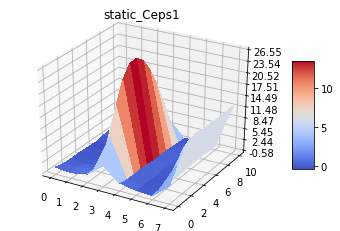

static_2 Row: 8, Column: 8


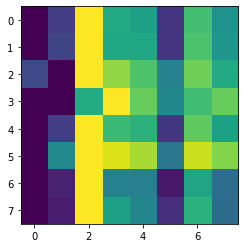

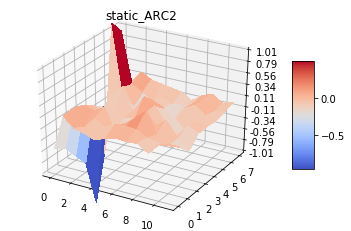

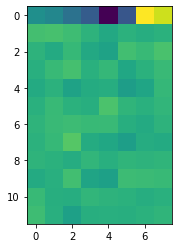

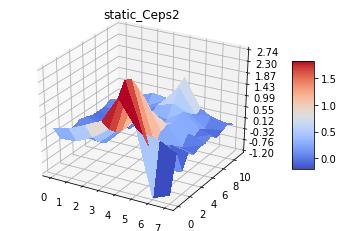

static_3 Row: 8, Column: 8


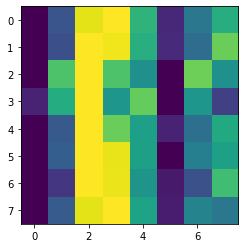

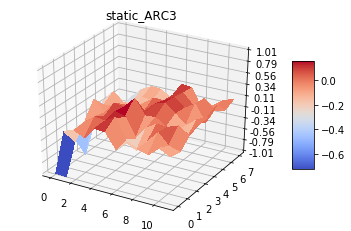

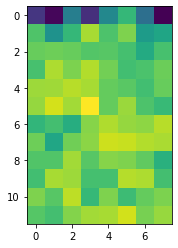

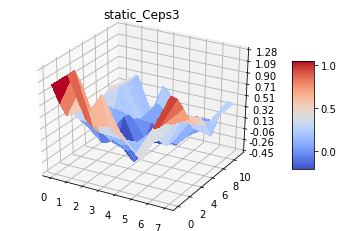

static_4 Row: 8, Column: 8


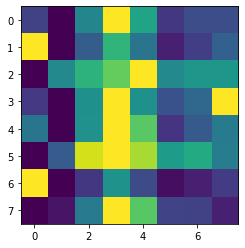

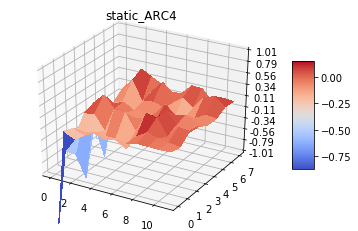

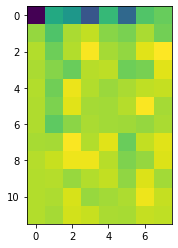

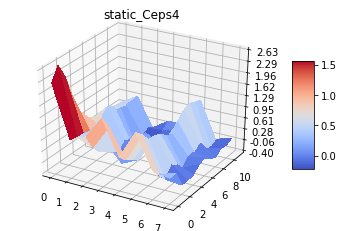

static_5 Row: 8, Column: 8


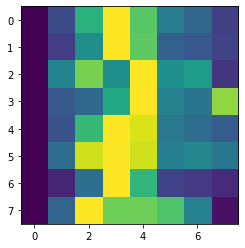

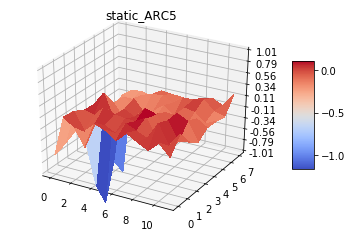

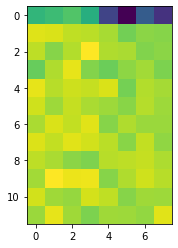

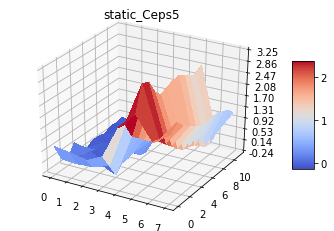

static_6 Row: 8, Column: 8


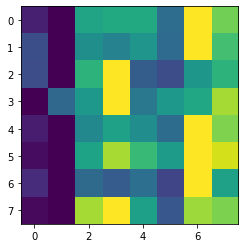

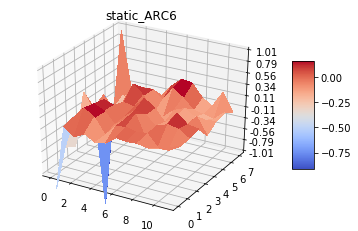

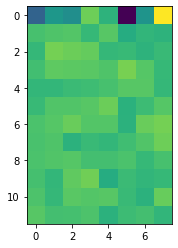

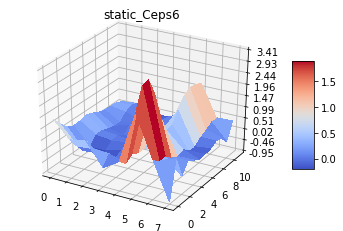

static_7 Row: 8, Column: 8


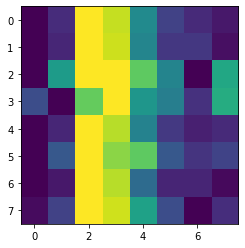

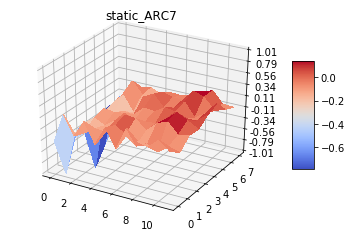

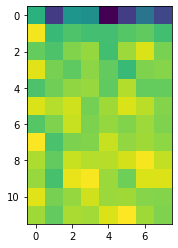

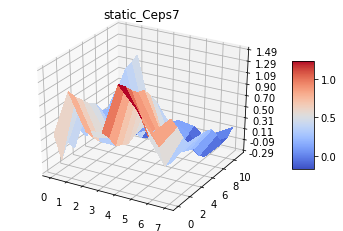

static_8 Row: 8, Column: 8


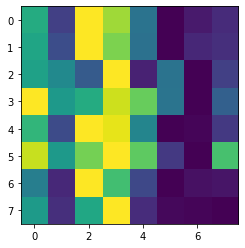

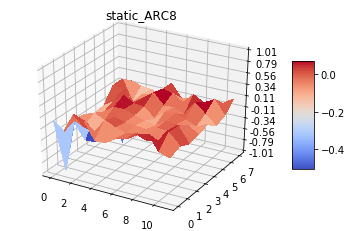

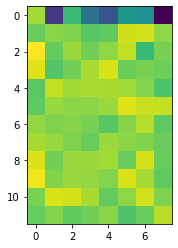

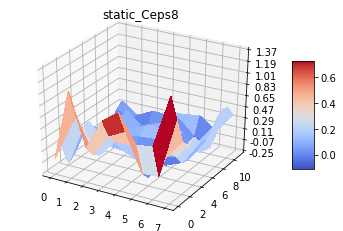

static_9 Row: 8, Column: 8


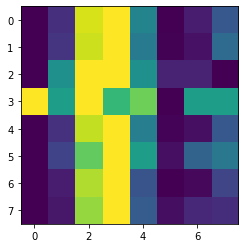

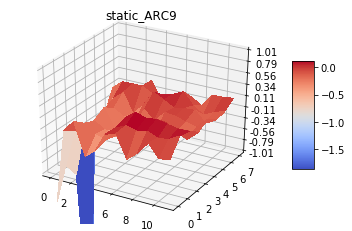

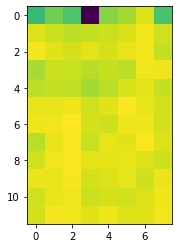

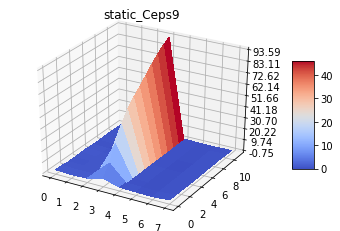

static_10 Row: 8, Column: 8


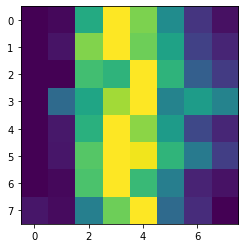

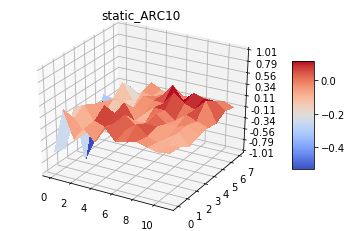

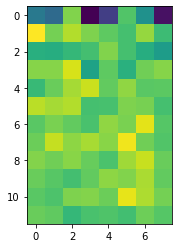

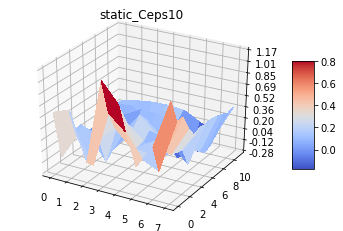

static_11 Row: 8, Column: 8


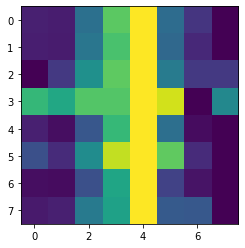

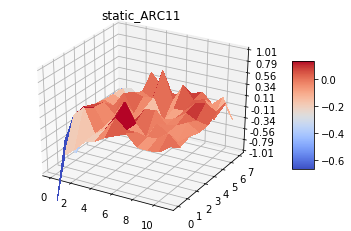

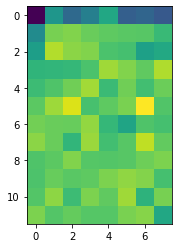

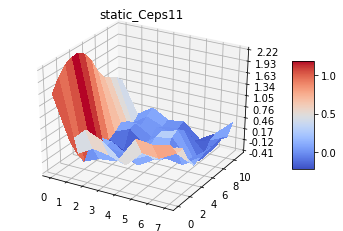

static_12 Row: 8, Column: 8


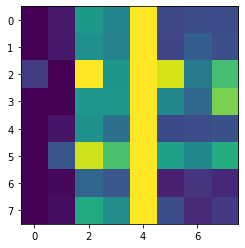

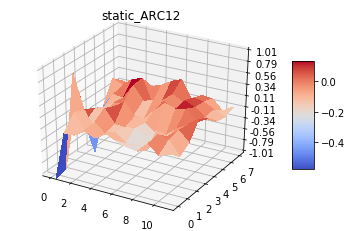

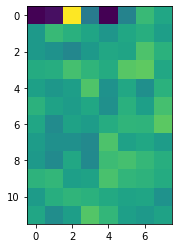

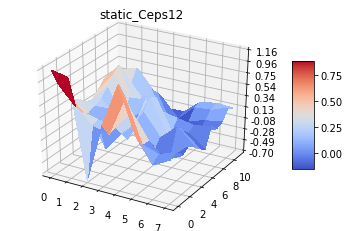

static_13 Row: 8, Column: 8


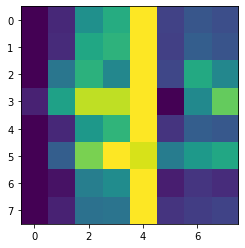

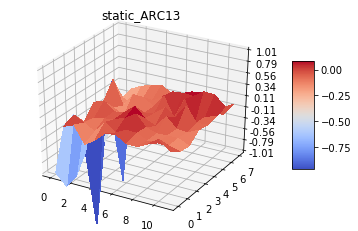

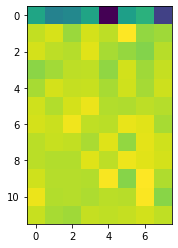

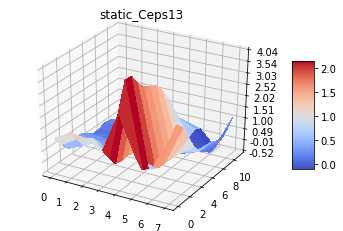

static_14 Row: 8, Column: 8


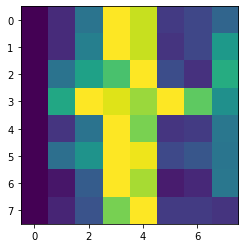

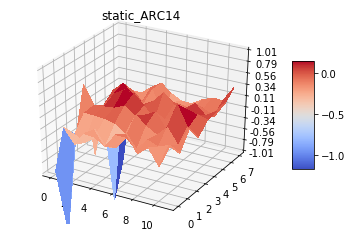

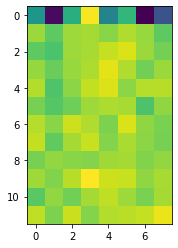

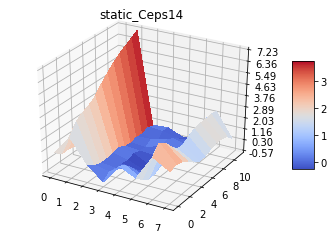

static_15 Row: 8, Column: 8


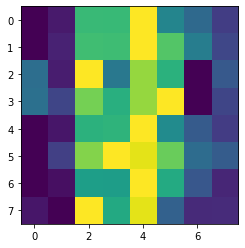

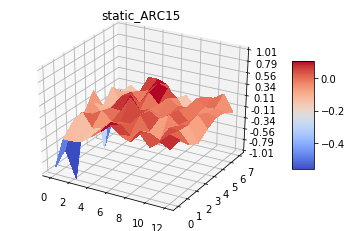

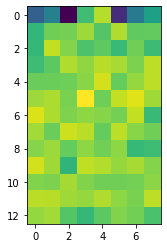

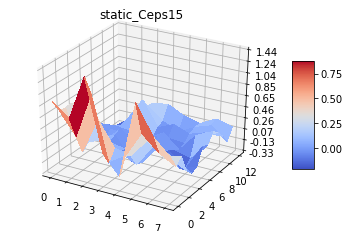

static_16 Row: 8, Column: 8


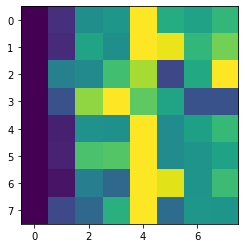

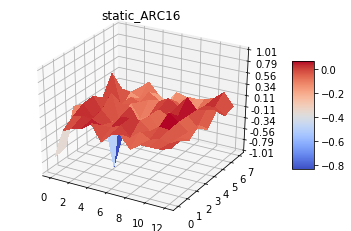

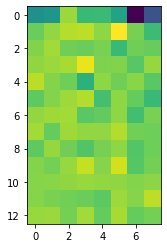

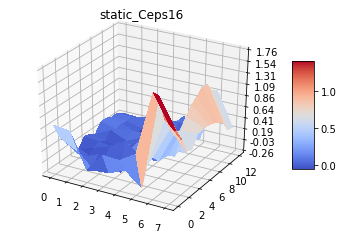

static_17 Row: 8, Column: 8


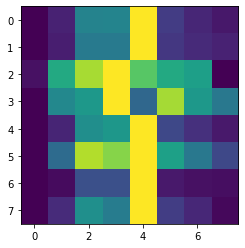

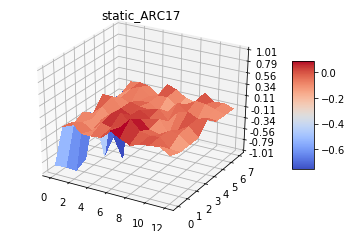

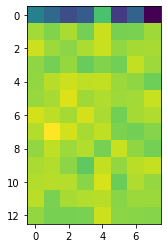

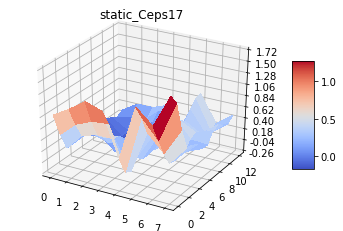

static_18 Row: 8, Column: 8


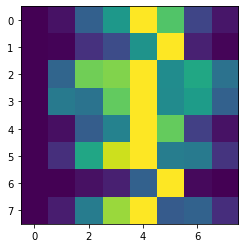

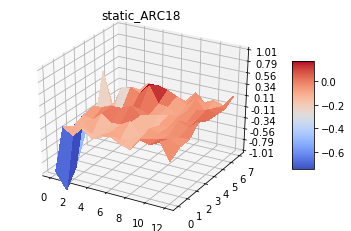

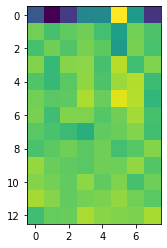

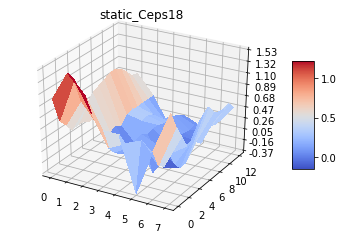

static_19 Row: 8, Column: 8


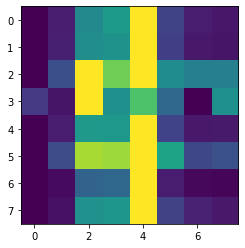

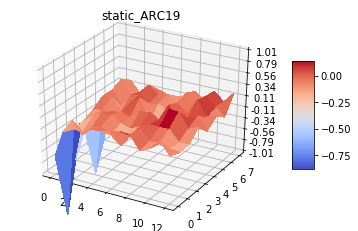

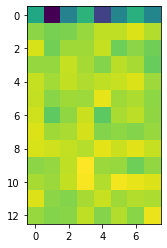

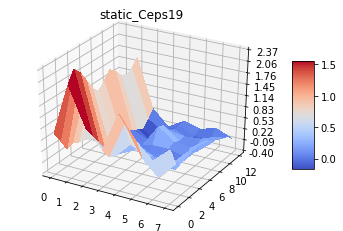

static_20 Row: 8, Column: 8


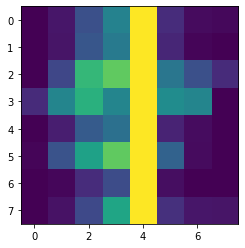

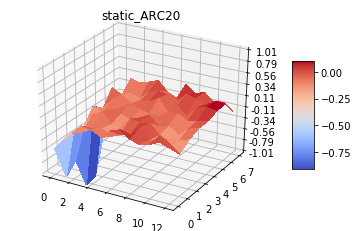

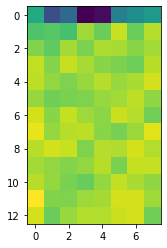

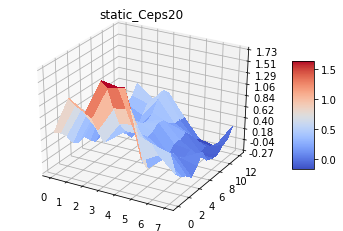

static_21 Row: 8, Column: 8


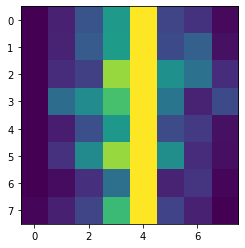

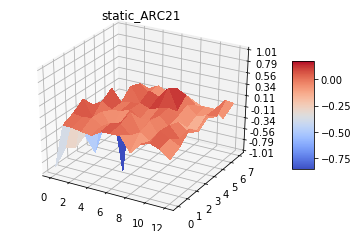

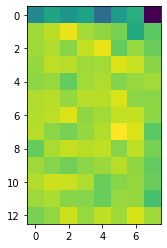

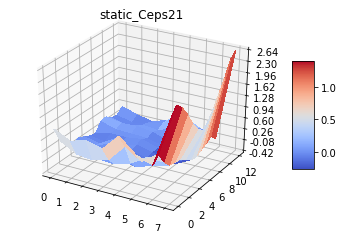

static_22 Row: 8, Column: 8


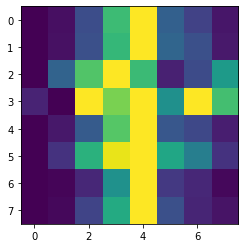

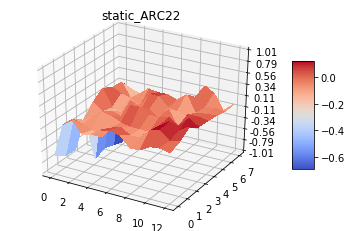

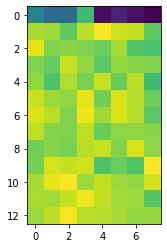

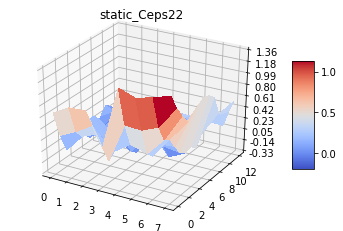

static_23 Row: 8, Column: 8


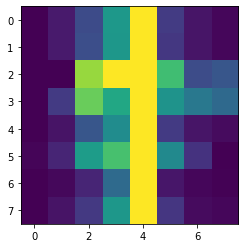

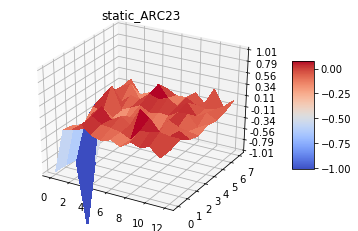

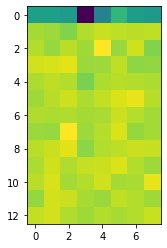

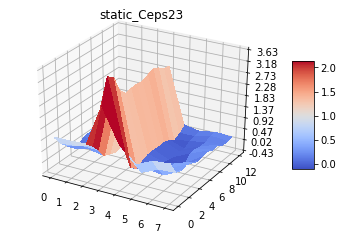

static_24 Row: 8, Column: 8


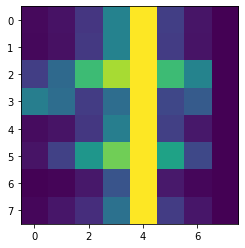

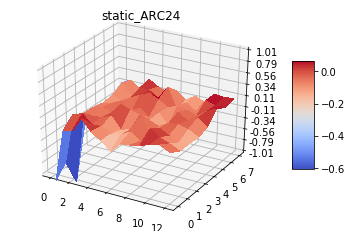

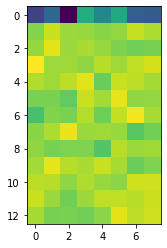

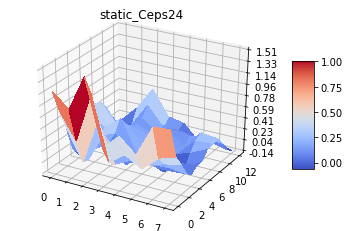

static_25 Row: 8, Column: 8


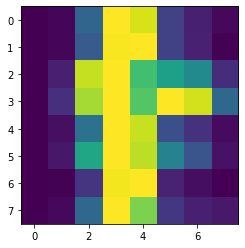

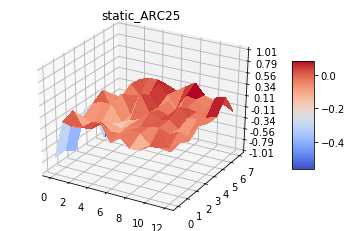

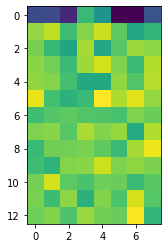

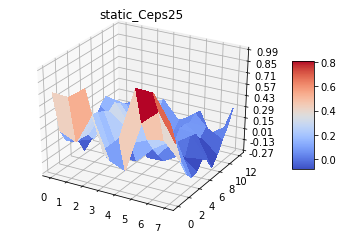

static_26 Row: 8, Column: 8


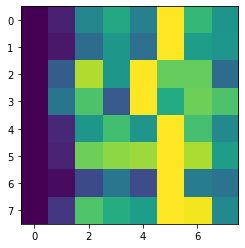

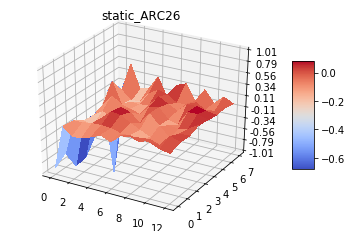

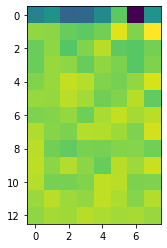

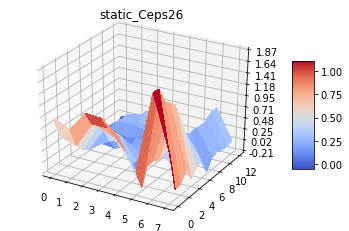

static_27 Row: 8, Column: 8


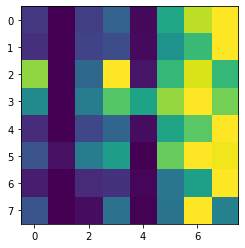

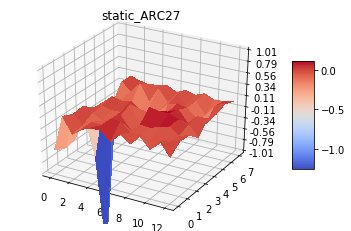

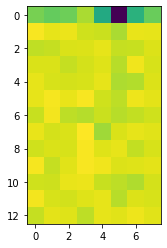

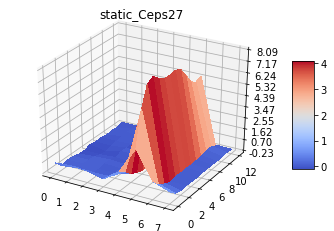

static_28 Row: 8, Column: 8


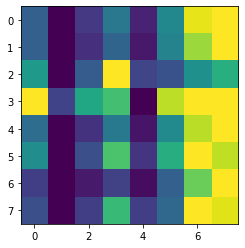

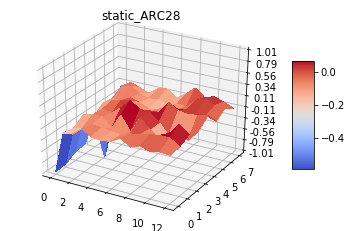

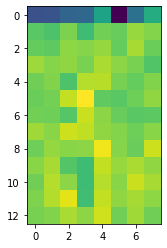

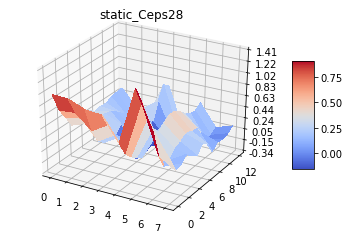

static_29 Row: 8, Column: 8


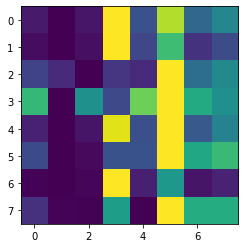

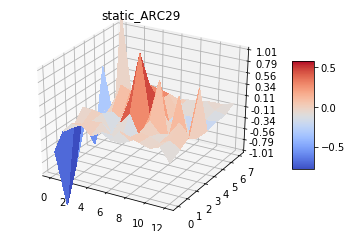

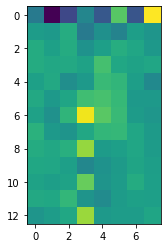

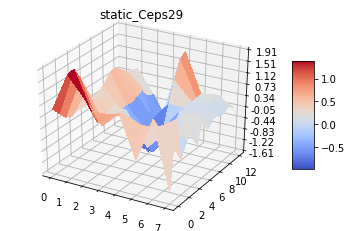

static_30 Row: 8, Column: 8


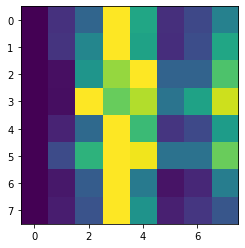

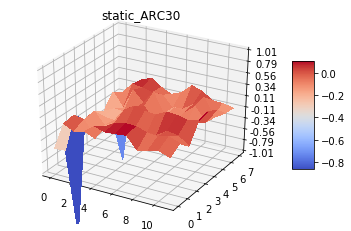

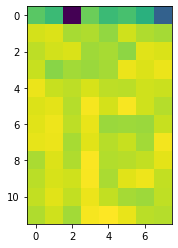

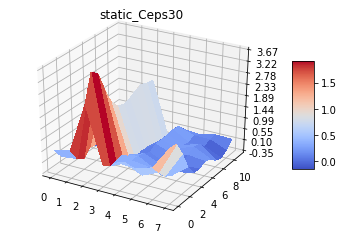

static_31 Row: 8, Column: 8


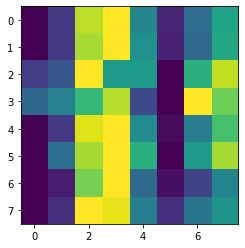

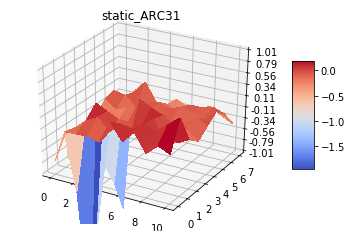

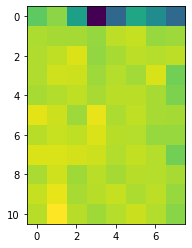

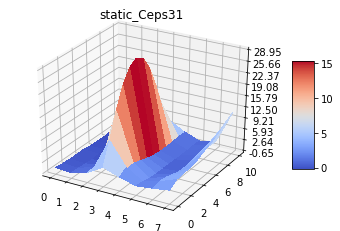

static_32 Row: 8, Column: 8


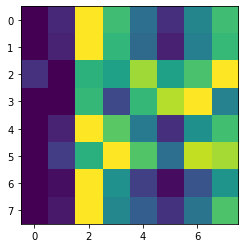

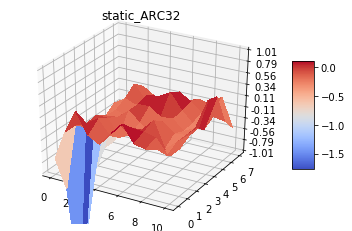

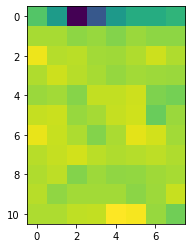

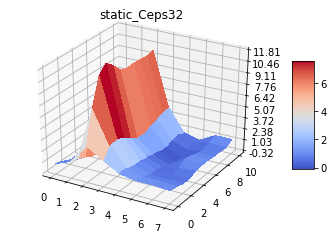

static_33 Row: 8, Column: 8


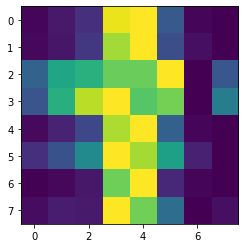

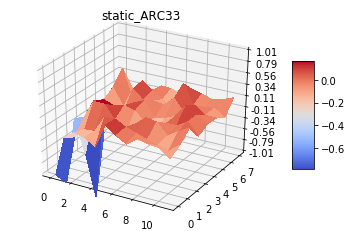

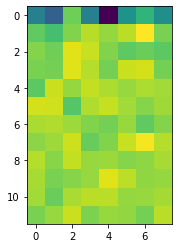

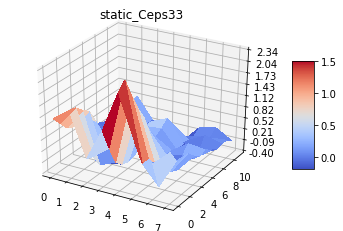

static_34 Row: 8, Column: 8


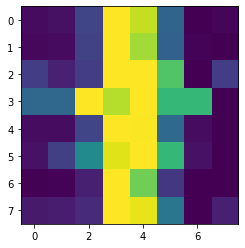

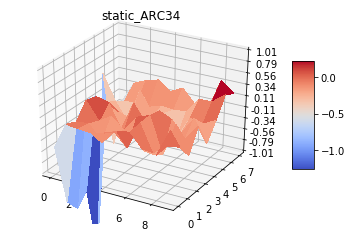

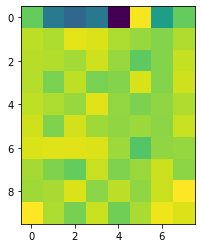

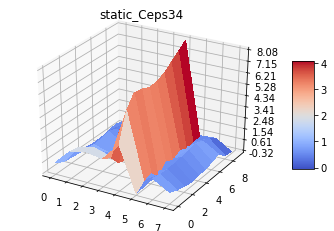

static_35 Row: 8, Column: 8


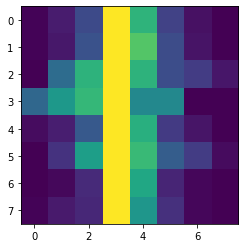

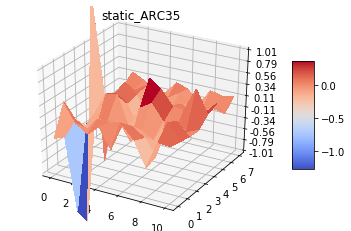

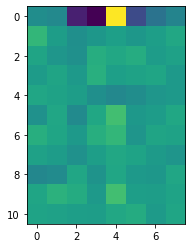

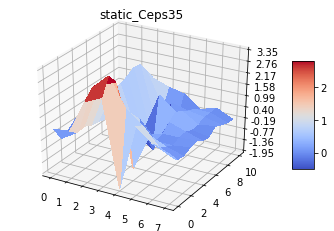

static_36 Row: 8, Column: 8


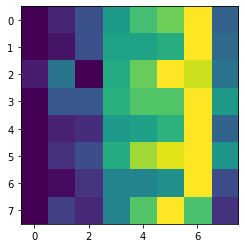

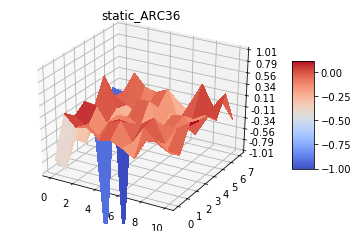

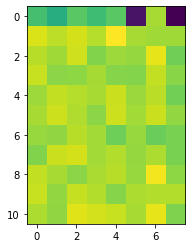

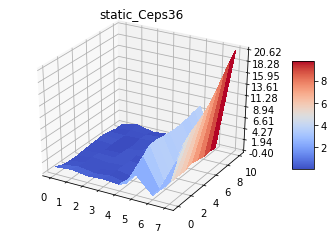

static_37 Row: 8, Column: 8


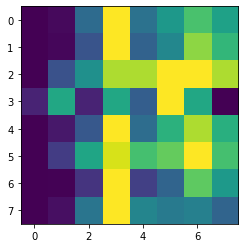

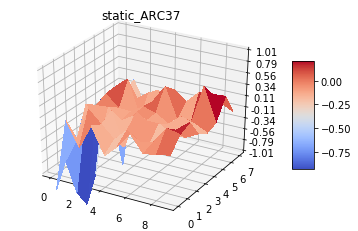

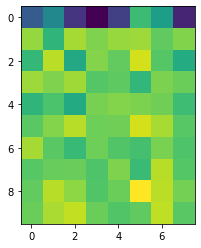

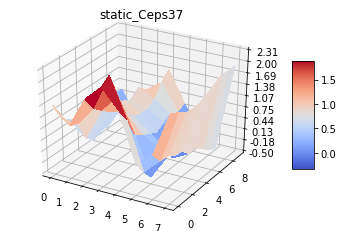

static_38 Row: 8, Column: 8


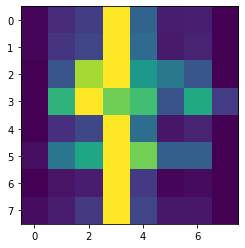

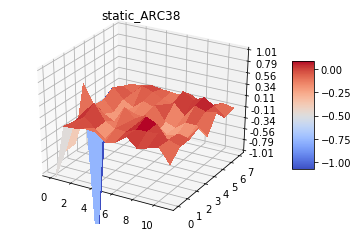

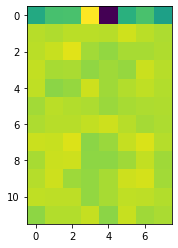

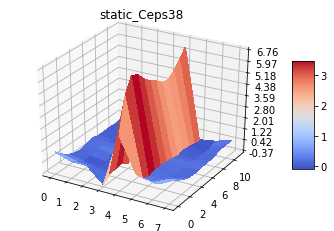

static_39 Row: 8, Column: 8


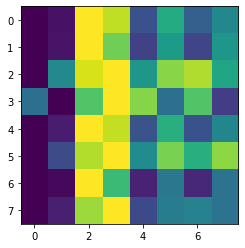

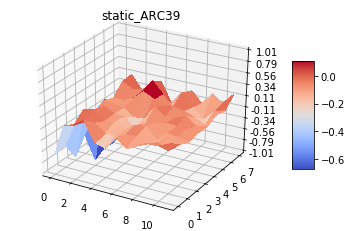

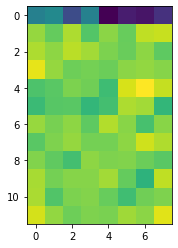

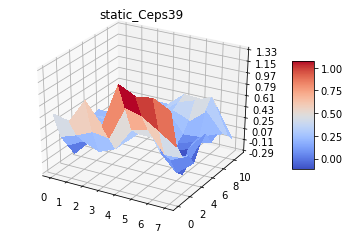

static_40 Row: 8, Column: 8


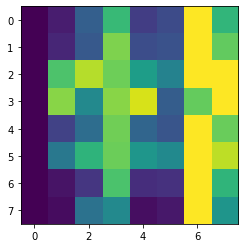

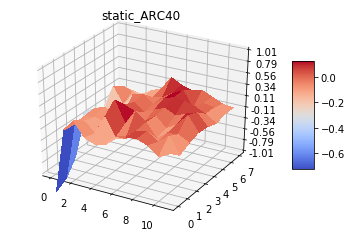

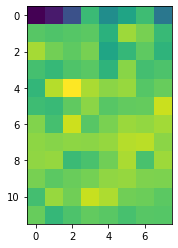

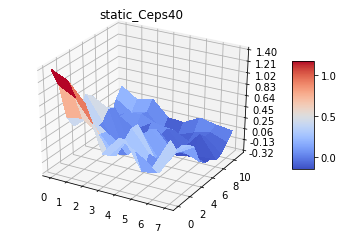

static_41 Row: 8, Column: 8


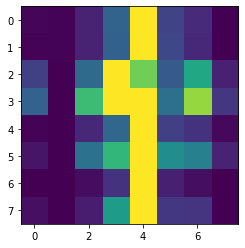

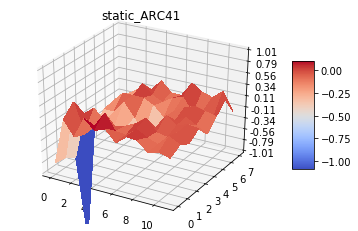

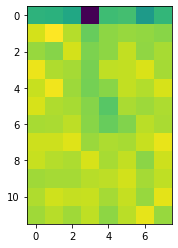

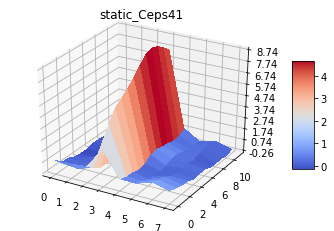

static_42 Row: 8, Column: 8


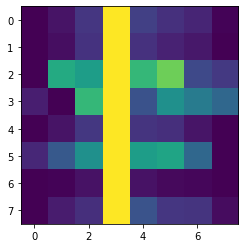

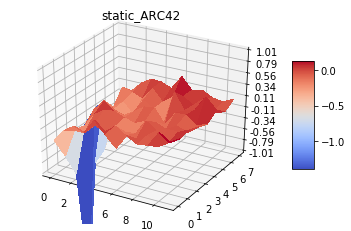

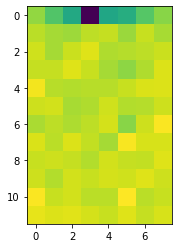

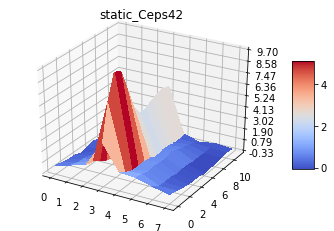

wavein_1 Row: 8, Column: 8


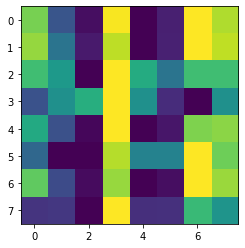

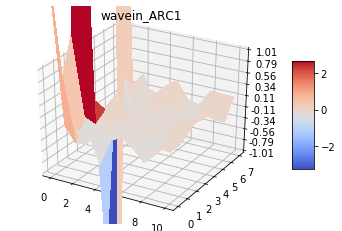

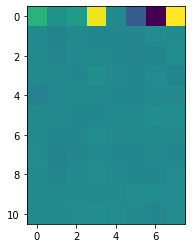

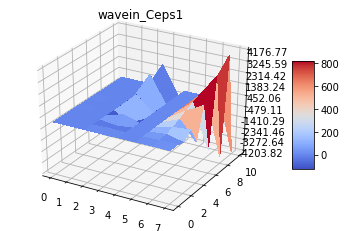

wavein_2 Row: 8, Column: 8


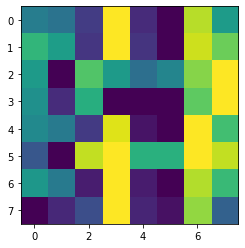

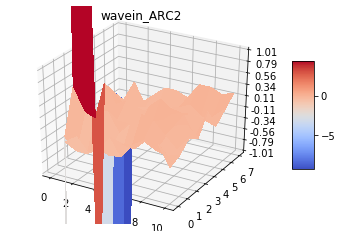

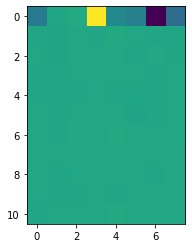

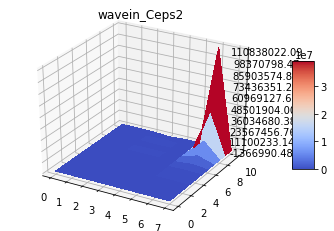

wavein_3 Row: 8, Column: 8


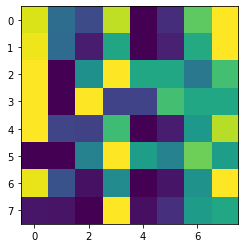

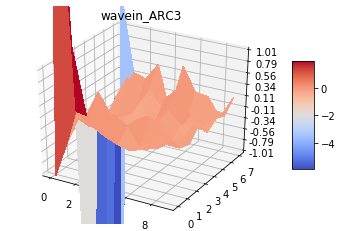

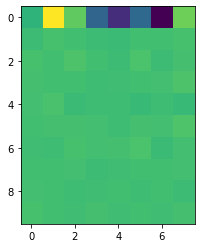

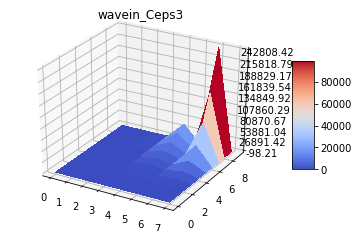

wavein_4 Row: 8, Column: 8


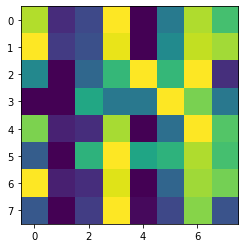

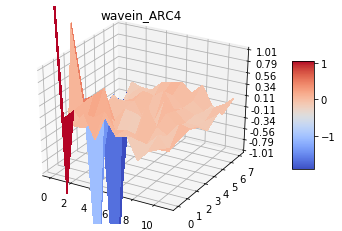

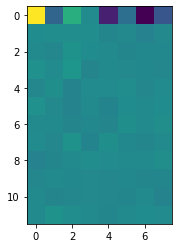

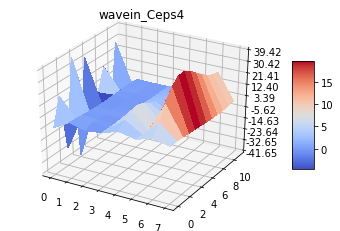

wavein_5 Row: 8, Column: 8


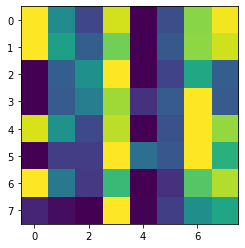

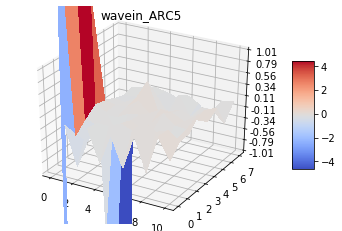

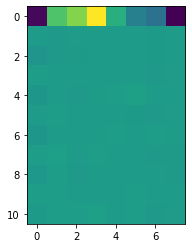

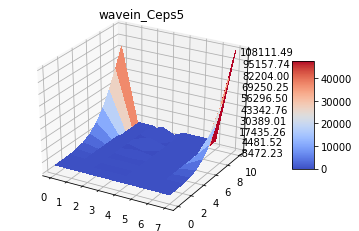

wavein_6 Row: 8, Column: 8


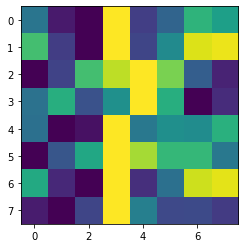

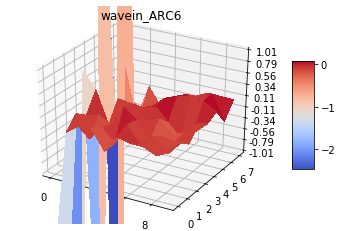

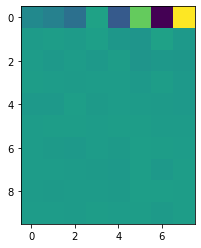

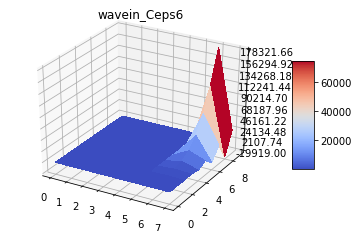

wavein_7 Row: 8, Column: 8


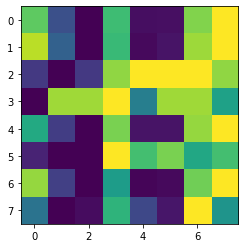

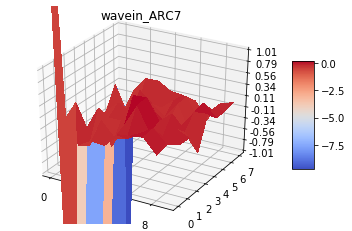

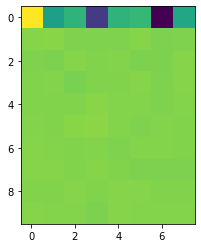

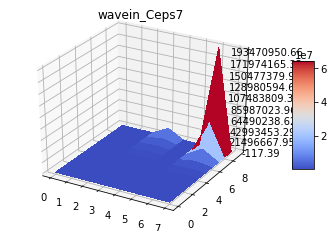

wavein_8 Row: 8, Column: 8


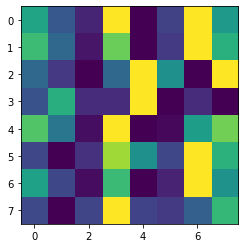

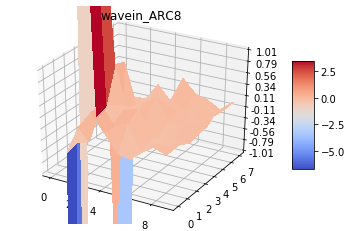

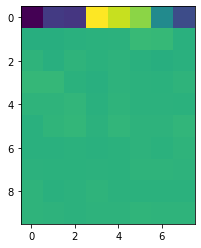

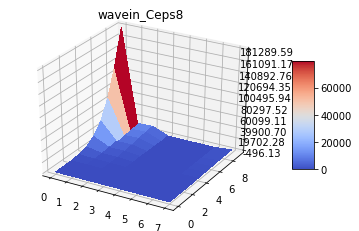

wavein_9 Row: 8, Column: 8


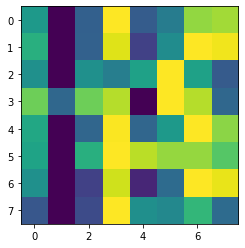

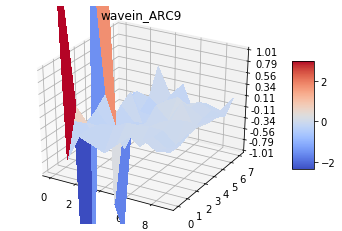

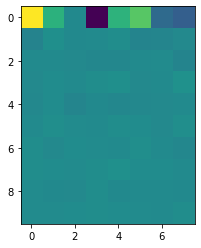

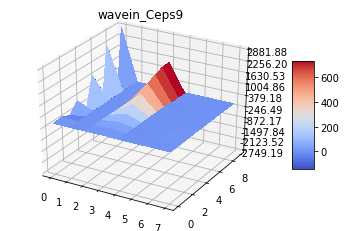

wavein_10 Row: 8, Column: 8


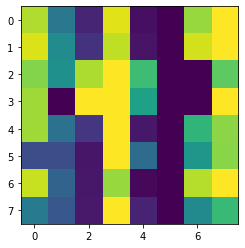

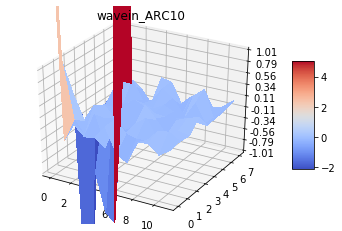

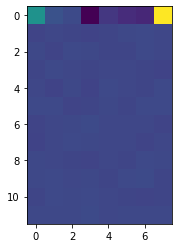

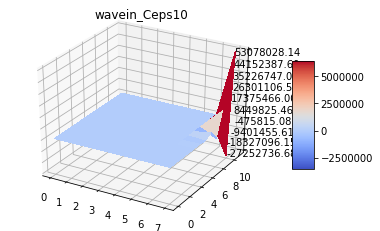

wavein_11 Row: 8, Column: 8


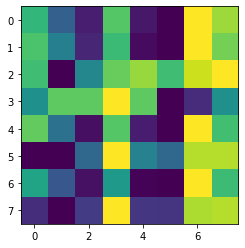

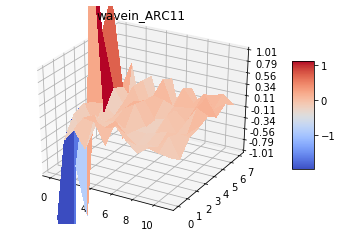

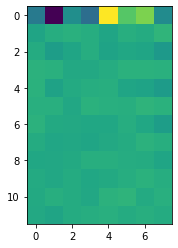

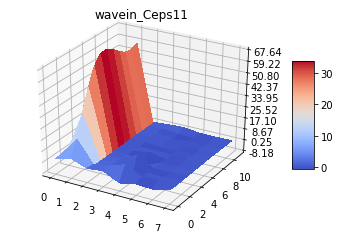

wavein_12 Row: 8, Column: 8


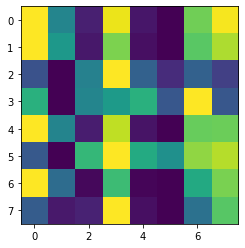

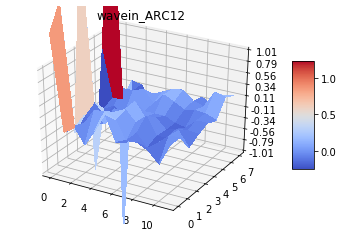

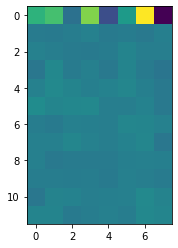

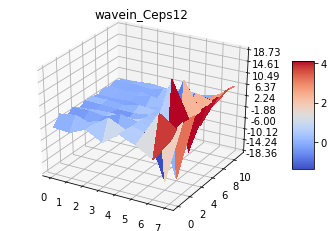

wavein_13 Row: 8, Column: 8


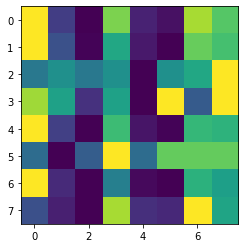

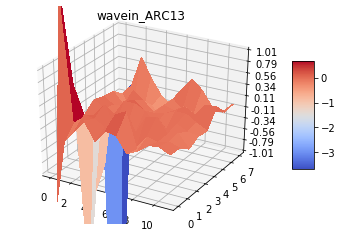

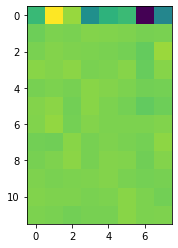

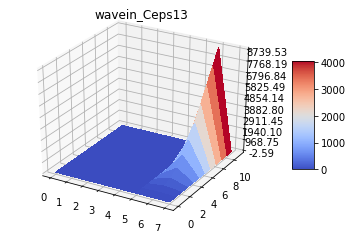

wavein_14 Row: 8, Column: 8


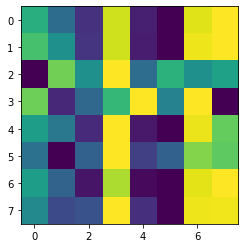

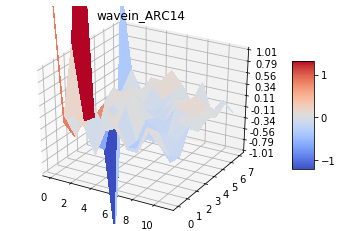

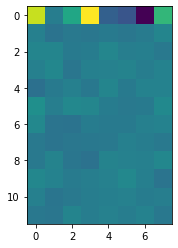

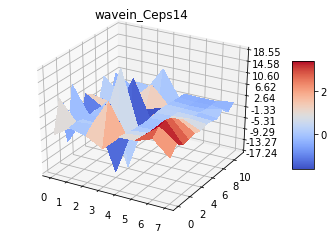

wavein_15 Row: 8, Column: 8


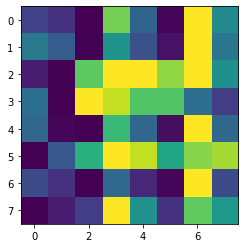

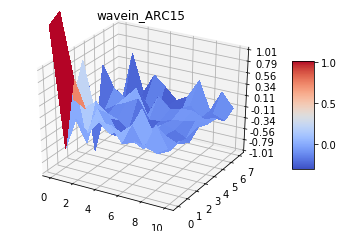

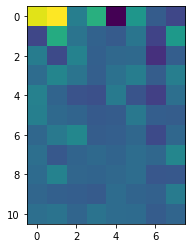

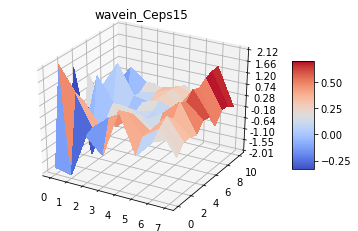

wavein_16 Row: 8, Column: 8


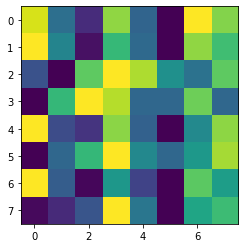

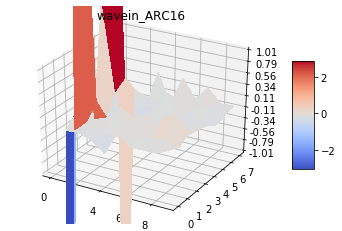

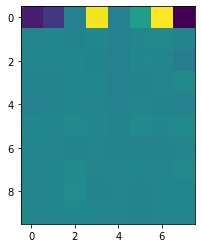

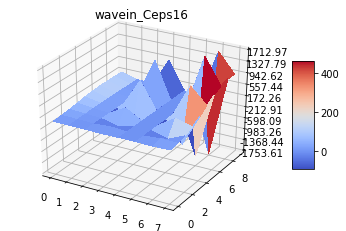

wavein_17 Row: 8, Column: 8


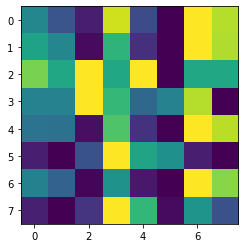

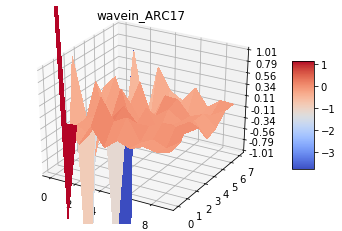

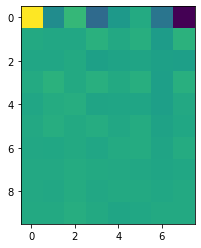

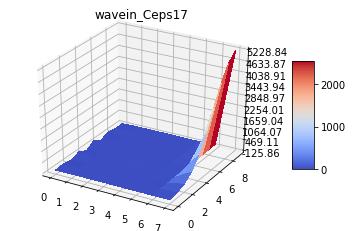

wavein_18 Row: 8, Column: 8


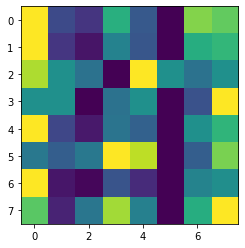

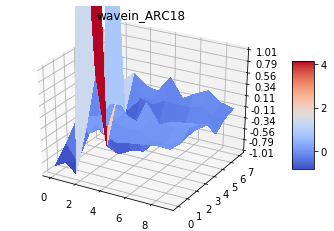

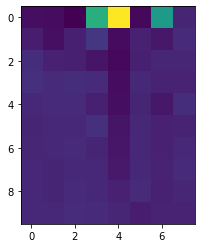

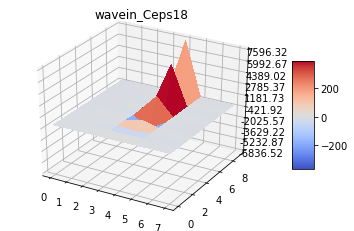

wavein_19 Row: 8, Column: 8


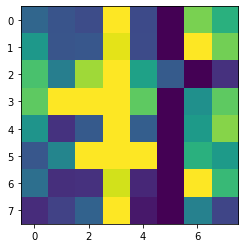

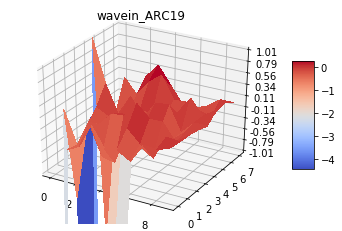

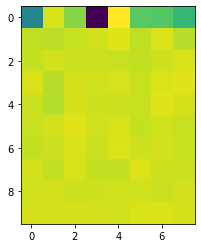

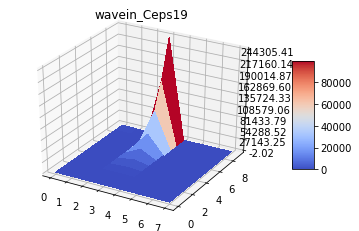

wavein_20 Row: 8, Column: 8


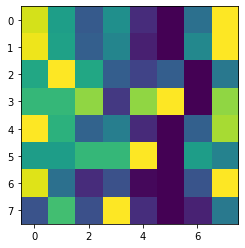

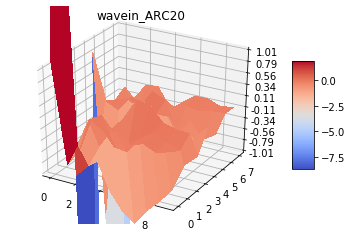

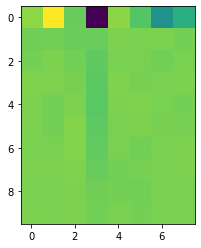

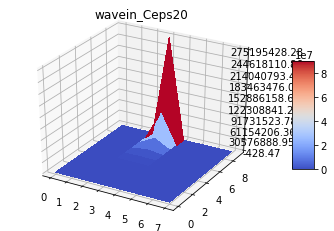

wavein_21 Row: 8, Column: 8


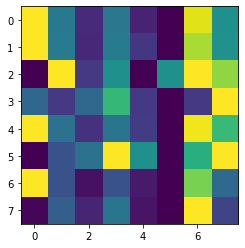

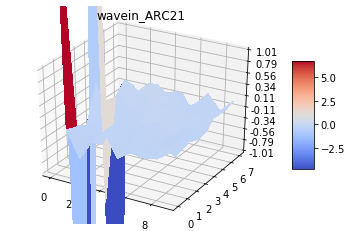

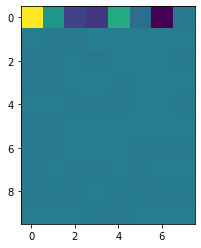

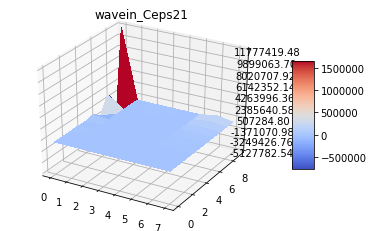

wavein_22 Row: 8, Column: 8


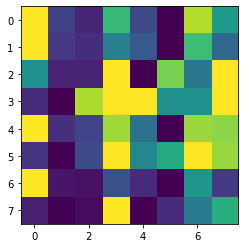

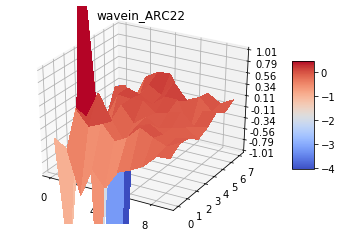

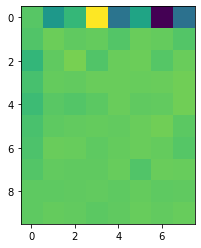

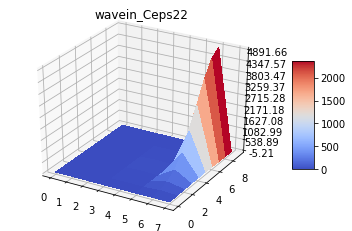

wavein_23 Row: 8, Column: 8


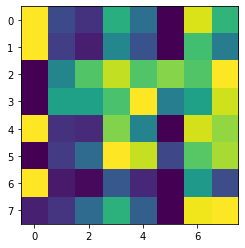

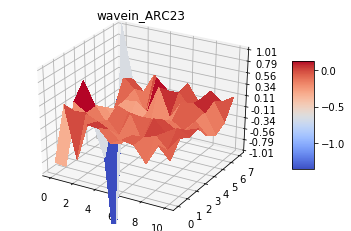

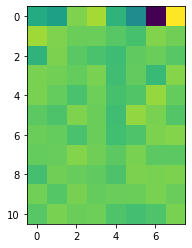

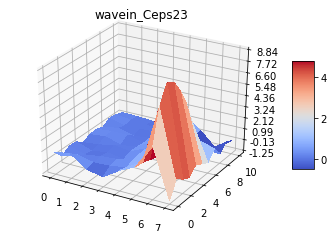

wavein_24 Row: 8, Column: 8


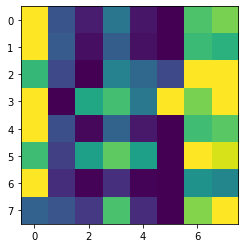

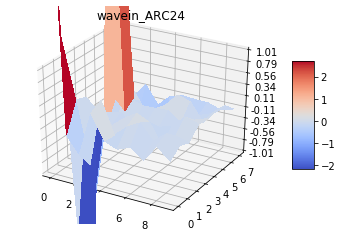

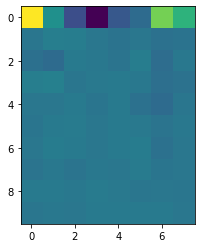

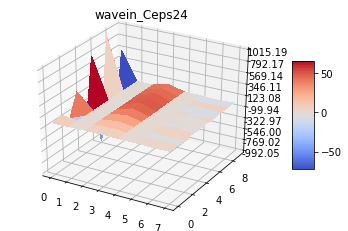

wavein_25 Row: 8, Column: 8


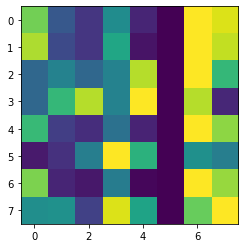

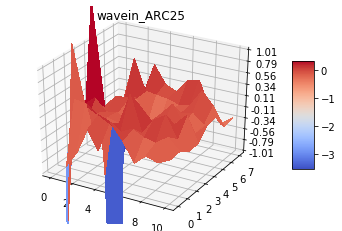

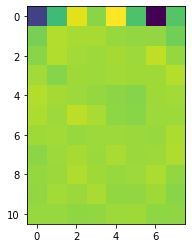

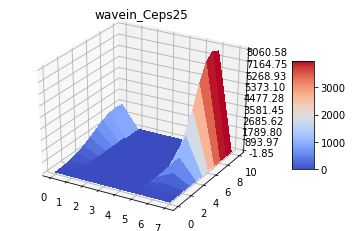

wavein_26 Row: 8, Column: 8


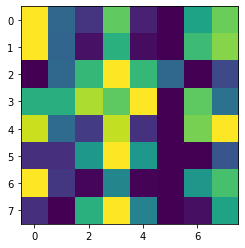

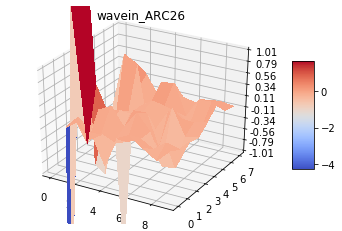

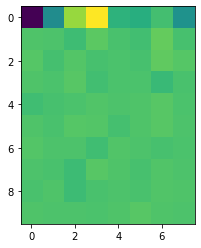

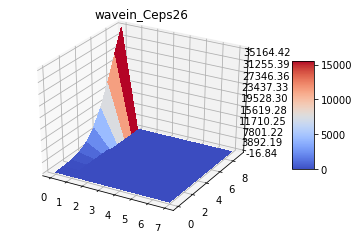

wavein_27 Row: 8, Column: 8


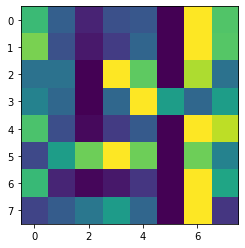

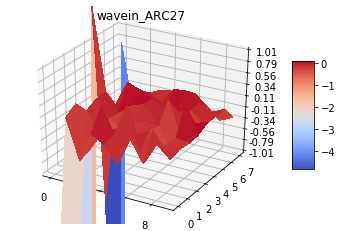

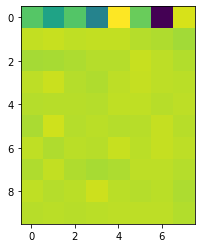

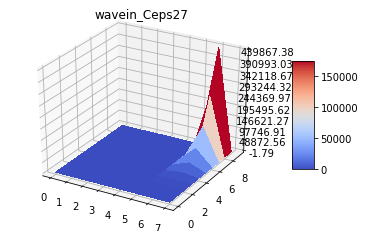

wavein_28 Row: 8, Column: 8


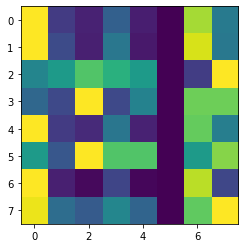

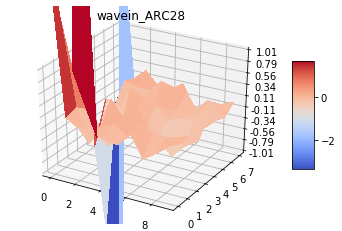

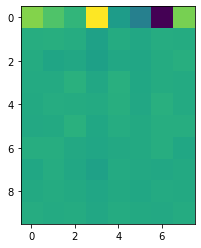

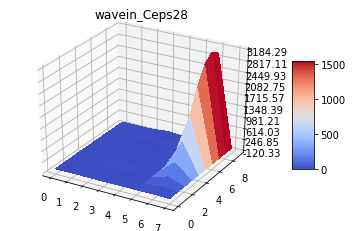

wavein_29 Row: 8, Column: 8


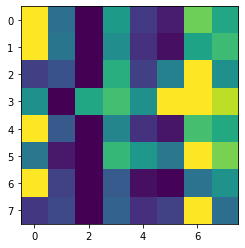

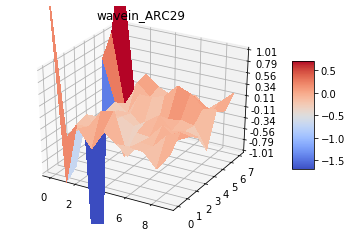

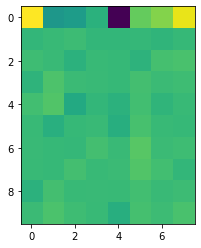

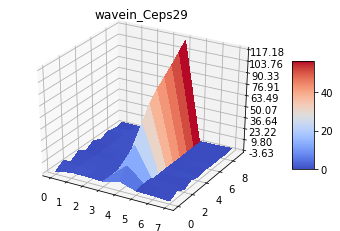

wavein_30 Row: 8, Column: 8


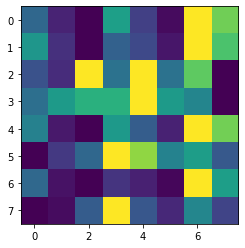

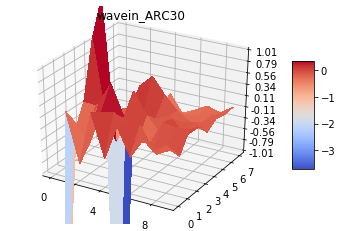

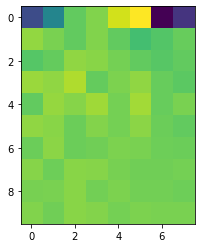

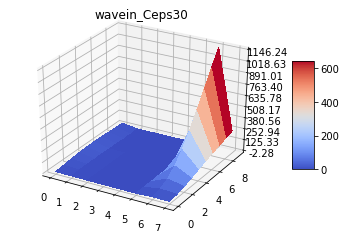

wavein_31 Row: 8, Column: 8


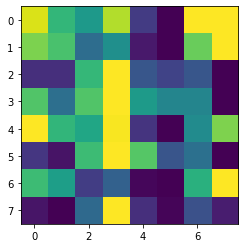

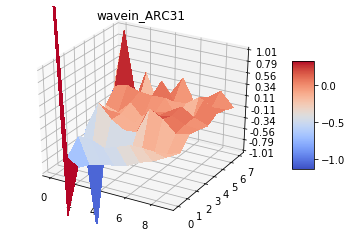

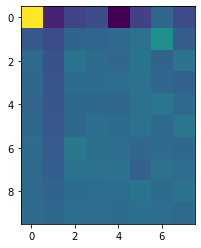

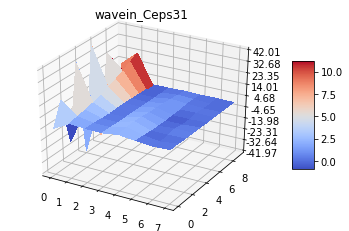

wavein_32 Row: 8, Column: 8


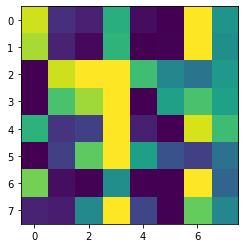

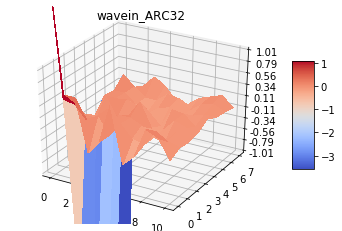

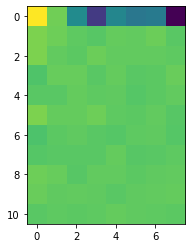

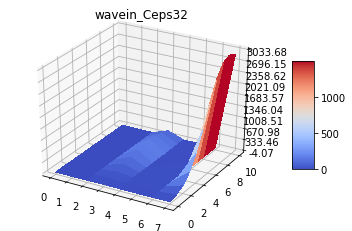

wavein_33 Row: 8, Column: 8


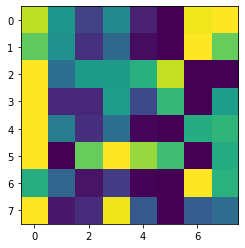

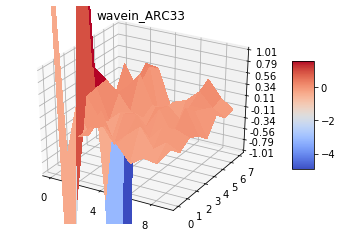

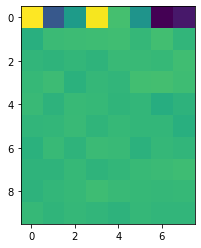

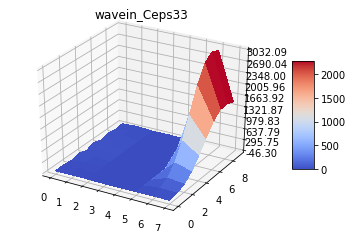

wavein_34 Row: 8, Column: 8


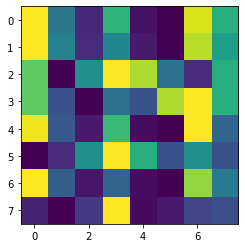

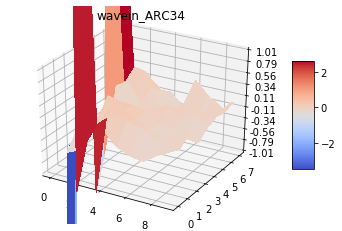

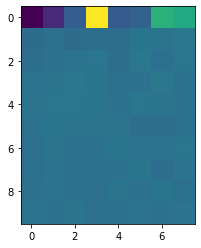

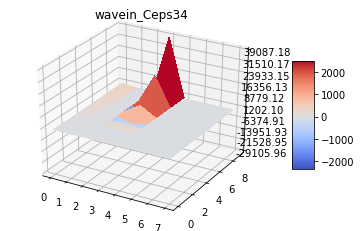

wavein_35 Row: 8, Column: 8


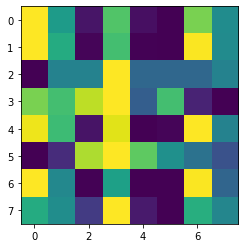

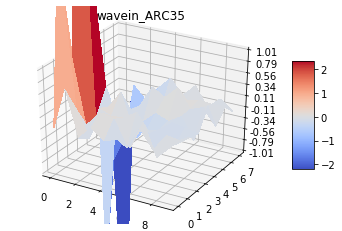

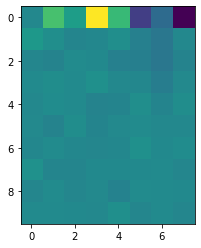

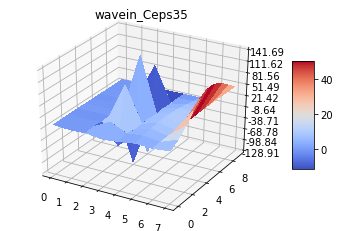

wavein_36 Row: 8, Column: 8


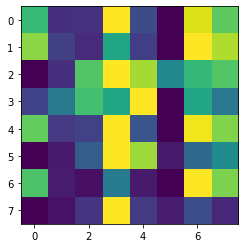

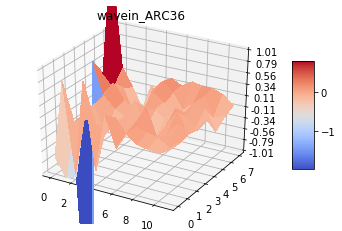

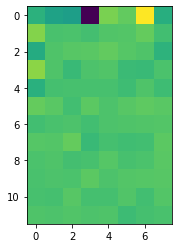

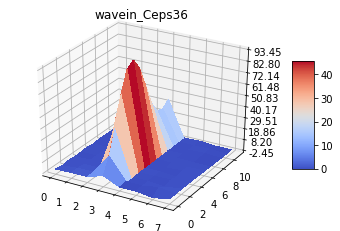

wavein_37 Row: 8, Column: 8


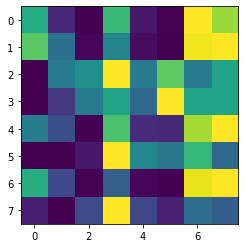

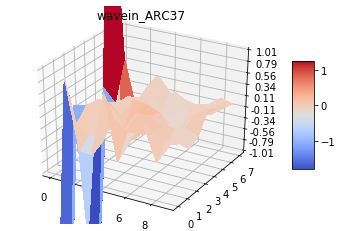

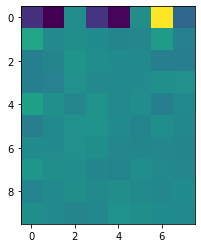

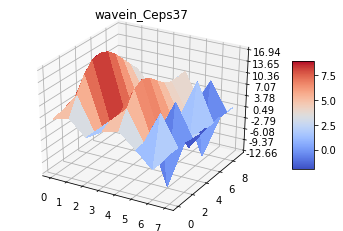

wavein_38 Row: 8, Column: 8


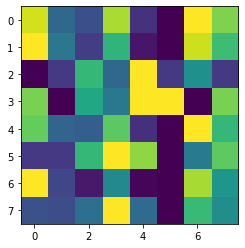

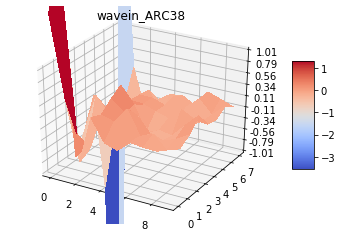

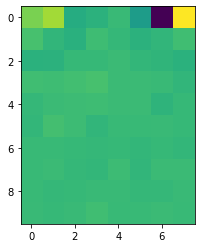

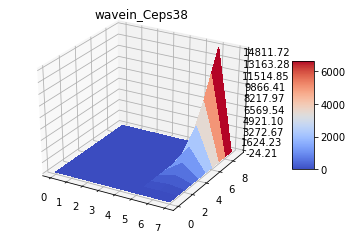

wavein_39 Row: 8, Column: 8


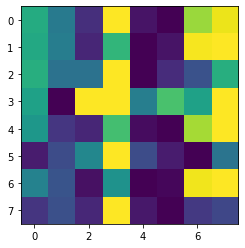

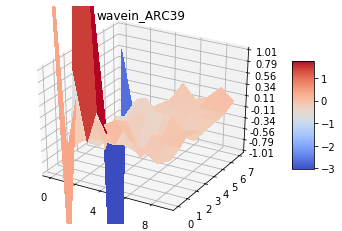

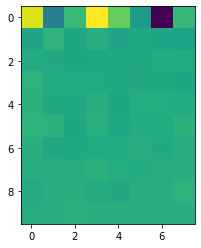

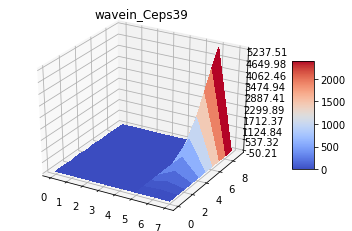

wavein_40 Row: 8, Column: 8


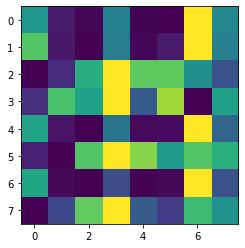

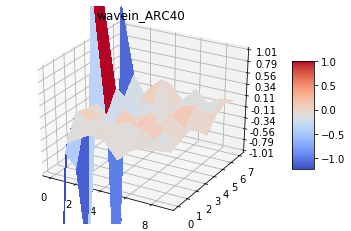

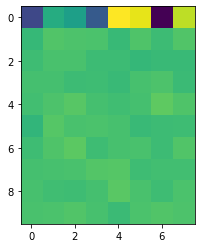

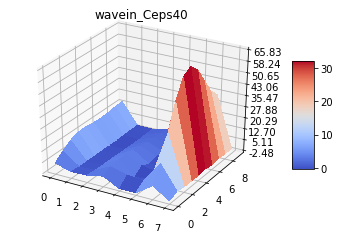

wavein_41 Row: 8, Column: 8


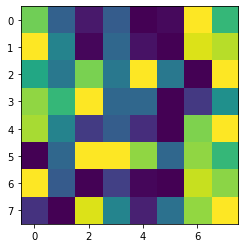

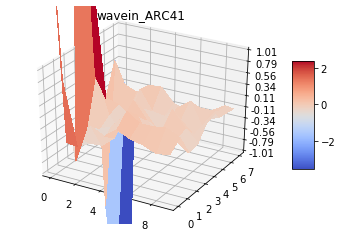

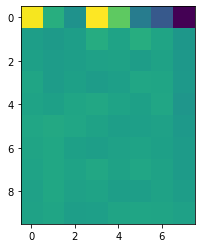

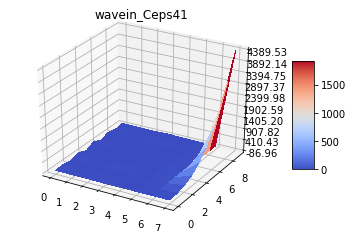

wavein_42 Row: 8, Column: 8


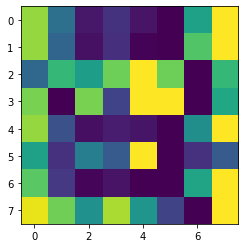

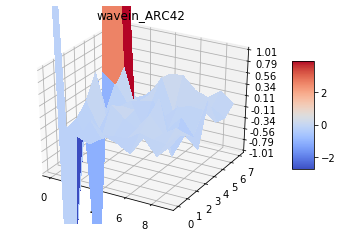

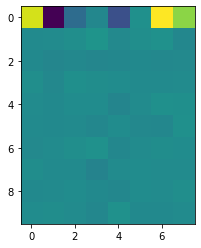

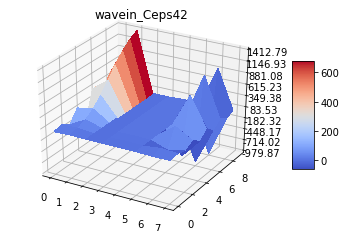

waveout_1 Row: 8, Column: 8


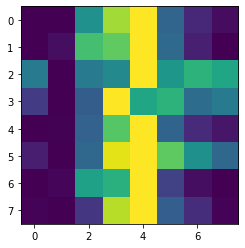

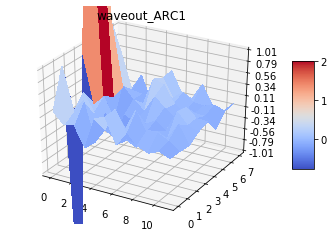

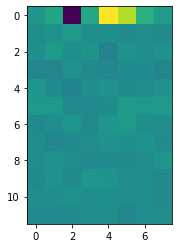

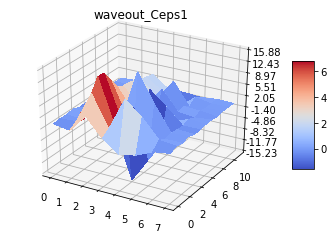

waveout_2 Row: 8, Column: 8


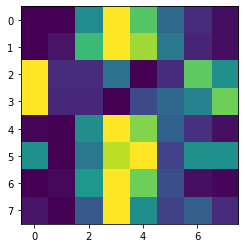

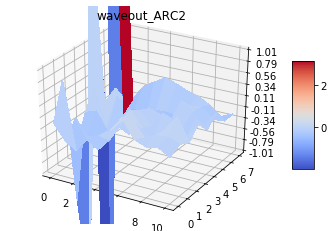

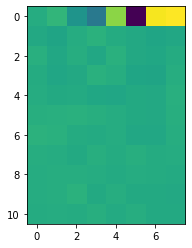

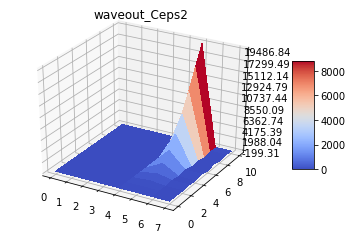

waveout_3 Row: 8, Column: 8


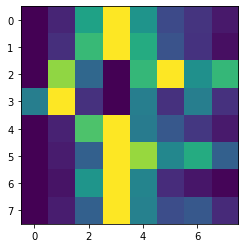

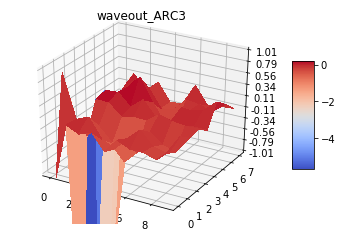

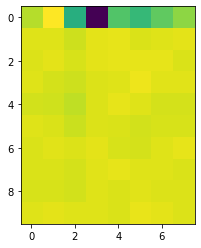

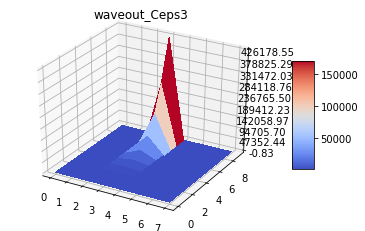

waveout_4 Row: 8, Column: 8


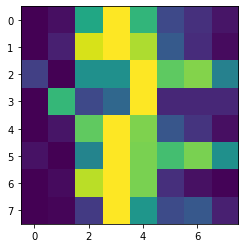

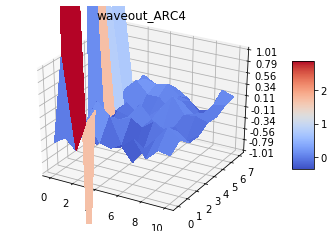

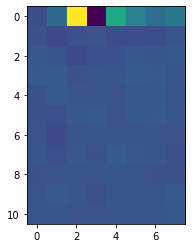

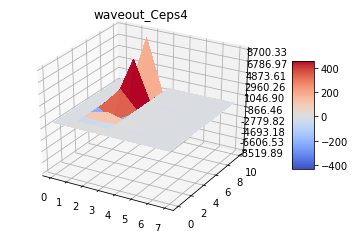

waveout_5 Row: 8, Column: 8


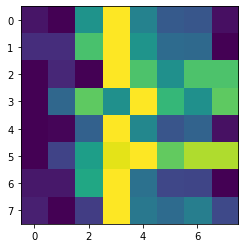

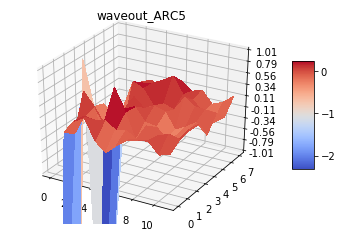

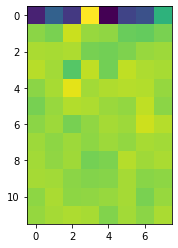

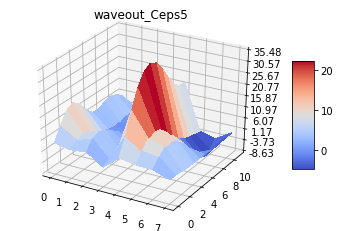

waveout_6 Row: 8, Column: 8


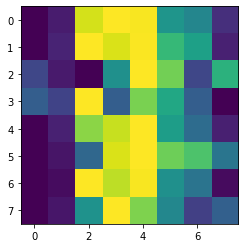

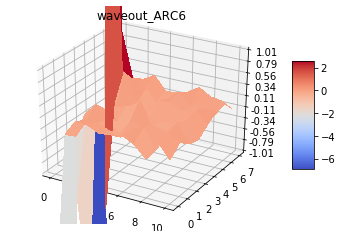

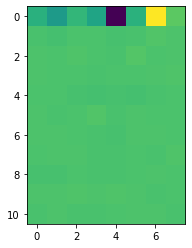

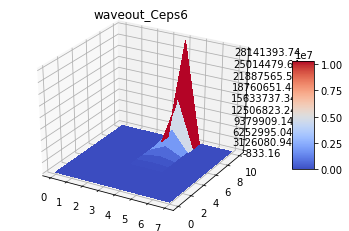

waveout_7 Row: 8, Column: 8


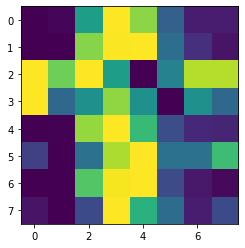

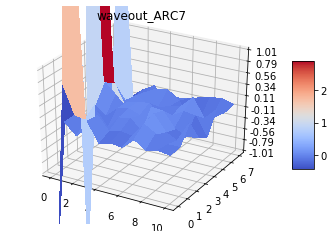

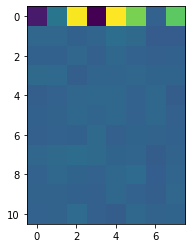

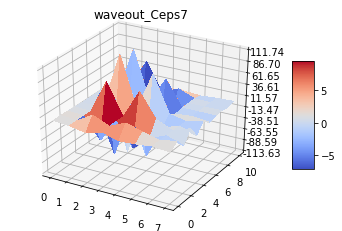

waveout_8 Row: 8, Column: 8


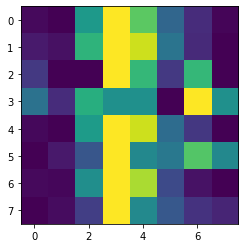

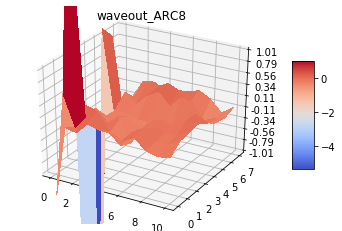

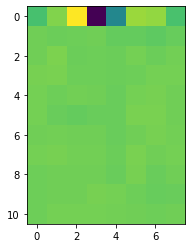

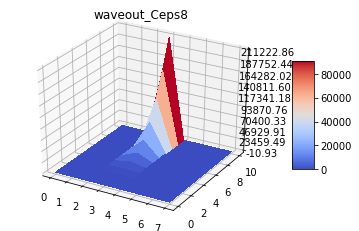

waveout_9 Row: 8, Column: 8


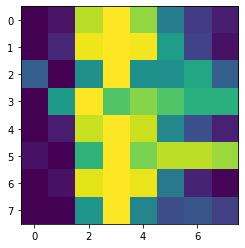

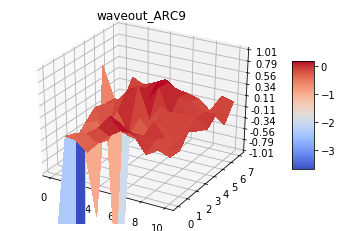

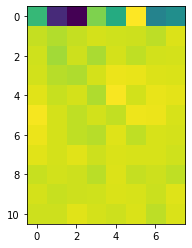

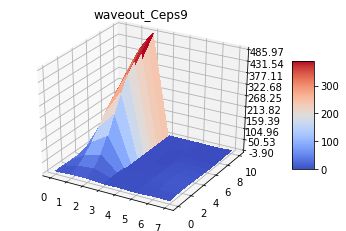

waveout_10 Row: 8, Column: 8


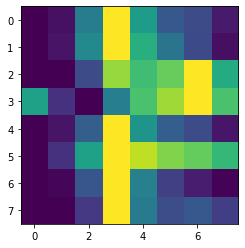

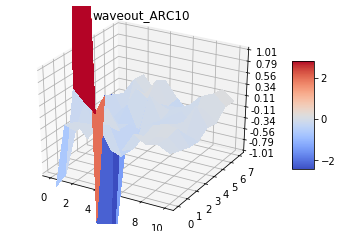

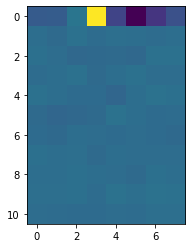

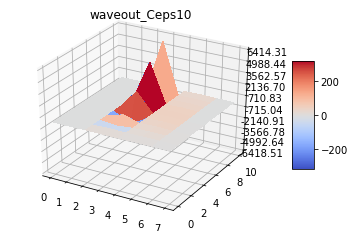

waveout_11 Row: 8, Column: 8


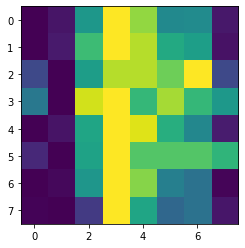

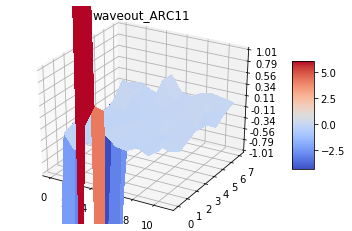

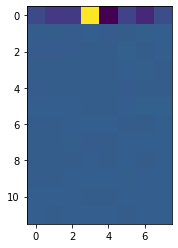

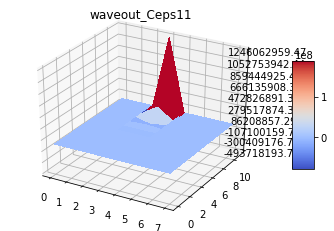

waveout_12 Row: 8, Column: 8


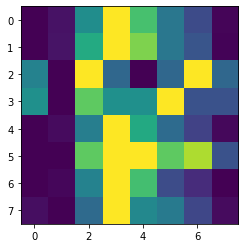

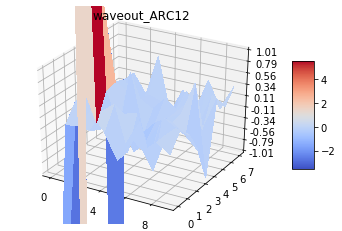

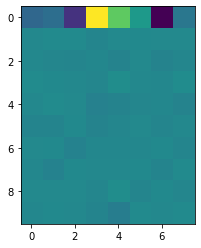

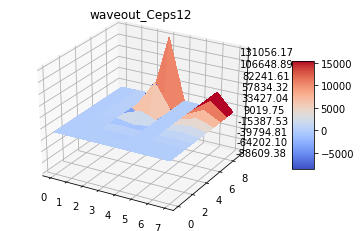

waveout_13 Row: 8, Column: 8


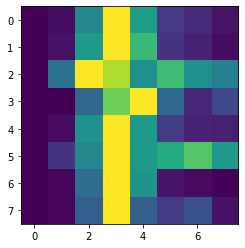

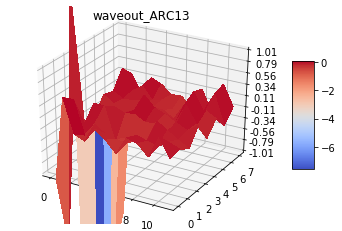

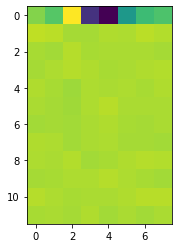

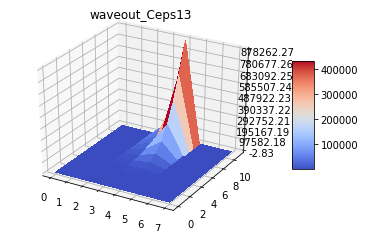

waveout_14 Row: 8, Column: 8


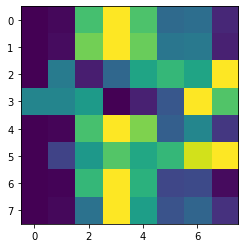

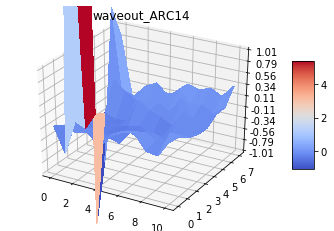

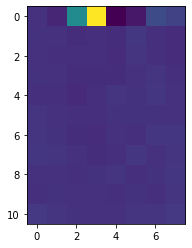

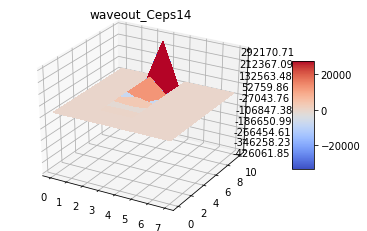

waveout_15 Row: 8, Column: 8


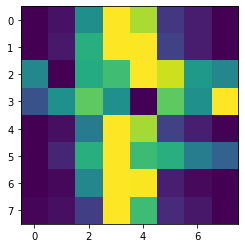

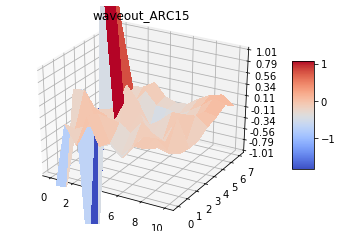

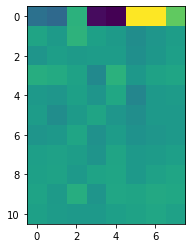

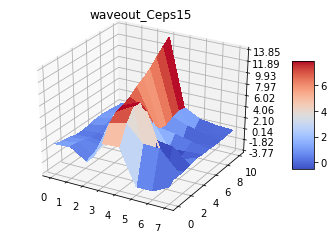

waveout_16 Row: 8, Column: 8


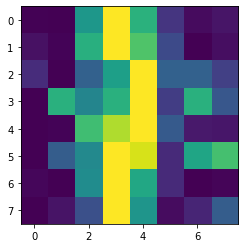

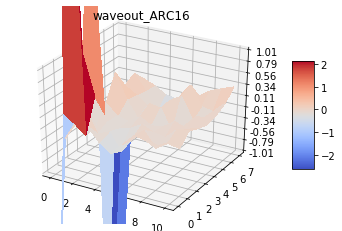

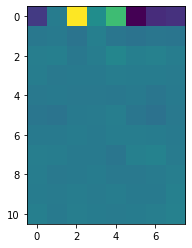

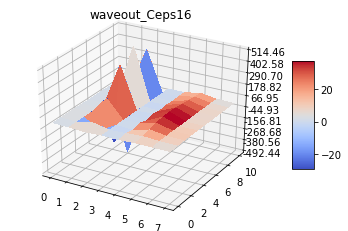

waveout_17 Row: 8, Column: 8


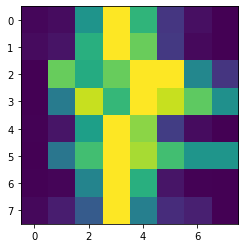

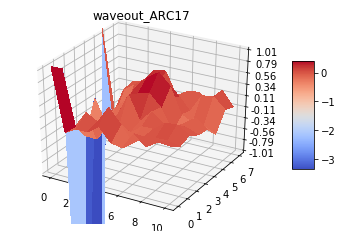

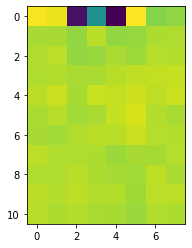

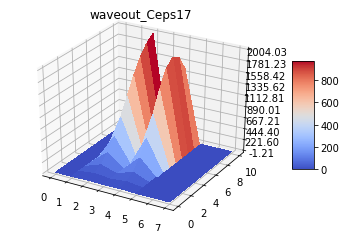

waveout_18 Row: 8, Column: 8


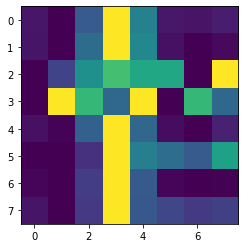

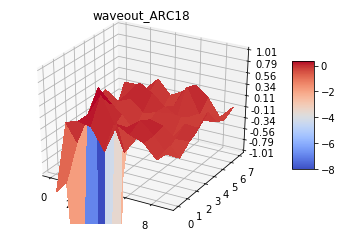

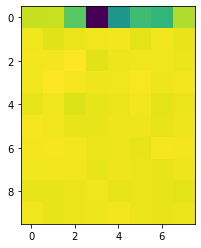

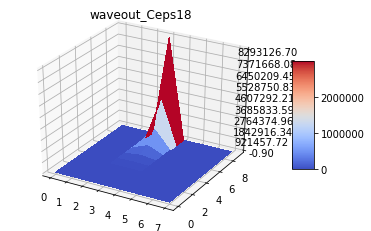

waveout_19 Row: 8, Column: 8


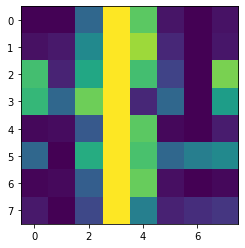

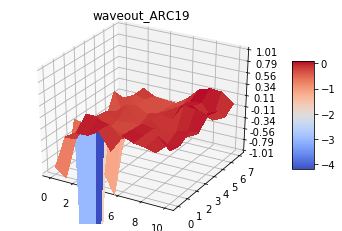

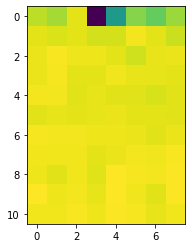

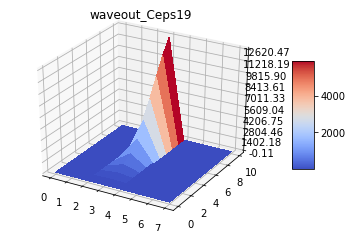

waveout_20 Row: 8, Column: 8


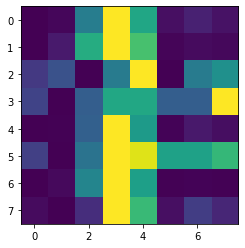

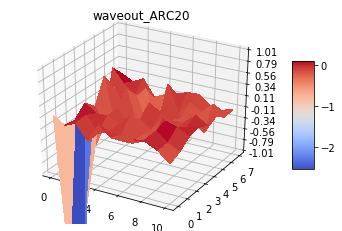

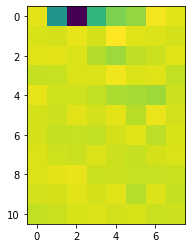

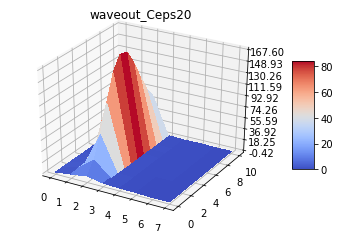

waveout_21 Row: 8, Column: 8


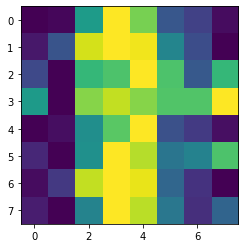

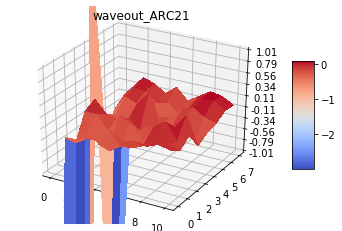

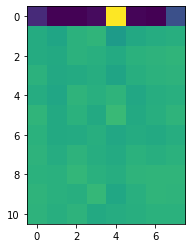

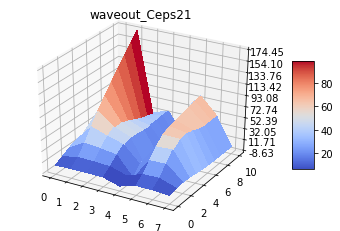

waveout_22 Row: 8, Column: 8


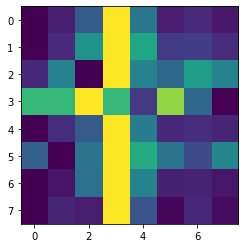

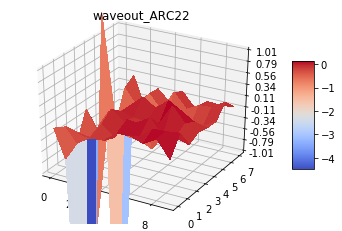

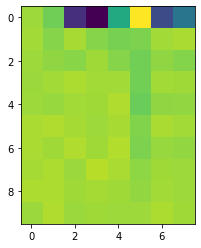

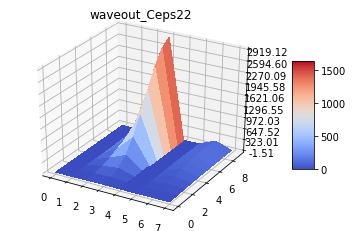

waveout_23 Row: 8, Column: 8


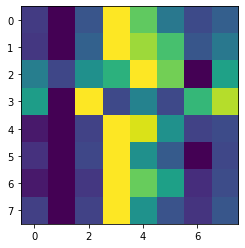

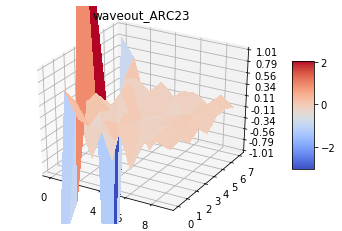

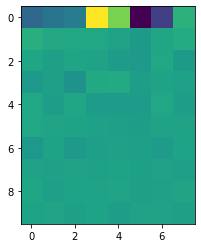

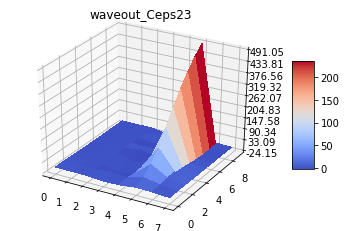

waveout_24 Row: 8, Column: 8


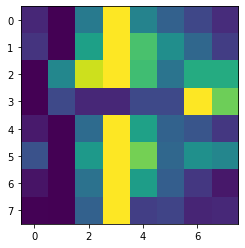

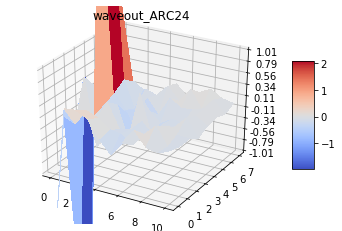

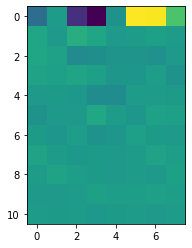

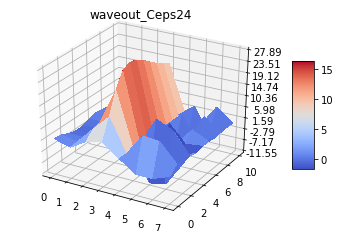

waveout_25 Row: 8, Column: 8


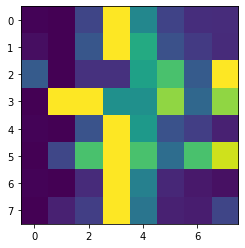

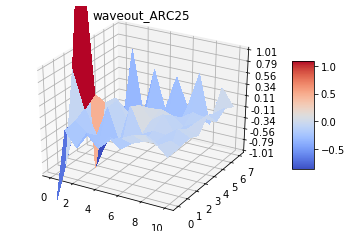

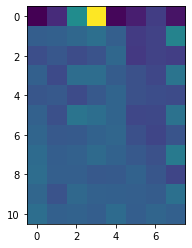

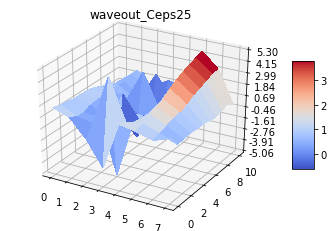

waveout_26 Row: 8, Column: 8


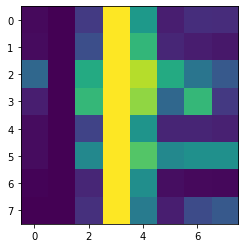

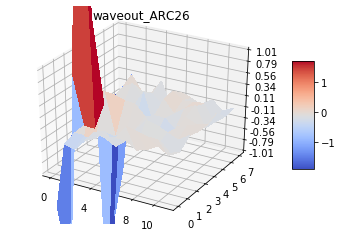

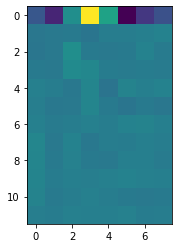

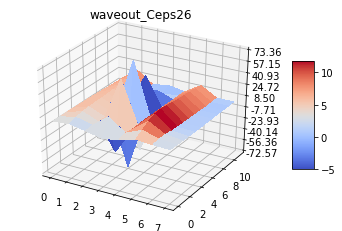

waveout_27 Row: 8, Column: 8


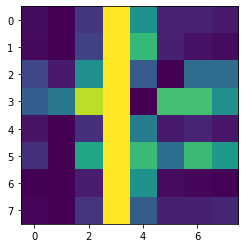

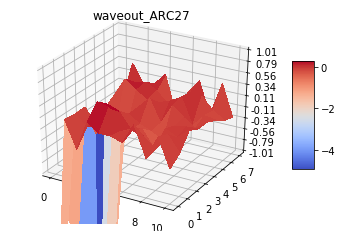

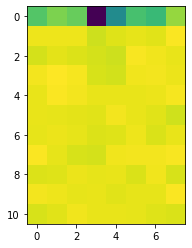

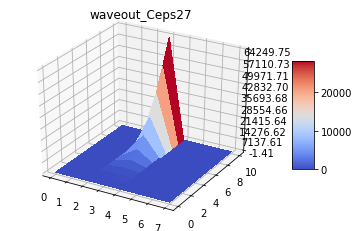

waveout_28 Row: 8, Column: 8


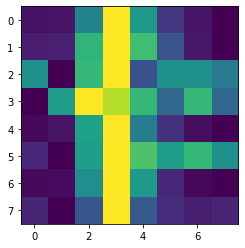

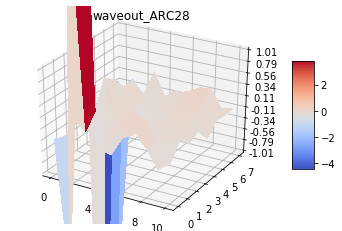

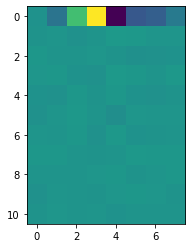

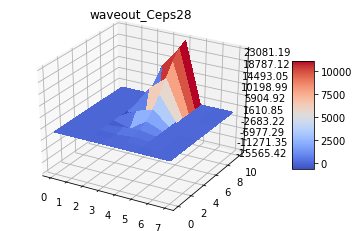

waveout_29 Row: 8, Column: 8


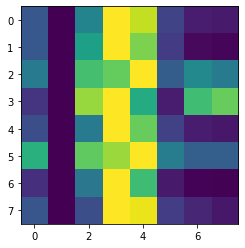

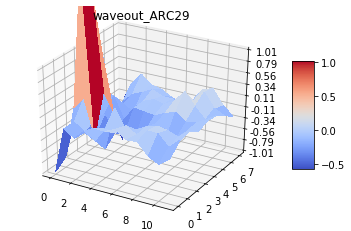

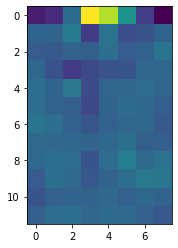

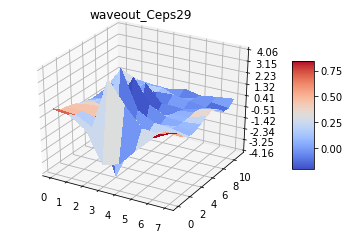

waveout_30 Row: 8, Column: 8


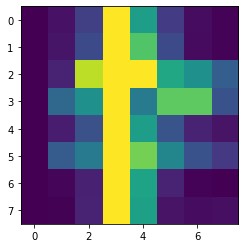

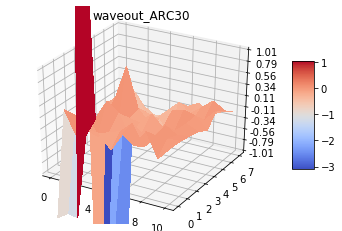

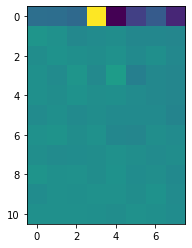

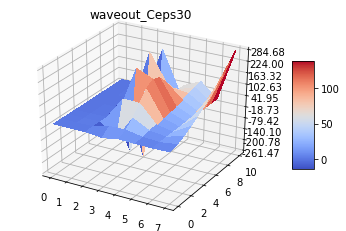

waveout_31 Row: 8, Column: 8


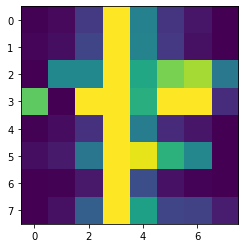

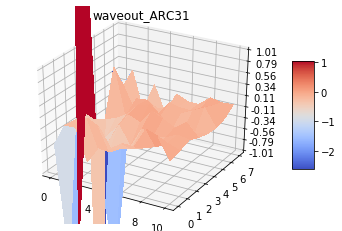

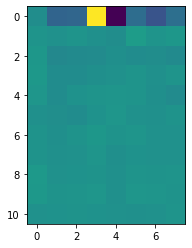

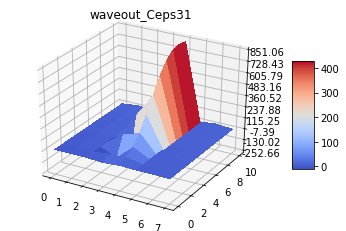

waveout_32 Row: 8, Column: 8


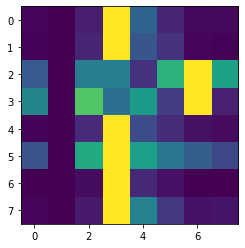

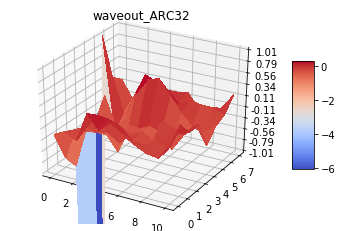

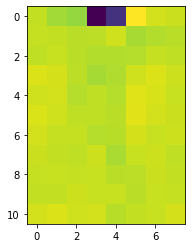

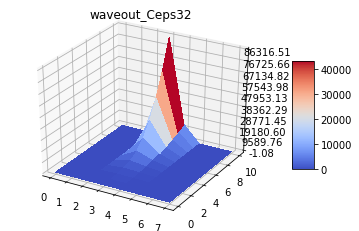

waveout_33 Row: 8, Column: 8


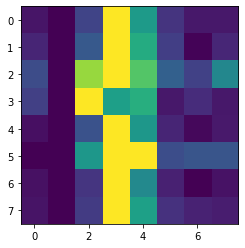

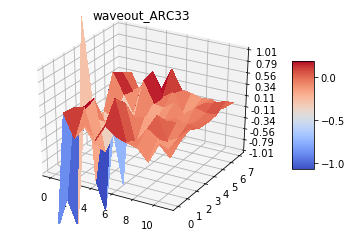

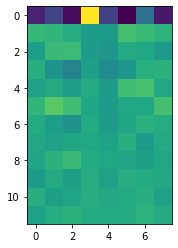

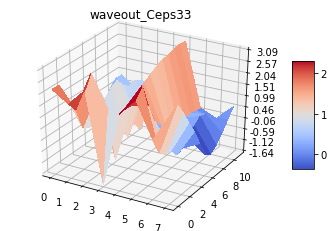

waveout_34 Row: 8, Column: 8


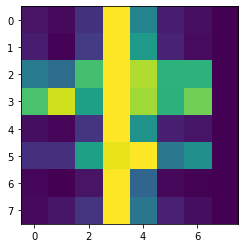

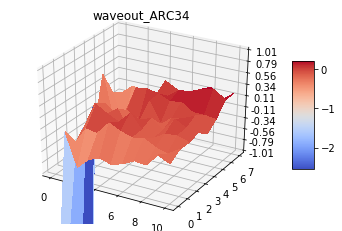

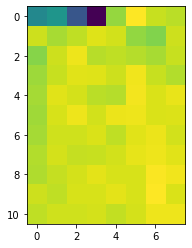

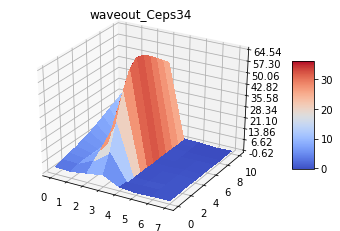

waveout_35 Row: 8, Column: 8


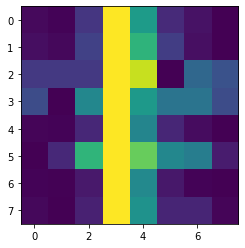

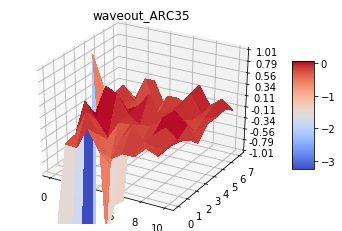

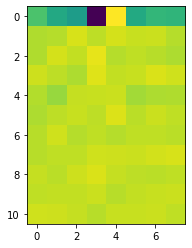

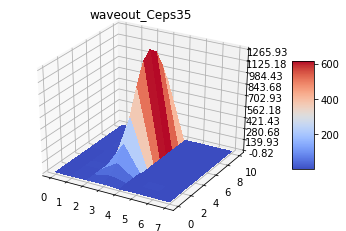

waveout_36 Row: 8, Column: 8


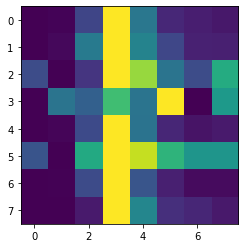

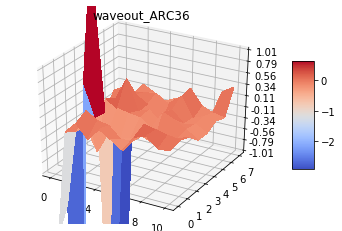

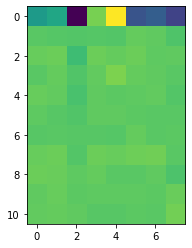

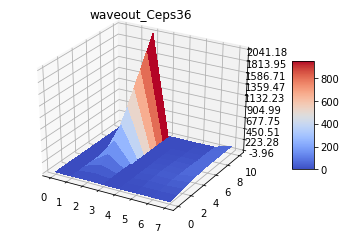

waveout_37 Row: 8, Column: 8


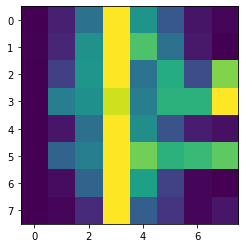

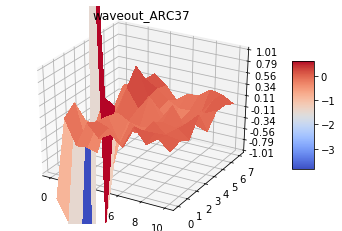

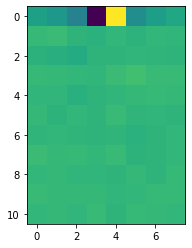

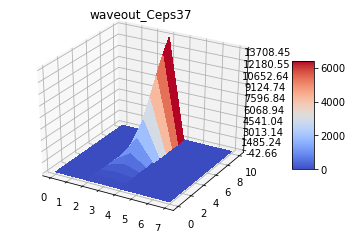

waveout_38 Row: 8, Column: 8


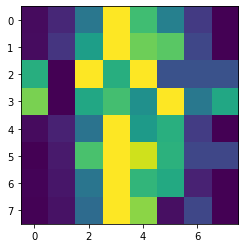

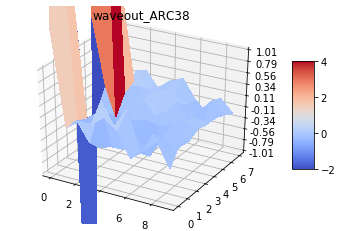

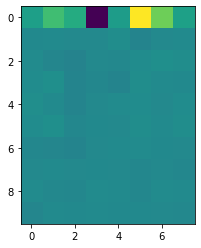

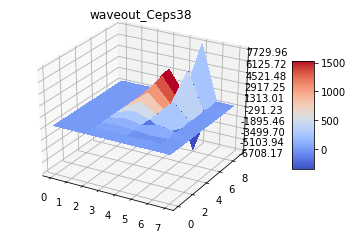

waveout_39 Row: 8, Column: 8


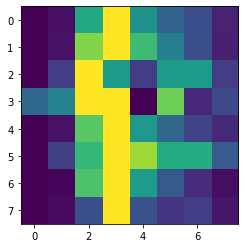

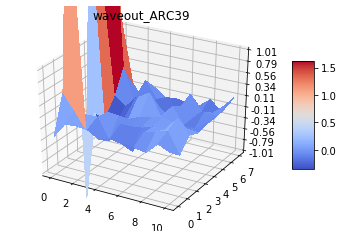

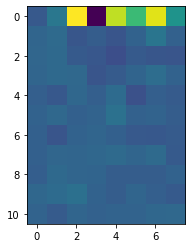

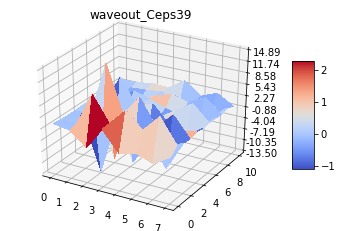

waveout_40 Row: 8, Column: 8


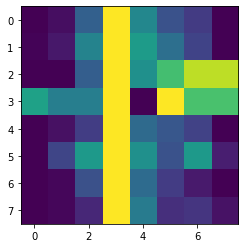

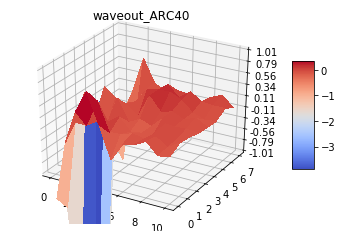

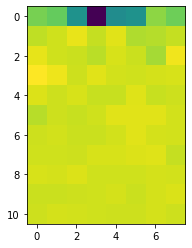

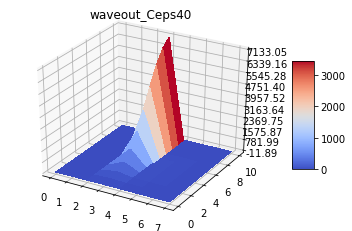

waveout_41 Row: 8, Column: 8


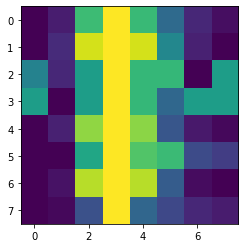

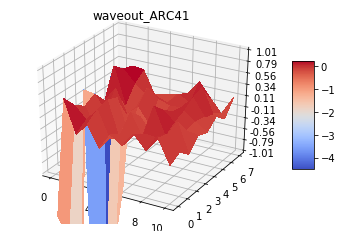

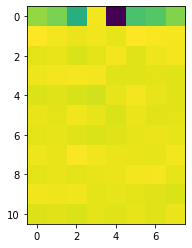

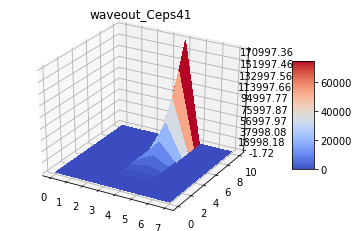

waveout_42 Row: 8, Column: 8


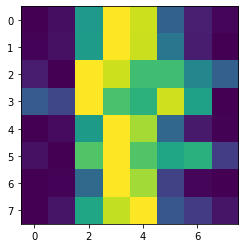

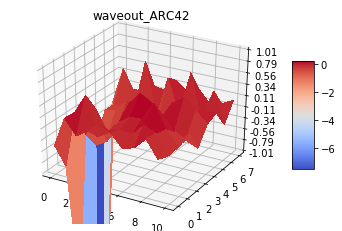

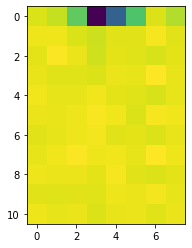

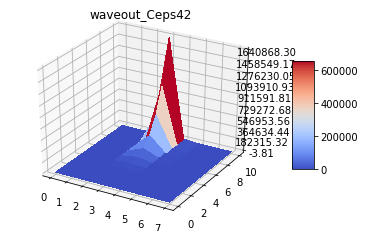

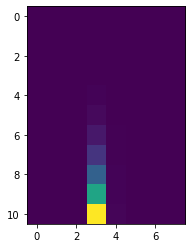

In [31]:
#import matplotlib.pyplot as plt#Step1

number_of_gestures = 6
NumberPerGesture = 42

training_images = []
training_labels = []

import numpy as np
training_ARC_images = np.empty((0,8,8), int)
training_ARC_labels = []

training_Ceps_images = np.empty((0,8,8), int)
training_Ceps_labels = []

for gesture_iter in range(number_of_gestures):
    
    gesture = "gesture"+str(gesture_iter+1)
    gesture = locals()[gesture]

    #fig, ax = plt.subplots()Step2
    
    for i in range(NumberPerGesture):

        import matplotlib.pyplot as plt
        feature_list = []
        ARC_list_inverted = []
        Ceps_list_inverted = []

        number_of_lines = 0
        i_label = i+1
        input_file = TrainingData_PATH+gesture+str(i_label)+txt_format

        feature_list.append(rescaling_max_min(MAV_cal(input_file)))#Line0
        #fig_MAV = list_plot_rescaled_max_min(MAV_cal(input_file),gesture+"MAV"+str(i_label), fig, ax)Step3
        feature_list.append(rescaling_max_min(RMS_cal(input_file)))#Line1
        feature_list.append(rescaling_max_min(ZC_cal(input_file)))#Line2
        feature_list.append(rescaling_max_min(SSC_cal(input_file)))#Line3
        feature_list.append(rescaling_max_min(WL_cal(input_file)))#Line4
        feature_list.append(rescaling_max_min(WA_cal(2.5,input_file)))#Line5
        feature_list.append(rescaling_max_min(VAR_cal(input_file)))#Line6
        feature_list.append(rescaling_max_min(LogD_cal(input_file)))#Line7
        
        training_images.append(feature_list)
        training_labels.append(gesture_iter+1)
        
        import matplotlib.pyplot as plt
        plt.imshow(feature_list)
        #print(feature_list)
        print(gesture+str(i_label)+" Row: %s, Column: %s" % (len(feature_list),len(feature_list[0])))


        LagList,ARC_List = ARC_cal(input_file)
        for item in [[row[i] for row in ARC_List] for i in range(len(ARC_List[0]))]:
            ARC_list_inverted.append(item)#Line8-19
        fig_tmp = ARC_results_plot(LagList, ARC_List, gesture, str(i_label))
        #fig_tmp.savefig(gesture+str(i_label)+"ARC"+".jpg")
        
        training_ARC_images = np.concatenate((training_ARC_images, [rescaled_2D(ARC_list_inverted)[:8]]), axis = 0)
        training_ARC_labels.append(gesture_iter+1)
        plt.imshow(rescaled_2D(ARC_list_inverted))

        
        Ceps_List = Ceps_cal(input_file)
        for item in [[row[i] for row in Ceps_List] for i in range(len(Ceps_List[0]))]:
            Ceps_list_inverted.append(item)#Line20-31
        fig_tmp = Ceps_results_plot(Ceps_list_inverted, gesture, str(i_label))
        #fig_tmp.savefig(gesture+str(i_label)+"Ceps"+".jpg")
        
        training_Ceps_images = np.concatenate((training_Ceps_images, [rescaled_2D(Ceps_list_inverted)[:8]]), axis = 0)
        training_Ceps_labels.append(gesture_iter+1)
        plt.imshow(rescaled_2D(Ceps_list_inverted))

    #plt.show()#Step4
    #fig_MAV.savefig(gesture+"MAV_Rescaled"+".jpg")#Step5#END

#import matplotlib.pyplot as plt#Step1

number_of_gestures = 3
NumberPerGesture = 7

test_images = []
test_labels = []

import numpy as np
test_ARC_images = np.empty((0,10,8), int)
test_ARC_labels = []

test_Ceps_images = np.empty((0,10,8), int)
test_Ceps_labels = []

for gesture_iter in range(number_of_gestures):
    
    gesture = "gesture"+str(gesture_iter+1)
    gesture = locals()[gesture]

    #fig, ax = plt.subplots()Step2
    
    for i in range(NumberPerGesture):

        import matplotlib.pyplot as plt
        feature_list = []
        ARC_list_inverted = []
        Ceps_list_inverted = []

        number_of_lines = 0
        i_label = i+1
        input_file = TestData_PATH+gesture+str(i_label)+txt_format

        feature_list.append(rescaling_max_min(MAV_cal(input_file)))#Line0
        #fig_MAV = list_plot_rescaled_max_min(MAV_cal(input_file),gesture+"MAV"+str(i_label), fig, ax)Step3
        feature_list.append(rescaling_max_min(RMS_cal(input_file)))#Line1
        feature_list.append(rescaling_max_min(ZC_cal(input_file)))#Line2
        feature_list.append(rescaling_max_min(SSC_cal(input_file)))#Line3
        feature_list.append(rescaling_max_min(WL_cal(input_file)))#Line4
        feature_list.append(rescaling_max_min(WA_cal(2.5,input_file)))#Line5
        feature_list.append(rescaling_max_min(VAR_cal(input_file)))#Line6
        feature_list.append(rescaling_max_min(LogD_cal(input_file)))#Line7
        
        test_images.append(feature_list)
        test_labels.append(gesture_iter+1)
        
        import matplotlib.pyplot as plt
        plt.imshow(feature_list)
        #print(feature_list)
        print(gesture+str(i_label)+" Row: %s, Column: %s" % (len(feature_list),len(feature_list[0])))


        LagList,ARC_List = ARC_cal(input_file)
        for item in [[row[i] for row in ARC_List] for i in range(len(ARC_List[0]))]:
            ARC_list_inverted.append(item)#Line8-19
        fig_tmp = ARC_results_plot(LagList, ARC_List, gesture, str(i_label))
        #fig_tmp.savefig(gesture+str(i_label)+"ARC"+".jpg")
        
        test_ARC_images = np.concatenate((test_ARC_images, [rescaled_2D(ARC_list_inverted)[:10]]), axis = 0)
        test_ARC_labels.append(gesture_iter+1)
        plt.imshow(rescaled_2D(ARC_list_inverted))

        
        Ceps_List = Ceps_cal(input_file)
        for item in [[row[i] for row in Ceps_List] for i in range(len(Ceps_List[0]))]:
            Ceps_list_inverted.append(item)#Line20-31
        fig_tmp = Ceps_results_plot(Ceps_list_inverted, gesture, str(i_label))
        #fig_tmp.savefig(gesture+str(i_label)+"Ceps"+".jpg")
        
        test_Ceps_images = np.concatenate((test_Ceps_images, [rescaled_2D(Ceps_list_inverted)[:10]]), axis = 0)
        test_Ceps_labels.append(gesture_iter+1)
        plt.imshow(rescaled_2D(Ceps_list_inverted))

    #plt.show()#Step4
    #fig_MAV.savefig(gesture+"MAV_Rescaled"+".jpg")#Step5#END

In [32]:
import numpy as np

training_images = np.array(training_images)
training_labels = np.array(training_labels)
#test_images = np.array(test_images)
#test_labels = np.array(test_labels)

training_ARC_images = np.array(training_ARC_images)
training_ARC_labels = np.array(training_ARC_labels)
#test_ARC_images = np.array(test_ARC_images)
#test_ARC_labels = np.array(test_ARC_labels)

training_Ceps_images = np.array(training_Ceps_images)
training_Ceps_labels = np.array(training_Ceps_labels)
#test_Ceps_images = np.array(test_Ceps_images)
#test_Ceps_labels = np.array(test_Ceps_labels)

In [33]:
import random
index_ran = [i for i in range(len(training_images))]
random.shuffle(index_ran)

In [34]:
training_images = training_images[index_ran]
training_labels = training_labels[index_ran]
training_ARC_images = training_ARC_images[index_ran]
training_ARC_labels = training_ARC_labels[index_ran]
training_Ceps_images = training_Ceps_images[index_ran]
training_Ceps_labels = training_Ceps_labels[index_ran]

In [35]:
test_number = 24
test_images = training_images[-test_number:]
test_labels = training_labels[-test_number:]
training_images = training_images[:-test_number]
training_labels = training_labels[:-test_number]
test_ARC_images = training_ARC_images[-test_number:]
test_ARC_labels = training_ARC_labels[-test_number:]
training_ARC_images = training_ARC_images[:-test_number]
training_ARC_labels = training_ARC_labels[:-test_number]
test_Ceps_images = training_Ceps_images[-test_number:]
test_Ceps_labels = training_Ceps_labels[-test_number:]
training_Ceps_images = training_Ceps_images[:-test_number]
training_Ceps_labels = training_Ceps_labels[:-test_number]

In [36]:
training_images = np.array(training_images)
training_labels = np.array(training_labels)
test_images = np.array(test_images)
test_labels = np.array(test_labels)

training_ARC_images = np.array(training_ARC_images)
training_ARC_labels = np.array(training_ARC_labels)
test_ARC_images = np.array(test_ARC_images)
test_ARC_labels = np.array(test_ARC_labels)

training_Ceps_images = np.array(training_Ceps_images)
training_Ceps_labels = np.array(training_Ceps_labels)
test_Ceps_images = np.array(test_Ceps_images)
test_Ceps_labels = np.array(test_Ceps_labels)

In [37]:
import tensorflow as tf
from tensorflow import keras

model = keras.Sequential([
    keras.layers.Flatten(input_shape=(8,8)),
    keras.layers.Dense(10240, activation = tf.nn.relu),
    keras.layers.Dense(7, activation = tf.nn.softmax)
])

model.compile(optimizer = tf.train.AdamOptimizer(), loss = 'sparse_categorical_crossentropy', metrics=['accuracy'])

model.fit(training_images, training_labels, epochs = 500)

Epoch 1/500
228/228 [==============================] - 0s 869us/sample - loss: 1.4232 - acc: 0.4430
Epoch 2/500
228/228 [==============================] - 0s 249us/sample - loss: 0.6882 - acc: 0.7675
Epoch 3/500
228/228 [==============================] - 0s 253us/sample - loss: 0.4697 - acc: 0.8377
Epoch 4/500
228/228 [==============================] - 0s 254us/sample - loss: 0.3480 - acc: 0.8904
Epoch 5/500
228/228 [==============================] - 0s 250us/sample - loss: 0.2947 - acc: 0.9123
Epoch 6/500
228/228 [==============================] - 0s 250us/sample - loss: 0.2734 - acc: 0.8640
Epoch 7/500
228/228 [==============================] - 0s 251us/sample - loss: 0.2623 - acc: 0.9035
Epoch 8/500
228/228 [==============================] - 0s 250us/sample - loss: 0.1966 - acc: 0.9430
Epoch 9/500
228/228 [==============================] - 0s 253us/sample - loss: 0.1625 - acc: 0.9561
Epoch 10/500
228/228 [==============================] - 0s 255us/sample - loss: 0.1696 - acc: 0.9298

228/228 [==============================] - 0s 260us/sample - loss: 0.0024 - acc: 1.0000
Epoch 83/500
228/228 [==============================] - 0s 257us/sample - loss: 0.0023 - acc: 1.0000
Epoch 84/500
228/228 [==============================] - 0s 248us/sample - loss: 0.0022 - acc: 1.0000
Epoch 85/500
228/228 [==============================] - 0s 243us/sample - loss: 0.0021 - acc: 1.0000
Epoch 86/500
228/228 [==============================] - 0s 244us/sample - loss: 0.0020 - acc: 1.0000
Epoch 87/500
228/228 [==============================] - 0s 246us/sample - loss: 0.0020 - acc: 1.0000
Epoch 88/500
228/228 [==============================] - 0s 242us/sample - loss: 0.0019 - acc: 1.0000
Epoch 89/500
228/228 [==============================] - 0s 248us/sample - loss: 0.0019 - acc: 1.0000
Epoch 90/500
228/228 [==============================] - 0s 263us/sample - loss: 0.0021 - acc: 1.0000
Epoch 91/500
228/228 [==============================] - 0s 252us/sample - loss: 0.0018 - acc: 1.0000
Epo

228/228 [==============================] - 0s 277us/sample - loss: 5.1259e-04 - acc: 1.0000
Epoch 162/500
228/228 [==============================] - 0s 258us/sample - loss: 5.0061e-04 - acc: 1.0000
Epoch 163/500
228/228 [==============================] - 0s 259us/sample - loss: 4.9198e-04 - acc: 1.0000
Epoch 164/500
228/228 [==============================] - 0s 273us/sample - loss: 4.8543e-04 - acc: 1.0000
Epoch 165/500
228/228 [==============================] - 0s 268us/sample - loss: 4.6681e-04 - acc: 1.0000
Epoch 166/500
228/228 [==============================] - 0s 266us/sample - loss: 4.7499e-04 - acc: 1.0000
Epoch 167/500
228/228 [==============================] - 0s 267us/sample - loss: 4.5973e-04 - acc: 1.0000
Epoch 168/500
228/228 [==============================] - 0s 266us/sample - loss: 4.5233e-04 - acc: 1.0000
Epoch 169/500
228/228 [==============================] - 0s 264us/sample - loss: 4.6907e-04 - acc: 1.0000
Epoch 170/500
228/228 [==============================] - 0s 

228/228 [==============================] - 0s 257us/sample - loss: 1.8730e-04 - acc: 1.0000
Epoch 239/500
228/228 [==============================] - 0s 263us/sample - loss: 1.8336e-04 - acc: 1.0000
Epoch 240/500
228/228 [==============================] - 0s 262us/sample - loss: 1.8190e-04 - acc: 1.0000
Epoch 241/500
228/228 [==============================] - 0s 259us/sample - loss: 1.8021e-04 - acc: 1.0000
Epoch 242/500
228/228 [==============================] - 0s 257us/sample - loss: 1.7841e-04 - acc: 1.0000
Epoch 243/500
228/228 [==============================] - 0s 245us/sample - loss: 1.7711e-04 - acc: 1.0000
Epoch 244/500
228/228 [==============================] - 0s 248us/sample - loss: 1.7748e-04 - acc: 1.0000
Epoch 245/500
228/228 [==============================] - 0s 255us/sample - loss: 1.7424e-04 - acc: 1.0000
Epoch 246/500
228/228 [==============================] - 0s 252us/sample - loss: 1.7218e-04 - acc: 1.0000
Epoch 247/500
228/228 [==============================] - 0s 

228/228 [==============================] - 0s 263us/sample - loss: 9.1894e-05 - acc: 1.0000
Epoch 316/500
228/228 [==============================] - 0s 262us/sample - loss: 9.0923e-05 - acc: 1.0000
Epoch 317/500
228/228 [==============================] - 0s 263us/sample - loss: 8.9942e-05 - acc: 1.0000
Epoch 318/500
228/228 [==============================] - 0s 266us/sample - loss: 8.9499e-05 - acc: 1.0000
Epoch 319/500
228/228 [==============================] - 0s 257us/sample - loss: 8.8388e-05 - acc: 1.0000
Epoch 320/500
228/228 [==============================] - 0s 271us/sample - loss: 8.8046e-05 - acc: 1.0000
Epoch 321/500
228/228 [==============================] - 0s 263us/sample - loss: 8.8658e-05 - acc: 1.0000
Epoch 322/500
228/228 [==============================] - 0s 260us/sample - loss: 9.0339e-05 - acc: 1.0000
Epoch 323/500
228/228 [==============================] - 0s 265us/sample - loss: 8.7122e-05 - acc: 1.0000
Epoch 324/500
228/228 [==============================] - 0s 

228/228 [==============================] - 0s 265us/sample - loss: 4.9730e-05 - acc: 1.0000
Epoch 393/500
228/228 [==============================] - 0s 260us/sample - loss: 4.9995e-05 - acc: 1.0000
Epoch 394/500
228/228 [==============================] - 0s 259us/sample - loss: 4.9475e-05 - acc: 1.0000
Epoch 395/500
228/228 [==============================] - 0s 260us/sample - loss: 4.9055e-05 - acc: 1.0000
Epoch 396/500
228/228 [==============================] - 0s 264us/sample - loss: 4.8650e-05 - acc: 1.0000
Epoch 397/500
228/228 [==============================] - 0s 258us/sample - loss: 4.7919e-05 - acc: 1.0000
Epoch 398/500
228/228 [==============================] - 0s 261us/sample - loss: 4.7939e-05 - acc: 1.0000
Epoch 399/500
228/228 [==============================] - 0s 262us/sample - loss: 4.7598e-05 - acc: 1.0000
Epoch 400/500
228/228 [==============================] - 0s 257us/sample - loss: 4.7079e-05 - acc: 1.0000
Epoch 401/500
228/228 [==============================] - 0s 

228/228 [==============================] - 0s 258us/sample - loss: 2.9474e-05 - acc: 1.0000
Epoch 470/500
228/228 [==============================] - 0s 261us/sample - loss: 2.9559e-05 - acc: 1.0000
Epoch 471/500
228/228 [==============================] - 0s 263us/sample - loss: 2.9200e-05 - acc: 1.0000
Epoch 472/500
228/228 [==============================] - 0s 259us/sample - loss: 2.8882e-05 - acc: 1.0000
Epoch 473/500
228/228 [==============================] - 0s 261us/sample - loss: 2.8328e-05 - acc: 1.0000
Epoch 474/500
228/228 [==============================] - 0s 255us/sample - loss: 2.8122e-05 - acc: 1.0000
Epoch 475/500
228/228 [==============================] - 0s 263us/sample - loss: 2.7856e-05 - acc: 1.0000
Epoch 476/500
228/228 [==============================] - 0s 267us/sample - loss: 2.7688e-05 - acc: 1.0000
Epoch 477/500
228/228 [==============================] - 0s 271us/sample - loss: 2.7477e-05 - acc: 1.0000
Epoch 478/500
228/228 [==============================] - 0s 

In [38]:
print(model.evaluate(test_images, test_labels))

24/24 [==============================] - 0s 3ms/sample - loss: 0.0432 - acc: 0.9583


[0.043238889425992966, 0.9583333]

ARC&Ceps Methods below: not good

import tensorflow as tf
from tensorflow import keras

model = keras.Sequential([
    keras.layers.Flatten(input_shape=(8,8)),
    keras.layers.Dense(10240, activation = tf.nn.relu),
    keras.layers.Dense(7, activation = tf.nn.softmax)
])

model.compile(optimizer = tf.train.AdamOptimizer(), loss = 'sparse_categorical_crossentropy', metrics=['accuracy'])

model.fit(training_ARC_images, training_ARC_labels, epochs = 500)

model.evaluate(test_ARC_images, test_ARC_labels)

import tensorflow as tf
from tensorflow import keras

model = keras.Sequential([
    keras.layers.Flatten(input_shape=(8,8)),
    keras.layers.Dense(10240, activation = tf.nn.relu),
    keras.layers.Dense(7, activation = tf.nn.softmax)
])

model.compile(optimizer = tf.train.AdamOptimizer(), loss = 'sparse_categorical_crossentropy', metrics=['accuracy'])

model.fit(training_Ceps_images, training_Ceps_labels, epochs = 500)

model.evaluate(test_Ceps_images, test_Ceps_labels)